### Checking GPU and resources 

In [1]:
import tensorflow as tf
print(tf.test.is_built_with_cuda())


True


In [2]:
!nvidia-smi


Wed Jul 31 08:42:56 2024       
+-----------------------------------------------------------------------------------------+
| NVIDIA-SMI 550.54.14              Driver Version: 550.54.14      CUDA Version: 12.4     |
|-----------------------------------------+------------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id          Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |           Memory-Usage | GPU-Util  Compute M. |
|                                         |                        |               MIG M. |
|=========================================+========================+======================|
|   0  Tesla V100-SXM2-16GB           Off |   00000000:00:1B.0 Off |                    0 |
| N/A   45C    P0             56W /  300W |       0MiB /  16384MiB |      0%      Default |
|                                         |                        |                  N/A |
+-----------------------------------------+-----

In [3]:
import sys
print(sys.executable)


/home/ec2-user/anaconda3/bin/python


In [4]:
import tensorflow as tf
print(tf.test.is_built_with_cuda())


True


In [5]:
! echo 0 | sudo tee -a /sys/bus/pci/devices/0000:00:1e.0/numa_node

0


In [6]:
import tensorflow as tf
print(tf.config.list_physical_devices('GPU'))


[PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU'), PhysicalDevice(name='/physical_device:GPU:1', device_type='GPU'), PhysicalDevice(name='/physical_device:GPU:2', device_type='GPU'), PhysicalDevice(name='/physical_device:GPU:3', device_type='GPU')]


### Imports

In [7]:
import os
import re
import h5py
import gc
import pydicom
import shutil
import csv
import pywt
import nibabel as nib
import numpy as np
import time
import matplotlib.pyplot as plt
import random
import glob
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import cv2
import keras_tuner as kt
import csv
from tensorflow.keras.callbacks import Callback
from keras_tuner.tuners import RandomSearch
#import splitfolders  
import tensorflow as tf
from sklearn.utils.class_weight import compute_class_weight
from tensorflow.keras import layers, models
from sklearn.utils import class_weight
from scipy.ndimage import zoom
from skimage import measure
from tensorflow.keras.models import load_model
from sklearn.model_selection import StratifiedShuffleSplit
from skfuzzy import cmeans
from tensorflow.keras.utils import Sequence
from sklearn.preprocessing import LabelEncoder
from concurrent.futures import ThreadPoolExecutor
from sklearn.metrics import confusion_matrix, classification_report
from collections import Counter
from tensorflow.keras.preprocessing.image import img_to_array, load_img
from skimage.transform import resize
from sklearn.utils import shuffle
from sklearn.model_selection import StratifiedKFold
from tensorflow.keras.utils import to_categorical
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix
from sklearn.preprocessing import MinMaxScaler
from tensorflow.keras.utils import to_categorical
from keras_tuner import HyperParameters
from keras.layers import LeakyReLU
from sklearn.model_selection import train_test_split
from tensorflow.keras.models import Sequential,Model
from tensorflow.keras.layers import Input,Conv3D, MaxPooling3D, Flatten, Dense, Dropout,BatchNormalization,Activation,concatenate,Conv3DTranspose,GlobalAveragePooling3D,Reshape,Softmax, Dense, GlobalAveragePooling2D, Input, Conv2D, MaxPooling2D, AveragePooling2D, Dense, Conv2DTranspose,Flatten, Concatenate, UpSampling2D,UpSampling3D
from tensorflow.keras.optimizers import Adam, SGD,RMSprop
from scipy.ndimage import zoom,sobel
from skimage.filters import laplace, gabor as skimage_gabor
from scipy.ndimage import median_filter
from skimage.restoration import denoise_bilateral
from tensorflow.keras import backend as K
from keras_tuner import RandomSearch
from skimage.transform import resize
from tensorflow.keras.applications.inception_v3 import InceptionV3
from tensorflow.keras.applications import VGG16, ResNet50,VGG19
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.applications import MobileNetV3Large
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam
from sklearn.model_selection import train_test_split


In [8]:
dataset_dir = '/home/ec2-user/teza-folder/lungs-cancer'
filepaths = []
labels = []

folds = os.listdir(dataset_dir)
for fold in folds:
    foldpath = os.path.join(dataset_dir, fold)
    if os.path.isdir(foldpath):  
        filelist = os.listdir(foldpath)
        filelist = [file for file in filelist if not file.startswith("._")]
        for file in filelist:
            fpath = os.path.join(foldpath, file)
            filepaths.append(fpath)
            labels.append(fold)

FSeries = pd.Series(filepaths, name= 'filepaths')
LSeries = pd.Series(labels, name='labels')


df = pd.concat([FSeries, LSeries], axis=1)



In [9]:
dataset_dir_tl = '/home/ec2-user/teza-folder/transfer_learning /train'
filepaths1 = []
labels1 = []

folds1 = os.listdir(dataset_dir_tl)
for fold1 in folds1:
    foldpath1 = os.path.join(dataset_dir_tl, fold1)
    if os.path.isdir(foldpath1): 
        filelist1 = os.listdir(foldpath1)
        filelist1 = [file for file in filelist1 if not file.startswith("._")]  
        for file1 in filelist1:
            fpath1 = os.path.join(foldpath1, file1)
            filepaths1.append(fpath1)
            labels1.append(fold1)

FSeries = pd.Series(filepaths1, name= 'filepaths')
LSeries = pd.Series(labels1, name='labels')


df_tl = pd.concat([FSeries, LSeries], axis=1)


In [10]:
train_df, dummy_df = train_test_split(df, train_size=0.7, random_state=42, stratify=df['labels'])

val_df, test_df = train_test_split(dummy_df, train_size=0.5, random_state=42, stratify=dummy_df['labels'])

In [11]:
train_df_tl, dummy_df_tl = train_test_split(df_tl, train_size=0.7, random_state=42, stratify=df_tl['labels'])

val_df_tl, test_df_tl = train_test_split(dummy_df_tl, train_size=0.5, random_state=42, stratify=dummy_df_tl['labels'])

In [12]:
display(train_df_tl)
display(val_df_tl)

,filepaths,labels
979,/home/ec2-user/teza-folder/transfer_learning /...,healthy
973,/home/ec2-user/teza-folder/transfer_learning /...,healthy
72,/home/ec2-user/teza-folder/transfer_learning /...,cancer
36,/home/ec2-user/teza-folder/transfer_learning /...,cancer
677,/home/ec2-user/teza-folder/transfer_learning /...,cancer
...,...,...
923,/home/ec2-user/teza-folder/transfer_learning /...,healthy
972,/home/ec2-user/teza-folder/transfer_learning /...,healthy
699,/home/ec2-user/teza-folder/transfer_learning /...,healthy
342,/home/ec2-user/teza-folder/transfer_learning /...,cancer


,filepaths,labels
474,/home/ec2-user/teza-folder/transfer_learning /...,cancer
202,/home/ec2-user/teza-folder/transfer_learning /...,cancer
269,/home/ec2-user/teza-folder/transfer_learning /...,cancer
783,/home/ec2-user/teza-folder/transfer_learning /...,healthy
620,/home/ec2-user/teza-folder/transfer_learning /...,cancer
...,...,...
1032,/home/ec2-user/teza-folder/transfer_learning /...,healthy
562,/home/ec2-user/teza-folder/transfer_learning /...,cancer
389,/home/ec2-user/teza-folder/transfer_learning /...,cancer
939,/home/ec2-user/teza-folder/transfer_learning /...,healthy


In [13]:
display(train_df)
display(val_df)

,filepaths,labels
1047,/home/ec2-user/teza-folder/lungs-cancer/bening...,beningn
157,/home/ec2-user/teza-folder/lungs-cancer/malign...,malignant
963,/home/ec2-user/teza-folder/lungs-cancer/normal...,normal
770,/home/ec2-user/teza-folder/lungs-cancer/normal...,normal
299,/home/ec2-user/teza-folder/lungs-cancer/malign...,malignant
...,...,...
875,/home/ec2-user/teza-folder/lungs-cancer/normal...,normal
55,/home/ec2-user/teza-folder/lungs-cancer/malign...,malignant
593,/home/ec2-user/teza-folder/lungs-cancer/normal...,normal
481,/home/ec2-user/teza-folder/lungs-cancer/malign...,malignant


,filepaths,labels
232,/home/ec2-user/teza-folder/lungs-cancer/malign...,malignant
660,/home/ec2-user/teza-folder/lungs-cancer/normal...,normal
797,/home/ec2-user/teza-folder/lungs-cancer/normal...,normal
1060,/home/ec2-user/teza-folder/lungs-cancer/bening...,beningn
712,/home/ec2-user/teza-folder/lungs-cancer/normal...,normal
...,...,...
1049,/home/ec2-user/teza-folder/lungs-cancer/bening...,beningn
478,/home/ec2-user/teza-folder/lungs-cancer/malign...,malignant
258,/home/ec2-user/teza-folder/lungs-cancer/malign...,malignant
1098,/home/ec2-user/teza-folder/lungs-cancer/bening...,beningn


In [14]:

batch_size = 2
image_size = (224, 224)

gen = ImageDataGenerator()

train_gen = gen.flow_from_dataframe(train_df,
    x_col='filepaths',
    y_col='labels',
    target_size=(224, 224),
    color_mode='rgb',
    classes=None,  
    class_mode='categorical',
    batch_size=batch_size,
    shuffle=True                              
   )
val_gen = gen.flow_from_dataframe(val_df, x_col='filepaths', y_col='labels', class_mode='categorical',
                                   color_mode = 'rgb', classes=None,target_size=(224,224), batch_size=batch_size)

test_gen = gen.flow_from_dataframe(test_df, x_col='filepaths', y_col='labels', class_mode='categorical',
                                   color_mode = 'rgb', classes=None,target_size=(224,224), batch_size=batch_size)

Found 768 validated image filenames belonging to 3 classes.
Found 164 validated image filenames belonging to 3 classes.
Found 165 validated image filenames belonging to 3 classes.


/home/ec2-user/anaconda3/lib/python3.11/site-packages/keras/src/legacy/preprocessing/image.py:920: UserWarning: Found 1 invalid image filename(s) in x_col="filepaths". These filename(s) will be ignored.
  warnings.warn(
/home/ec2-user/anaconda3/lib/python3.11/site-packages/keras/src/legacy/preprocessing/image.py:920: UserWarning: Found 1 invalid image filename(s) in x_col="filepaths". These filename(s) will be ignored.
  warnings.warn(


In [15]:
train_gen_tl = gen.flow_from_dataframe(train_df_tl,
    x_col='filepaths',
    y_col='labels',
    target_size=(224, 224),
    color_mode='rgb',
    classes=None,  
    class_mode='binary',
    batch_size=batch_size,
    shuffle=True                              
   )
val_gen_tl = gen.flow_from_dataframe(val_df_tl, x_col='filepaths', y_col='labels', class_mode='binary',
                                   color_mode = 'rgb', classes=None,target_size=(224,224), batch_size=batch_size)

test_gen_tl = gen.flow_from_dataframe(test_df_tl, x_col='filepaths', y_col='labels', class_mode='binary',
                                   color_mode = 'rgb', classes=None,target_size=(224,224), batch_size=batch_size)

Found 767 validated image filenames belonging to 2 classes.
Found 165 validated image filenames belonging to 2 classes.
Found 165 validated image filenames belonging to 2 classes.


In [16]:
# def create_split_folders(base_dir, output_dir, train_ratio=0.7, val_ratio=0.15, test_ratio=0.15):
#     classes = ['beningn', 'malignant', 'normal']
    
#     for split in ['train', 'val', 'test']:
#         for cls in classes:
#             os.makedirs(os.path.join(output_dir, split, cls), exist_ok=True)
    
#     for cls in classes:
#         class_dir = os.path.join(base_dir, cls)
#         images = [f for f in os.listdir(class_dir) if os.path.isfile(os.path.join(class_dir, f))]
        
#         if len(images) == 0:
#             print(f"No images found in directory {class_dir}, skipping...")
#             continue
        
#         print(f"Splitting {len(images)} images for class '{cls}'")
        
#         labels = [cls] * len(images)
#         sss = StratifiedShuffleSplit(n_splits=1, test_size=(val_ratio + test_ratio), random_state=42)
#         train_idx, temp_idx = next(sss.split(images, labels))
        
#         temp_images = [images[i] for i in temp_idx]
#         temp_labels = [labels[i] for i in temp_idx]
        
#         sss_temp = StratifiedShuffleSplit(n_splits=1, test_size=test_ratio / (val_ratio + test_ratio), random_state=42)
#         val_idx, test_idx = next(sss_temp.split(temp_images, temp_labels))
        
#         train_images = [images[i] for i in train_idx]
#         val_images = [temp_images[i] for i in val_idx]
#         test_images = [temp_images[i] for i in test_idx]
        
#         split_data = {'train': train_images, 'val': val_images, 'test': test_images}
        
#         for split, split_images in split_data.items():
#             for img in split_images:
#                 src = os.path.join(class_dir, img)
#                 dst = os.path.join(output_dir, split, cls, img)
#                 shutil.copy(src, dst)



# base_dir = '/home/ec2-user/teza-folder/lungs-cancer'
# output_dir='/home/ec2-user/teza-folder/lungs-cancer/split'
# create_split_folders(base_dir,output_dir)


In [17]:
# batch_size = 2
# image_size = (224, 224)

# gen = ImageDataGenerator(rescale=1./255.)
# train_dir = '/home/ec2-user/teza-folder/lungs-cancer/split/train'
# val_dir = '/home/ec2-user/teza-folder/lungs-cancer/split/val'
# test_dir = '/home/ec2-user/teza-folder/lungs-cancer/split/test'

# train_gen = gen.flow_from_directory(
#     train_dir,
#     target_size=(224, 224),
#     batch_size=batch_size,
#     class_mode='sparse'
# )

# val_gen = gen.flow_from_directory(
#     val_dir,
#     target_size=(224, 224),
#     batch_size=batch_size,
#     class_mode='sparse'
# )

# test_gen = gen.flow_from_directory(
#     test_dir,
#     target_size=(224, 224),
#     batch_size=batch_size,
#     class_mode='sparse'
# )

### MobileNet

In [18]:
! echo 0 | sudo tee -a /sys/bus/pci/devices/0000:00:1e.0/numa_node

0


In [19]:
def create_mri_model(num_classes=3):
    mobilenetv3_large = MobileNetV3Large(weights="imagenet", include_top=False, input_shape=(224, 224,3))
    x = mobilenetv3_large.output
    x = GlobalAveragePooling2D()(x)
    x = Dense(512, activation='relu')(x)
    x = Dense(1024, activation='relu')(x)
    x = Dropout(0.3)(x) 
    output = Dense(num_classes, activation="softmax", name="output")(x)
    model = Model(inputs=mobilenetv3_large.input, outputs=output)
    
    optimizer = Adam(learning_rate=0.0001)
    model.compile(optimizer=optimizer, loss='categorical_crossentropy', metrics=['accuracy'])
    
    return model


In [20]:

model = create_mri_model(num_classes=3)
#model.summary()


In [21]:
history = model.fit(
    train_gen,
    #steps_per_epoch=len(df_train)//batch_size,
    validation_data=val_gen,
    #validation_steps=len(df_val)//batch_size,
    epochs=50,
    #class_weight = train_class_weights
)

Epoch 1/50
289/384 ━━━━━━━━━━━━━━━━━━━━ 8s 88ms/step - accuracy: 0.6913 - loss: 0.7459

I0000 00:00:1720341428.165381    9727 asm_compiler.cc:369] ptxas warning : Registers are spilled to local memory in function 'loop_add_subtract_fusion_10', 272 bytes spill stores, 272 bytes spill loads



382/384 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step - accuracy: 0.7086 - loss: 0.7078

/home/ec2-user/anaconda3/lib/python3.11/site-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


384/384 ━━━━━━━━━━━━━━━━━━━━ 79s 89ms/step - accuracy: 0.7091 - loss: 0.7067 - val_accuracy: 0.8727 - val_loss: 0.3619
Epoch 2/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 7s 17ms/step - accuracy: 0.8608 - loss: 0.3160 - val_accuracy: 0.8727 - val_loss: 0.3407
Epoch 3/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 7s 17ms/step - accuracy: 0.9505 - loss: 0.1391 - val_accuracy: 0.8424 - val_loss: 0.4276
Epoch 4/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 7s 18ms/step - accuracy: 0.9580 - loss: 0.1335 - val_accuracy: 0.8606 - val_loss: 0.3669
Epoch 5/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 7s 18ms/step - accuracy: 0.9765 - loss: 0.0816 - val_accuracy: 0.8545 - val_loss: 0.5250
Epoch 6/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 7s 17ms/step - accuracy: 0.9820 - loss: 0.0893 - val_accuracy: 0.7333 - val_loss: 0.8051
Epoch 7/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 7s 18ms/step - accuracy: 0.9796 - loss: 0.0785 - val_accuracy: 0.8424 - val_loss: 0.4264
Epoch 8/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 7s 18ms/step - accuracy: 0.9838 - loss: 0.0247 - val_accuracy: 0.85

In [22]:
test_loss, test_accuracy = model.evaluate(test_gen)


 9/83 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - accuracy: 1.0000 - loss: 3.7053e-07

/home/ec2-user/anaconda3/lib/python3.11/site-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


83/83 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - accuracy: 0.9895 - loss: 0.0494


In [23]:
def evaluate_model(model, test_gen, label_mapping):
    y_true = []
    y_pred = []
    test_gen.reset()  
    for _ in range(len(test_gen)):
        batch_x, batch_y = next(test_gen)
        preds = model.predict(batch_x)
        y_true.extend(np.argmax(batch_y, axis=1))
        y_pred.extend(np.argmax(preds, axis=1))
    y_true = y_true[:len(y_pred)]
    classes = list(label_mapping.keys())
    conf_matrix = confusion_matrix(y_true, y_pred, labels=list(label_mapping.values()))
    plt.figure(figsize=(8, 6))
    sns.heatmap(conf_matrix, annot=True, fmt="d", cmap="Blues", xticklabels=classes, yticklabels=classes)
    plt.xlabel('Predicted')
    plt.ylabel('True')
    plt.title('Confusion Matrix')
    plt.show()

    report = classification_report(y_true, y_pred)
    #report_df = pd.DataFrame(report).transpose()
    #report_df = report_df.round(2)
    print(report)

    return y_true, y_pred, classes


In [24]:
def accuracy_per_class(cm):
    accuracies = {}
    for i, class_name in enumerate(['Benign', 'Malignant', 'Normal']):
        correct_predictions = cm[i, i]
        total_instances = np.sum(cm[i, :])
        accuracies[class_name] = correct_predictions / total_instances if total_instances != 0 else 0
    return accuracies


In [25]:
def visualize_predictions(test_gen, y_true, y_pred, classes):
    test_gen.reset() 
    images = []
    
    for batch_x, _ in test_gen:
        images.extend(batch_x)

    images = images[:len(y_true)]
    
    plt.figure(figsize=(20, 20))
    for i in range(25): 
        plt.subplot(5, 5, i + 1)
        plt.imshow(images[i].astype("uint8"))
        actual_label = classes[y_true[i]]
        predicted_label = classes[y_pred[i]]
        plt.title(f"Actual: {actual_label}\nPredicted: {predicted_label}")
        plt.axis('off')
    plt.tight_layout()
    plt.show()


In [26]:
label_mapping = {'benign': 0, 'malignant': 1, 'normal': 2}

1/1 ━━━━━━━━━━━━━━━━━━━━ 4s 4s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━

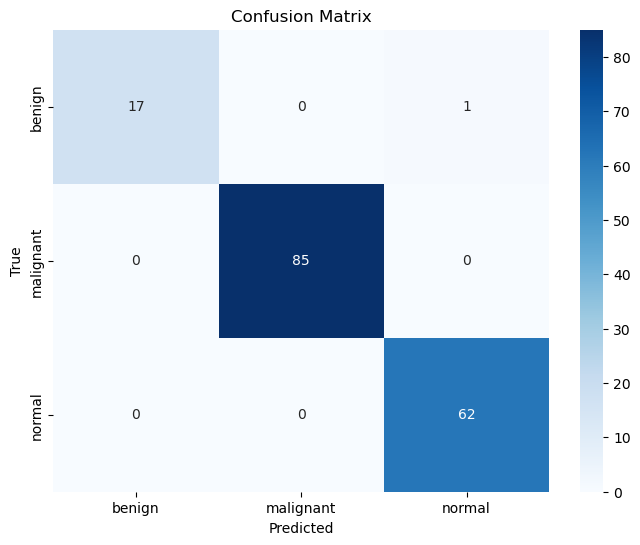

              precision    recall  f1-score   support

           0       1.00      0.94      0.97        18
           1       1.00      1.00      1.00        85
           2       0.98      1.00      0.99        62

    accuracy                           0.99       165
   macro avg       0.99      0.98      0.99       165
weighted avg       0.99      0.99      0.99       165



In [27]:
y_true, y_pred, classes = evaluate_model(model, test_gen, label_mapping)

In [28]:
cm = confusion_matrix(y_true, y_pred, labels=list(label_mapping.values()))
class_accuracies = accuracy_per_class(cm)
print("Accuracy per class:")
for class_name, accuracy in class_accuracies.items():
    print(f"{class_name}: {accuracy:.2f}")


Accuracy per class:
Benign: 0.94
Malignant: 1.00
Normal: 1.00


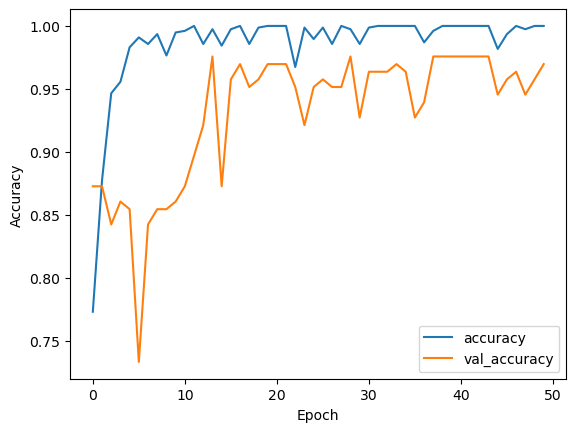

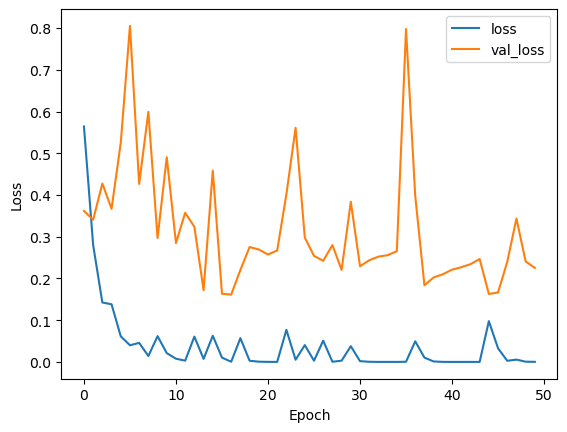

In [29]:
plt.plot(history.history['accuracy'], label='accuracy')
plt.plot(history.history['val_accuracy'], label='val_accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend(loc='lower right')
plt.show()

plt.plot(history.history['loss'], label='loss')
plt.plot(history.history['val_loss'], label='val_loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend(loc='upper right')
plt.show()

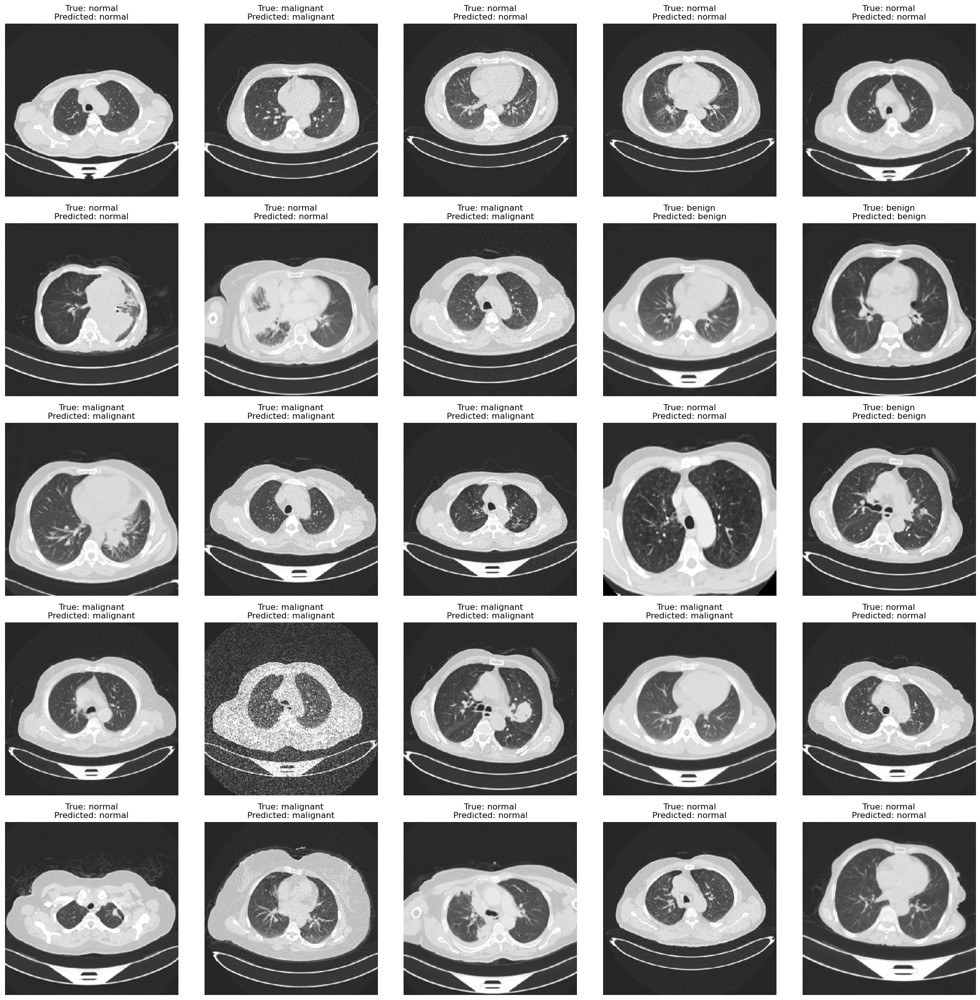

In [30]:
def visualize_predictions(test_gen, y_true, y_pred, classes):
    test_gen.reset() 
    images = []
    for _ in range(len(y_true) // test_gen.batch_size + 1):
        batch_x, _ = next(test_gen)
        images.extend(batch_x)

    images = images[:len(y_true)]  
    
    plt.figure(figsize=(20, 20))
    for i in range(25):  
        plt.subplot(5, 5, i + 1)
        plt.imshow(images[i].astype("uint8"))
        actual_label = classes[y_true[i]]
        predicted_label = classes[y_pred[i]]
        plt.title(f"True: {actual_label}\nPredicted: {predicted_label}")
        plt.axis('off')
    plt.tight_layout()
    plt.show()

visualize_predictions(test_gen, y_true, y_pred, classes)

### CNN

In [31]:
def build_2d_cnn(input_shape, num_classes):
    inputs = Input(shape=input_shape)

    x = Conv2D(64, (3, 3), padding='same')(inputs)
    x = Activation('relu')(x)
    x = BatchNormalization()(x)
    x = MaxPooling2D(pool_size=(2, 2), strides=(2, 2), padding='same')(x)

    x = Conv2D(128, (3, 3), padding='same')(x)
    x = Activation('relu')(x)
    x = BatchNormalization()(x)
    x = MaxPooling2D(pool_size=(2, 2), strides=(2, 2), padding='same')(x)

    x = Conv2D(256, (3, 3), padding='same')(x)
    x = Activation('relu')(x)
    x = BatchNormalization()(x)
    x = MaxPooling2D(pool_size=(2, 2), strides=(2, 2), padding='same')(x)

    x = Conv2DTranspose(256, (3, 3), strides=(2, 2), padding='same')(x)
    x = Activation('relu')(x)
    x = BatchNormalization()(x)

    x = Conv2DTranspose(128, (3, 3), strides=(2, 2), padding='same')(x)
    x = Activation('relu')(x)
    x = BatchNormalization()(x)

    x = Conv2DTranspose(64, (3, 3), strides=(2, 2), padding='same')(x)
    x = Activation('relu')(x)
    x = BatchNormalization()(x)

    x = Conv2D(num_classes, (1, 1), padding='same')(x)
    x = Activation('softmax')(x)

    outputs = GlobalAveragePooling2D()(x)

    model = Model(inputs=inputs, outputs=outputs)
    
    return model


In [32]:
modelcnn = build_2d_cnn((224,224,3), num_classes=3)
modelcnn.compile(optimizer=Adam(learning_rate=0.0001), loss='binary_crossentropy',  metrics=['accuracy'])

In [33]:
history_cnn=modelcnn.fit(train_gen, 
          validation_data=val_gen, 
          epochs=50)


Epoch 1/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 7s 19ms/step - accuracy: 0.6998 - loss: 0.4525 - val_accuracy: 0.8364 - val_loss: 0.3011
Epoch 2/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 6s 16ms/step - accuracy: 0.7115 - loss: 0.4119 - val_accuracy: 0.6909 - val_loss: 0.4352
Epoch 3/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 6s 16ms/step - accuracy: 0.7574 - loss: 0.3800 - val_accuracy: 0.8485 - val_loss: 0.3037
Epoch 4/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 6s 16ms/step - accuracy: 0.7747 - loss: 0.3657 - val_accuracy: 0.8000 - val_loss: 0.3334
Epoch 5/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 6s 16ms/step - accuracy: 0.8020 - loss: 0.3467 - val_accuracy: 0.8606 - val_loss: 0.2537
Epoch 6/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 6s 16ms/step - accuracy: 0.7938 - loss: 0.3465 - val_accuracy: 0.8727 - val_loss: 0.2585
Epoch 7/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 6s 16ms/step - accuracy: 0.8093 - loss: 0.3315 - val_accuracy: 0.8727 - val_loss: 0.2341
Epoch 8/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 6s 16ms/step - accuracy: 0.8615 - loss: 0.2778 - val_accu

In [34]:
test_loss_cnn, test_accuracy_cnn = modelcnn.evaluate(test_gen)

83/83 ━━━━━━━━━━━━━━━━━━━━ 1s 13ms/step - accuracy: 0.7548 - loss: 0.3329


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━

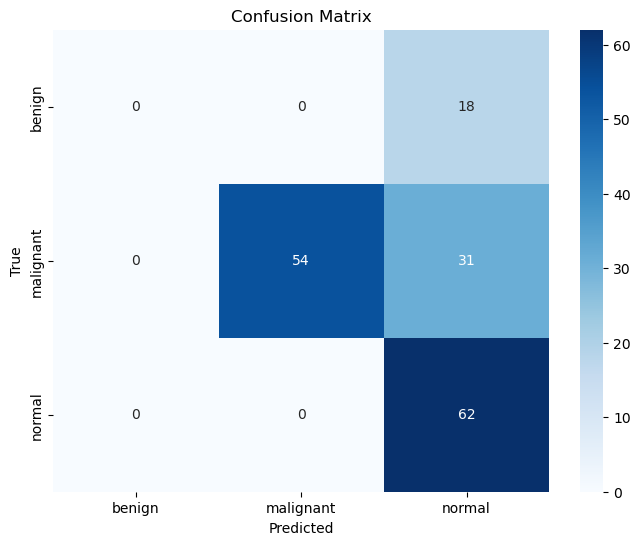

              precision    recall  f1-score   support

           0       0.00      0.00      0.00        18
           1       1.00      0.64      0.78        85
           2       0.56      1.00      0.72        62

    accuracy                           0.70       165
   macro avg       0.52      0.55      0.50       165
weighted avg       0.73      0.70      0.67       165



/home/ec2-user/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/ec2-user/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/ec2-user/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [35]:
y_true, y_pred, classes = evaluate_model(modelcnn, test_gen, label_mapping)

In [36]:
history_cnn1=modelcnn.fit(train_gen, 
          validation_data=val_gen, 
          epochs=50)

### Mobilenet 

In [38]:
def mobilenet_version2(num_classes=3):
    base_model = MobileNetV3Large(weights="imagenet", include_top=False, input_shape=(224, 224,3))

    for layer in base_model.layers:
        layer.trainable = False
    
    x = base_model.output
    x = GlobalAveragePooling2D()(x)
    # x = Dense(512, activation='relu')(x)
    x = Dense(1024, activation='relu')(x)
    # x = Dropout(0.3)(x) 
    output = Dense(num_classes, activation="softmax", name="output")(x)
    model = Model(inputs=base_model.input, outputs=output)
    
    optimizer = Adam(learning_rate=0.0001)
    model.compile(optimizer=optimizer, loss='categorical_crossentropy', metrics=['accuracy'])
    
    return model

In [39]:
model = mobilenet_version2(num_classes=3)

In [40]:
model.summary()

Model: "functional_4"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_4       │ (None, 224, 224,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ rescaling_4         │ (None, 224, 224,  │          0 │ input_layer_4[0]… │
│ (Rescaling)         │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv (Conv2D)       │ (None, 112, 112,  │        432 │ rescaling_4[0][0] │
│                     │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv_bn             │ (None, 112, 112,  │         64 │ conv[0][0]        │
│ (BatchNormalizatio… │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_80       │ (None, 112, 112,  │          0 │ conv_bn[0][0]     │
│ (Activation)        │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_dept… │ (None, 112, 112,  │        144 │ activation_80[0]… │
│ (DepthwiseConv2D)   │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_dept… │ (None, 112, 112,  │         64 │ expanded_conv_de… │
│ (BatchNormalizatio… │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ re_lu_76 (ReLU)     │ (None, 112, 112,  │          0 │ expanded_conv_de… │
│                     │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_proj… │ (None, 112, 112,  │        256 │ re_lu_76[0][0]    │
│ (Conv2D)            │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_proj… │ (None, 112, 112,  │         64 │ expanded_conv_pr… │
│ (BatchNormalizatio… │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_add   │ (None, 112, 112,  │          0 │ activation_80[0]… │
│ (Add)               │ 16)               │            │ expanded_conv_pr… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_1_ex… │ (None, 112, 112,  │      1,024 │ expanded_conv_ad… │
│ (Conv2D)            │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_1_ex… │ (None, 112, 112,  │        256 │ expanded_conv_1_… │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ re_lu_77 (ReLU)     │ (None, 112, 112,  │          0 │ expanded_conv_1_… │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_1_de… │ (None, 113, 113,  │          0 │ re_lu_77[0][0]    │
│ (ZeroPadding2D)     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_1_de… │ (None, 56, 56,    │        576 │ expanded_conv_1_… │
│ (DepthwiseConv2D)   │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_1_de… │ (None, 56, 56,    │        256 │ expanded_conv_1_

 Total params: 3,983,491 (15.20 MB)

 Trainable params: 987,139 (3.77 MB)

 Non-trainable params: 2,996,352 (11.43 MB)

In [41]:
history_v2 = model.fit(
    train_gen,
    #steps_per_epoch=len(df_train)//batch_size,
    validation_data=val_gen,
    #validation_steps=len(df_val)//batch_size,
    epochs=50,
    #class_weight = train_class_weights
)

Epoch 1/50


/home/ec2-user/anaconda3/lib/python3.11/site-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


384/384 ━━━━━━━━━━━━━━━━━━━━ 39s 62ms/step - accuracy: 0.8143 - loss: 0.5673 - val_accuracy: 0.9333 - val_loss: 0.2037
Epoch 2/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 24s 28ms/step - accuracy: 0.9273 - loss: 0.1977 - val_accuracy: 0.9394 - val_loss: 0.1923
Epoch 3/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 11s 28ms/step - accuracy: 0.9450 - loss: 0.1275 - val_accuracy: 0.9333 - val_loss: 0.1890
Epoch 4/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 21s 28ms/step - accuracy: 0.9622 - loss: 0.1126 - val_accuracy: 0.9091 - val_loss: 0.2071
Epoch 5/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 20s 28ms/step - accuracy: 0.9727 - loss: 0.0924 - val_accuracy: 0.9636 - val_loss: 0.1416
Epoch 6/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 20s 27ms/step - accuracy: 0.9724 - loss: 0.0840 - val_accuracy: 0.9394 - val_loss: 0.1708
Epoch 7/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 11s 29ms/step - accuracy: 0.9757 - loss: 0.0690 - val_accuracy: 0.9394 - val_loss: 0.1293
Epoch 8/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 11s 28ms/step - accuracy: 0.9951 - loss: 0.0353 - val_accurac

In [42]:
test_loss, test_accuracy = model.evaluate(test_gen)


83/83 ━━━━━━━━━━━━━━━━━━━━ 2s 20ms/step - accuracy: 0.9547 - loss: 0.1136


1/1 ━━━━━━━━━━━━━━━━━━━━ 5s 5s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━

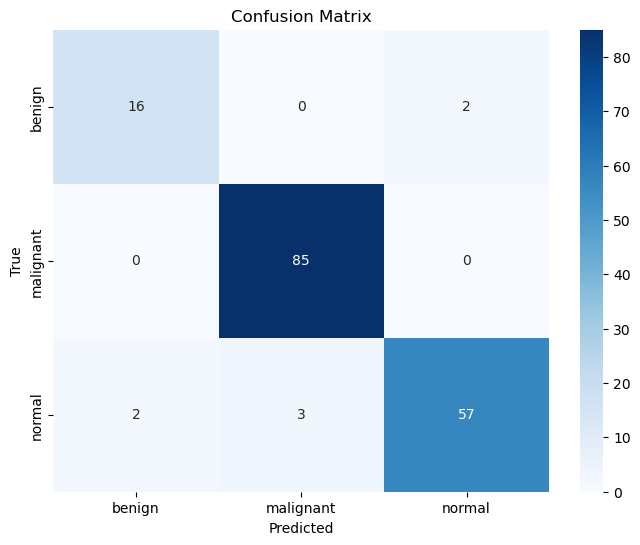

              precision    recall  f1-score   support

           0       0.89      0.89      0.89        18
           1       0.97      1.00      0.98        85
           2       0.97      0.92      0.94        62

    accuracy                           0.96       165
   macro avg       0.94      0.94      0.94       165
weighted avg       0.96      0.96      0.96       165



In [43]:
y_true, y_pred, classes = evaluate_model(model, test_gen, label_mapping)

In [44]:
cm = confusion_matrix(y_true, y_pred, labels=list(label_mapping.values()))
class_accuracies = accuracy_per_class(cm)
print("Accuracy per class:")
for class_name, accuracy in class_accuracies.items():
    print(f"{class_name}: {accuracy:.2f}")


Accuracy per class:
Benign: 0.89
Malignant: 1.00
Normal: 0.92


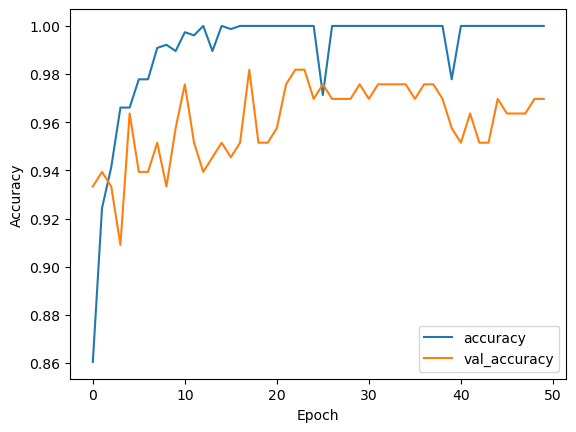

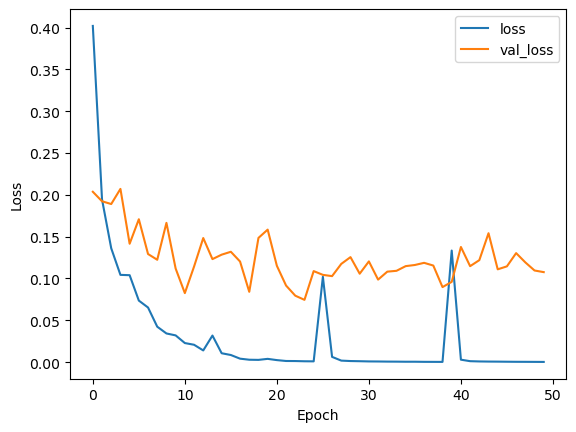

In [45]:
plt.plot(history_v2.history['accuracy'], label='accuracy')
plt.plot(history_v2.history['val_accuracy'], label='val_accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend(loc='lower right')
plt.show()

plt.plot(history_v2.history['loss'], label='loss')
plt.plot(history_v2.history['val_loss'], label='val_loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend(loc='upper right')
plt.show()

In [46]:
def get_img_array(img_path, size):
    img = tf.keras.preprocessing.image.load_img(img_path, target_size=size)
    img_array = tf.keras.preprocessing.image.img_to_array(img)
    img_array = np.expand_dims(img_array, axis=0)
    return img_array

In [47]:
def find_last_conv_layer(model):
    for layer in reversed(model.layers):
        if hasattr(layer, 'kernel_size'):
            return layer.name
    raise ValueError("No convolutional layer found in the model.")


In [48]:
def make_gradcam_heatmap(img_array, model, last_conv_layer_name, pred_index=None):

    grad_model = Model(
        [model.inputs], [model.get_layer(last_conv_layer_name).output, model.output]
    )

    with tf.GradientTape() as tape:
        last_conv_layer_output, preds = grad_model(img_array)
        if pred_index is None:
            pred_index = tf.argmax(preds[0])
        class_channel = preds[:, pred_index]
    grads = tape.gradient(class_channel, last_conv_layer_output)

    pooled_grads = tf.reduce_mean(grads, axis=(0, 1, 2))
    last_conv_layer_output = last_conv_layer_output[0]
    heatmap = last_conv_layer_output @ pooled_grads[..., tf.newaxis]
    heatmap = tf.squeeze(heatmap)
    heatmap = tf.maximum(heatmap, 0) / tf.math.reduce_max(heatmap)
    return heatmap.numpy()

In [49]:
def save_and_display_gradcam(img_path, heatmap, cam_path="cam.jpg", alpha=0.4):

    img = cv2.imread(img_path)
    heatmap = np.uint8(255 * heatmap)
    heatmap = cv2.resize(heatmap, (img.shape[1], img.shape[0]))
    jet = cv2.applyColorMap(heatmap, cv2.COLORMAP_JET)
    superimposed_img = cv2.addWeighted(img, alpha, jet, 1 - alpha, 0)
    cv2.imwrite(cam_path, superimposed_img)
    plt.figure(figsize=(7, 9))
    plt.subplot(1, 2, 1)
    plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    plt.title('Original Image')
    plt.axis('off')

    plt.subplot(1, 2, 2)
    plt.imshow(cv2.cvtColor(superimposed_img, cv2.COLOR_BGR2RGB))
    plt.title('Grad-CAM')
    plt.axis('off')

    plt.show()

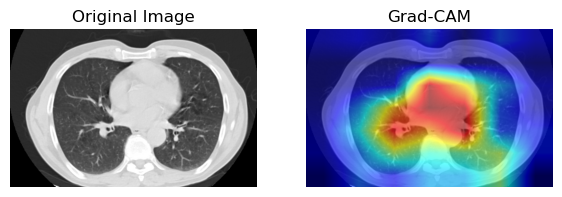

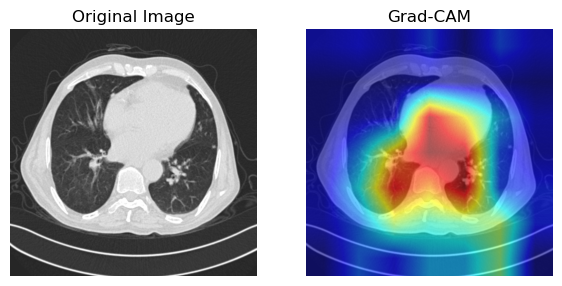

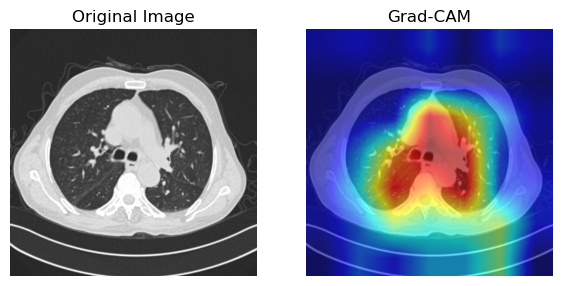

In [50]:

img_path = '/home/ec2-user/teza-folder/lungs-cancer/malignant/Malignant case (220).jpg' 
img_array = get_img_array(img_path, size=(224, 224))
last_conv_layer_name = "activation_99"

heatmap = make_gradcam_heatmap(img_array, model, last_conv_layer_name)

save_and_display_gradcam(img_path, heatmap)
img_path1 = '/home/ec2-user/teza-folder/lungs-cancer/malignant/Malignant case (270).jpg' 
img_array1 = get_img_array(img_path1, size=(224, 224))

heatmap1 = make_gradcam_heatmap(img_array1, model, last_conv_layer_name)

save_and_display_gradcam(img_path1, heatmap)

img_path2 = '/home/ec2-user/teza-folder/lungs-cancer/malignant/Malignant case (280).jpg' 
img_array2 = get_img_array(img_path2, size=(224, 224))

heatmap1 = make_gradcam_heatmap(img_array2, model, last_conv_layer_name)

save_and_display_gradcam(img_path2, heatmap)


### VGG 16

In [51]:
def build_vgg16_model(input_shape, num_classes):
    base_model = VGG16(weights="imagenet", include_top=False, input_shape=(224, 224,3))

    for layer in base_model.layers:
        layer.trainable = False
    
    x = base_model.output
    x = GlobalAveragePooling2D()(x)
    # x = Dense(512, activation='relu')(x)
    x = Dense(1024, activation='relu')(x)
    #x = Dropout(0.3)(x) 
    output = Dense(num_classes, activation="softmax", name="output")(x)
    model = Model(inputs=base_model.input, outputs=output)
    
    optimizer = Adam(learning_rate=0.0001)
    model.compile(optimizer=optimizer, loss='categorical_crossentropy', metrics=['accuracy'])
    
    return model

In [52]:
input_shape = (224, 224, 3)
num_classes = 3

model_vgg16 = build_vgg16_model(input_shape, num_classes)


In [53]:
model_vgg16.summary()

Model: "functional_6"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_6 (InputLayer)      │ (None, 224, 224, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_conv1 (Conv2D)           │ (None, 224, 224, 64)   │         1,792 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_conv2 (Conv2D)           │ (None, 224, 224, 64)   │        36,928 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_pool (MaxPooling2D)      │ (None, 112, 112, 64)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_conv1 (Conv2D)           │ (None, 112, 112, 128)  │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_conv2 (Conv2D)           │ (None, 112, 112, 128)  │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_pool (MaxPooling2D)      │ (None, 56, 56, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv1 (Conv2D)           │ (None, 56, 56, 256)    │       295,168 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv2 (Conv2D)           │ (None, 56, 56, 256)    │       590,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv3 (Conv2D)           │ (None, 56, 56, 256)    │       590,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_pool (MaxPooling2D)      │ (None, 28, 28, 256)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv1 (Conv2D)           │ (None, 28, 28, 512)    │     1,180,160 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv2 (Conv2D)           │ (None, 28, 28, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv3 (Conv2D)           │ (None, 28, 28, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_pool (MaxPooling2D)      │ (None, 14, 14, 512)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv1 (Conv2D)           │ (None, 14, 14, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv2 (Conv2D)           │ (None, 14, 14, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv3 (Conv2D)           │ (None, 14, 14, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_pool (MaxPooling2D)      │ (None, 7, 7, 512)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_average_pooling2d_6      │ (None, 512)            │             0 │
│ (GlobalAveragePooling2D)        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_6 (Dense)                 │ (None, 1024)           │       525,312 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 3)              │         3,075 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 15,243,075 (58.15 MB)

 Trainable params: 528,387 (2.02 MB)

 Non-trainable params: 14,714,688 (56.13 MB)

In [54]:
history_vgg16 = model_vgg16.fit(
    train_gen,
    #steps_per_epoch=len(df_train)//batch_size,
    validation_data=val_gen,
    #validation_steps=len(df_val)//batch_size,
    epochs=50,
    #class_weight = train_class_weights
)

Epoch 1/50


/home/ec2-user/anaconda3/lib/python3.11/site-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


384/384 ━━━━━━━━━━━━━━━━━━━━ 10s 21ms/step - accuracy: 0.7301 - loss: 1.0643 - val_accuracy: 0.8606 - val_loss: 0.3548
Epoch 2/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 6s 16ms/step - accuracy: 0.9315 - loss: 0.2309 - val_accuracy: 0.9091 - val_loss: 0.2407
Epoch 3/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 6s 16ms/step - accuracy: 0.9466 - loss: 0.1494 - val_accuracy: 0.8909 - val_loss: 0.3013
Epoch 4/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 6s 16ms/step - accuracy: 0.9316 - loss: 0.1656 - val_accuracy: 0.9273 - val_loss: 0.2405
Epoch 5/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 6s 16ms/step - accuracy: 0.9711 - loss: 0.0774 - val_accuracy: 0.9455 - val_loss: 0.2281
Epoch 6/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 6s 16ms/step - accuracy: 0.9803 - loss: 0.0603 - val_accuracy: 0.9273 - val_loss: 0.2363
Epoch 7/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 6s 16ms/step - accuracy: 0.9794 - loss: 0.0461 - val_accuracy: 0.9636 - val_loss: 0.1565
Epoch 8/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 6s 16ms/step - accuracy: 0.9781 - loss: 0.0540 - val_accuracy: 0.93

In [55]:
test_loss_vgg16, test_accuracy_vgg16 = model_vgg16.evaluate(test_gen)

13/83 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - accuracy: 0.9938 - loss: 0.0183   

/home/ec2-user/anaconda3/lib/python3.11/site-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


83/83 ━━━━━━━━━━━━━━━━━━━━ 1s 13ms/step - accuracy: 0.9585 - loss: 0.0980


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 471ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━

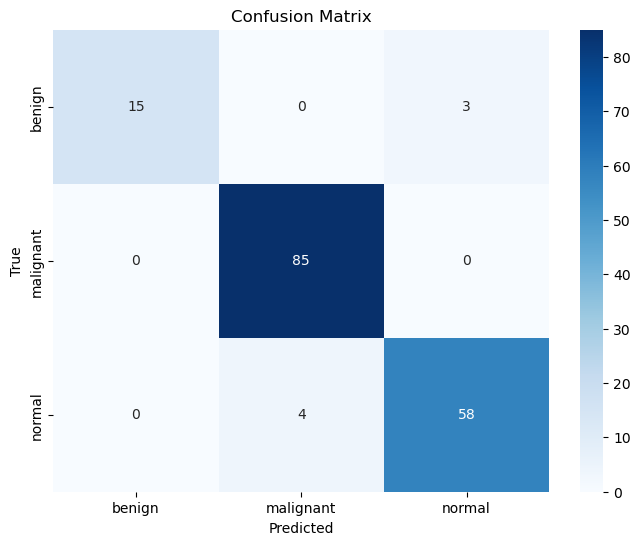

              precision    recall  f1-score   support

           0       1.00      0.83      0.91        18
           1       0.96      1.00      0.98        85
           2       0.95      0.94      0.94        62

    accuracy                           0.96       165
   macro avg       0.97      0.92      0.94       165
weighted avg       0.96      0.96      0.96       165



In [56]:
y_true, y_pred, classes = evaluate_model(model_vgg16, test_gen, label_mapping)


In [57]:
cm = confusion_matrix(y_true, y_pred, labels=list(label_mapping.values()))
class_accuracies = accuracy_per_class(cm)
print("Accuracy per class:")
for class_name, accuracy in class_accuracies.items():
    print(f"{class_name}: {accuracy:.2f}")


Accuracy per class:
Benign: 0.83
Malignant: 1.00
Normal: 0.94


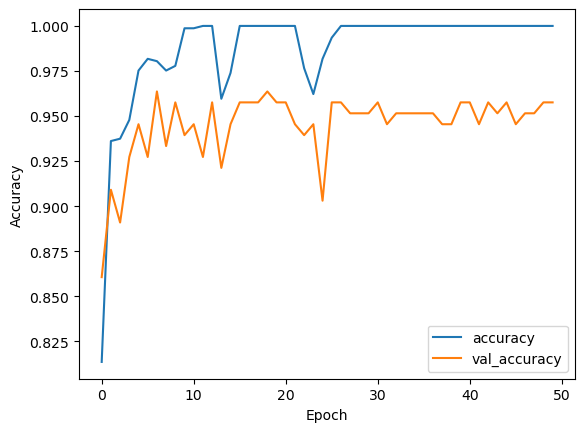

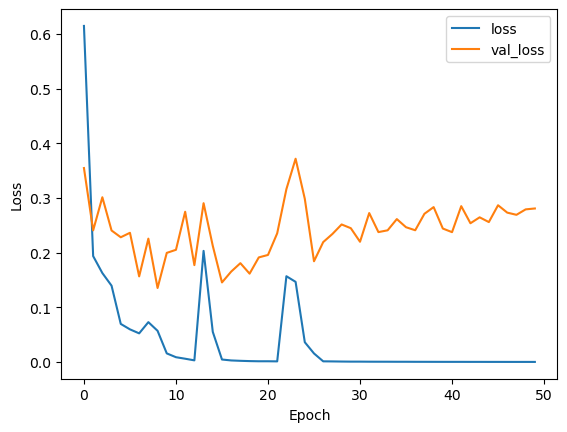

In [58]:
plt.plot(history_vgg16.history['accuracy'], label='accuracy')
plt.plot(history_vgg16.history['val_accuracy'], label='val_accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend(loc='lower right')
plt.show()

plt.plot(history_vgg16.history['loss'], label='loss')
plt.plot(history_vgg16.history['val_loss'], label='val_loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend(loc='upper right')
plt.show()

In [59]:
model_vgg16.summary()

Model: "functional_6"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_6 (InputLayer)      │ (None, 224, 224, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_conv1 (Conv2D)           │ (None, 224, 224, 64)   │         1,792 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_conv2 (Conv2D)           │ (None, 224, 224, 64)   │        36,928 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_pool (MaxPooling2D)      │ (None, 112, 112, 64)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_conv1 (Conv2D)           │ (None, 112, 112, 128)  │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_conv2 (Conv2D)           │ (None, 112, 112, 128)  │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_pool (MaxPooling2D)      │ (None, 56, 56, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv1 (Conv2D)           │ (None, 56, 56, 256)    │       295,168 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv2 (Conv2D)           │ (None, 56, 56, 256)    │       590,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv3 (Conv2D)           │ (None, 56, 56, 256)    │       590,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_pool (MaxPooling2D)      │ (None, 28, 28, 256)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv1 (Conv2D)           │ (None, 28, 28, 512)    │     1,180,160 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv2 (Conv2D)           │ (None, 28, 28, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv3 (Conv2D)           │ (None, 28, 28, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_pool (MaxPooling2D)      │ (None, 14, 14, 512)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv1 (Conv2D)           │ (None, 14, 14, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv2 (Conv2D)           │ (None, 14, 14, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv3 (Conv2D)           │ (None, 14, 14, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_pool (MaxPooling2D)      │ (None, 7, 7, 512)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_average_pooling2d_6      │ (None, 512)            │             0 │
│ (GlobalAveragePooling2D)        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_6 (Dense)                 │ (None, 1024)           │       525,312 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 3)              │         3,075 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 16,299,851 (62.18 MB)

 Trainable params: 528,387 (2.02 MB)

 Non-trainable params: 14,714,688 (56.13 MB)

 Optimizer params: 1,056,776 (4.03 MB)

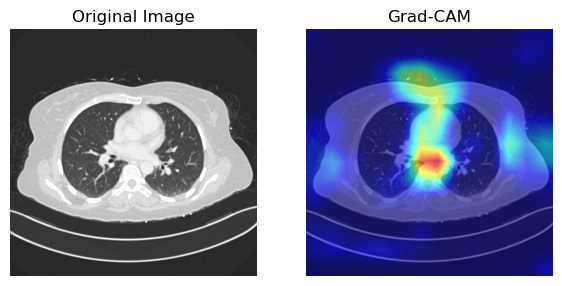

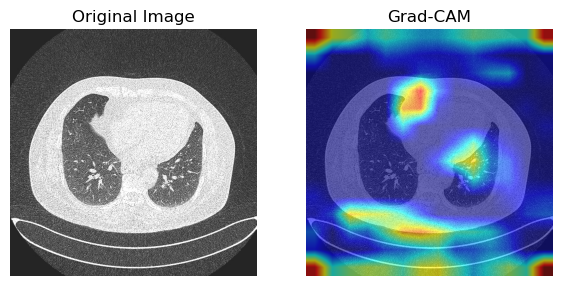

In [60]:

img_path = '/home/ec2-user/teza-folder/lungs-cancer/malignant/Malignant case (112).jpg'
img_array = get_img_array(img_path, size=(224, 224))
last_conv_layer_name = "block5_conv3"

heatmap = make_gradcam_heatmap(img_array, model_vgg16, last_conv_layer_name)
save_and_display_gradcam(img_path, heatmap)

img_path2 = '/home/ec2-user/teza-folder/lungs-cancer/beningn/Bengin case (101).jpg' 
img_array2 = get_img_array(img_path2, size=(224, 224))

heatmap2 = make_gradcam_heatmap(img_array2, model_vgg16, last_conv_layer_name)

save_and_display_gradcam(img_path2, heatmap2)

### VGG 19

In [61]:
def build_vgg119_model(input_shape, num_classes):
    base_model = VGG19(weights="imagenet", include_top=False, input_shape=(224, 224,3))

    for layer in base_model.layers:
        layer.trainable = False
    
    x = base_model.output
    x = GlobalAveragePooling2D()(x)
    #x = Dense(512, activation='relu')(x)
    x = Dense(1024, activation='relu')(x)
    #x = Dropout(0.3)(x) 
    output = Dense(num_classes, activation="softmax", name="output")(x)
    model = Model(inputs=base_model.input, outputs=output)
    
    optimizer = Adam(learning_rate=0.0001)
    model.compile(optimizer=optimizer, loss='categorical_crossentropy', metrics=['accuracy'])
    
    return model

In [62]:
input_shape = (224, 224, 3)
num_classes = 3

model_vgg19 = build_vgg119_model(input_shape, num_classes)

In [63]:
history_vgg19 = model_vgg19.fit(
    train_gen,
    #steps_per_epoch=len(df_train)//batch_size,
    validation_data=val_gen,
    #validation_steps=len(df_val)//batch_size,
    epochs=50,
    #class_weight = train_class_weights
)

Epoch 1/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 10s 19ms/step - accuracy: 0.7541 - loss: 1.1906 - val_accuracy: 0.8667 - val_loss: 0.3450
Epoch 2/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 6s 16ms/step - accuracy: 0.8907 - loss: 0.2583 - val_accuracy: 0.9030 - val_loss: 0.3257
Epoch 3/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 6s 16ms/step - accuracy: 0.9502 - loss: 0.1220 - val_accuracy: 0.8788 - val_loss: 0.6044
Epoch 4/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 6s 16ms/step - accuracy: 0.9464 - loss: 0.1695 - val_accuracy: 0.9394 - val_loss: 0.2190
Epoch 5/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 6s 16ms/step - accuracy: 0.9543 - loss: 0.0893 - val_accuracy: 0.9394 - val_loss: 0.1626
Epoch 6/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 6s 16ms/step - accuracy: 0.9925 - loss: 0.0435 - val_accuracy: 0.9455 - val_loss: 0.2504
Epoch 7/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 6s 16ms/step - accuracy: 0.9747 - loss: 0.0628 - val_accuracy: 0.9273 - val_loss: 0.1778
Epoch 8/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 6s 16ms/step - accuracy: 0.9964 - loss: 0.0220 - val_acc

In [64]:
test_loss_vgg19, test_accuracy_vgg19 = model_vgg19.evaluate(test_gen)

13/83 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - accuracy: 1.0000 - loss: 0.0075

/home/ec2-user/anaconda3/lib/python3.11/site-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


83/83 ━━━━━━━━━━━━━━━━━━━━ 1s 13ms/step - accuracy: 0.9872 - loss: 0.0458


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 534ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━

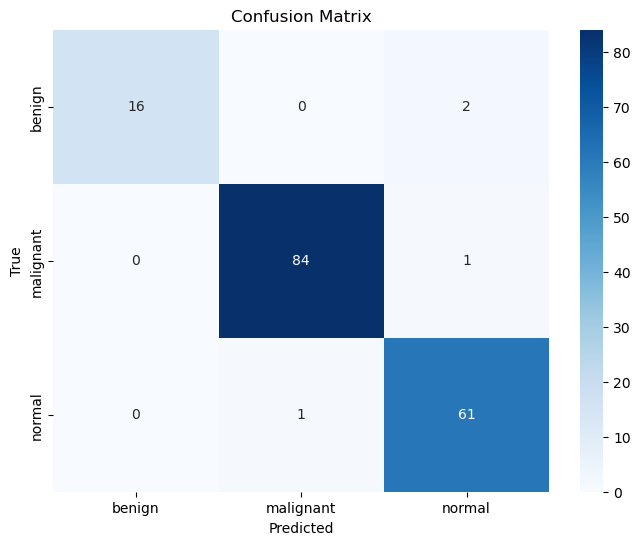

              precision    recall  f1-score   support

           0       1.00      0.89      0.94        18
           1       0.99      0.99      0.99        85
           2       0.95      0.98      0.97        62

    accuracy                           0.98       165
   macro avg       0.98      0.95      0.97       165
weighted avg       0.98      0.98      0.98       165



In [65]:
y_true, y_pred, classes = evaluate_model(model_vgg19, test_gen, label_mapping)

In [66]:
cm = confusion_matrix(y_true, y_pred, labels=list(label_mapping.values()))
class_accuracies = accuracy_per_class(cm)
print("Accuracy per class:")
for class_name, accuracy in class_accuracies.items():
    print(f"{class_name}: {accuracy:.2f}")


Accuracy per class:
Benign: 0.89
Malignant: 0.99
Normal: 0.98


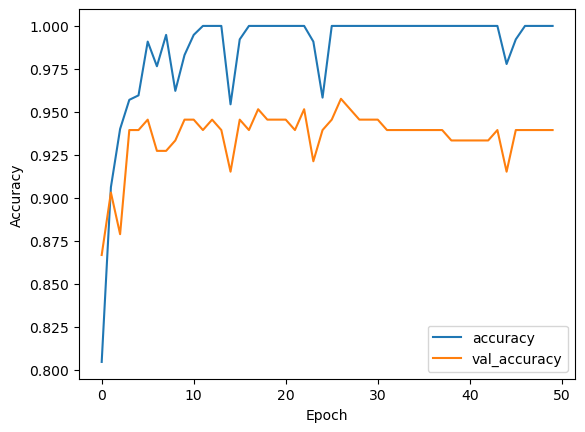

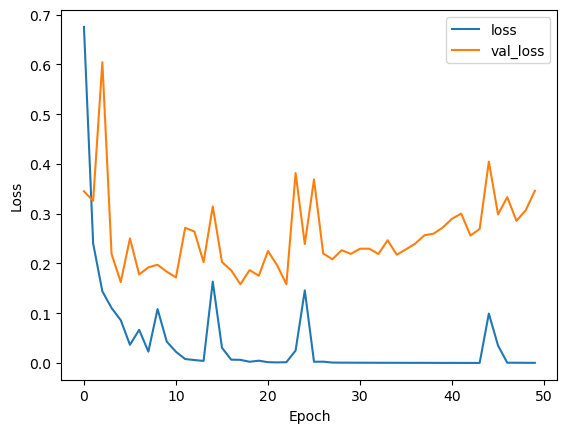

In [67]:
plt.plot(history_vgg19.history['accuracy'], label='accuracy')
plt.plot(history_vgg19.history['val_accuracy'], label='val_accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend(loc='lower right')
plt.show()

plt.plot(history_vgg19.history['loss'], label='loss')
plt.plot(history_vgg19.history['val_loss'], label='val_loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend(loc='upper right')
plt.show()

In [68]:
model_vgg19.save_weights('/home/ec2-user/teza-folder/models_weights/vgg19.weights.h5')


In [69]:
model_vgg19.save('/home/ec2-user/teza-folder/models/vgg19.keras')

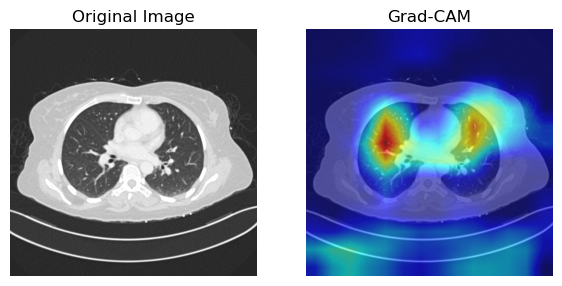

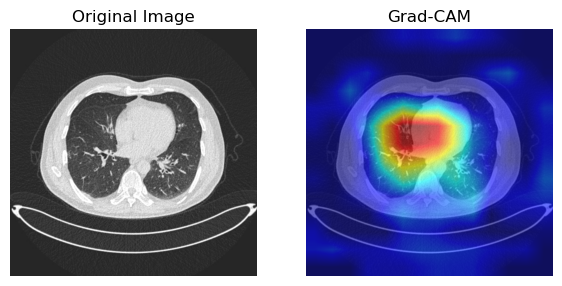

In [70]:

img_path = '/home/ec2-user/teza-folder/lungs-cancer/malignant/Malignant case (112).jpg'
img_array = get_img_array(img_path, size=(224, 224))
last_conv_layer_name = "block5_conv4"

heatmap = make_gradcam_heatmap(img_array, model_vgg19, last_conv_layer_name)
save_and_display_gradcam(img_path, heatmap)

img_path2 = '/home/ec2-user/teza-folder/lungs-cancer/beningn/Bengin case (9).jpg' 
img_array2 = get_img_array(img_path2, size=(224, 224))

heatmap2 = make_gradcam_heatmap(img_array2, model_vgg19, last_conv_layer_name)

save_and_display_gradcam(img_path2, heatmap2)

### Inception V3

In [71]:
def build_inception(input_shape, num_classes):
    base_model = InceptionV3(weights="imagenet", include_top=False, input_shape=(224, 224,3))

    for layer in base_model.layers:
        layer.trainable = False
    
    x = base_model.output
    x = GlobalAveragePooling2D()(x)
    # x = Dense(512, activation='relu')(x)
    x = Dense(1024, activation='relu')(x)
    # x = Dropout(0.3)(x) 
    output = Dense(num_classes, activation="softmax", name="output")(x)
    model = Model(inputs=base_model.input, outputs=output)
    
    optimizer = Adam(learning_rate=0.0001)
    model.compile(optimizer=optimizer, loss='categorical_crossentropy', metrics=['accuracy'])
    
    return model

In [72]:
input_shape = (224, 224, 3)
num_classes = 3

model_inception = build_inception(input_shape, num_classes)

In [73]:
history_inception= model_inception.fit(
    train_gen,
    #steps_per_epoch=len(df_train)//batch_size,
    validation_data=val_gen,
    #validation_steps=len(df_val)//batch_size,
    epochs=50,
    #class_weight = train_class_weights
)

Epoch 1/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 32s 50ms/step - accuracy: 0.6011 - loss: 9.8716 - val_accuracy: 0.6000 - val_loss: 5.7988
Epoch 2/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 7s 18ms/step - accuracy: 0.7006 - loss: 5.1905 - val_accuracy: 0.8303 - val_loss: 2.1837
Epoch 3/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 7s 17ms/step - accuracy: 0.7717 - loss: 2.9188 - val_accuracy: 0.8424 - val_loss: 2.5414
Epoch 4/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 7s 17ms/step - accuracy: 0.7814 - loss: 2.4675 - val_accuracy: 0.7697 - val_loss: 3.3683
Epoch 5/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 7s 17ms/step - accuracy: 0.7809 - loss: 3.2240 - val_accuracy: 0.7333 - val_loss: 3.5385
Epoch 6/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 7s 17ms/step - accuracy: 0.7944 - loss: 3.1838 - val_accuracy: 0.8909 - val_loss: 1.3778
Epoch 7/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 7s 18ms/step - accuracy: 0.8502 - loss: 1.7961 - val_accuracy: 0.8970 - val_loss: 1.2756
Epoch 8/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 7s 17ms/step - accuracy: 0.8256 - loss: 2.2209 - val_acc

In [74]:
test_loss_inc, test_accuracy_inc = model_inception.evaluate(test_gen)

83/83 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - accuracy: 0.9376 - loss: 0.2183


1/1 ━━━━━━━━━━━━━━━━━━━━ 5s 5s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━

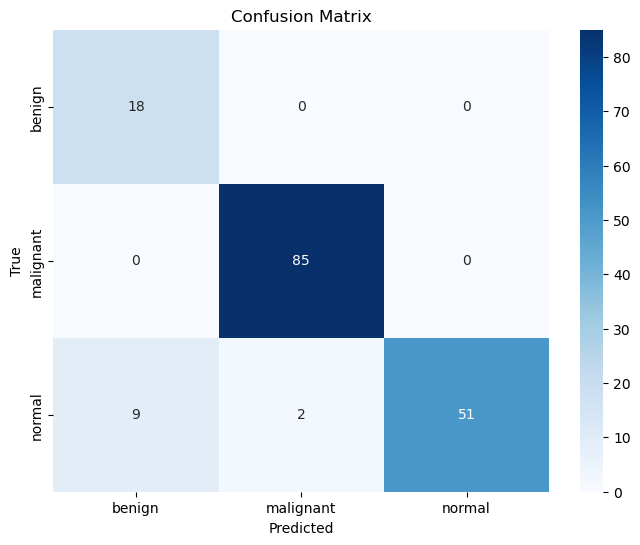

              precision    recall  f1-score   support

           0       0.67      1.00      0.80        18
           1       0.98      1.00      0.99        85
           2       1.00      0.82      0.90        62

    accuracy                           0.93       165
   macro avg       0.88      0.94      0.90       165
weighted avg       0.95      0.93      0.94       165



In [75]:
y_true, y_pred, classes = evaluate_model(model_inception, test_gen, label_mapping)

In [76]:
cm = confusion_matrix(y_true, y_pred, labels=list(label_mapping.values()))
class_accuracies = accuracy_per_class(cm)
print("Accuracy per class:")
for class_name, accuracy in class_accuracies.items():
    print(f"{class_name}: {accuracy:.2f}")


Accuracy per class:
Benign: 1.00
Malignant: 1.00
Normal: 0.82


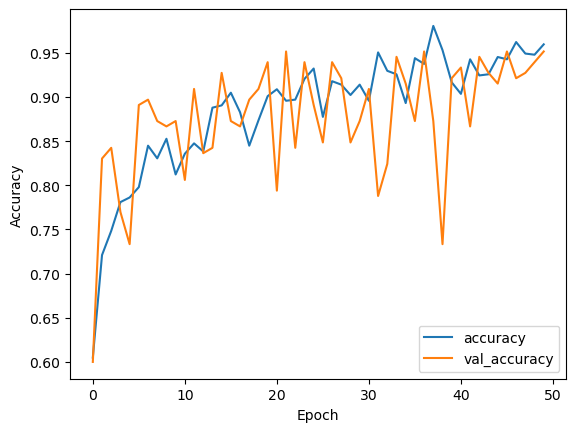

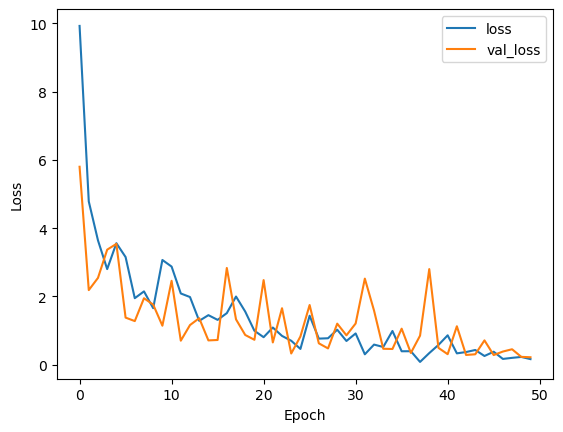

In [77]:
plt.plot(history_inception.history['accuracy'], label='accuracy')
plt.plot(history_inception.history['val_accuracy'], label='val_accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend(loc='lower right')
plt.show()

plt.plot(history_inception.history['loss'], label='loss')
plt.plot(history_inception.history['val_loss'], label='val_loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend(loc='upper right')
plt.show()

In [78]:
model_inception.summary()

Model: "functional_36"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_8       │ (None, 224, 224,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d (Conv2D)     │ (None, 111, 111,  │        864 │ input_layer_8[0]… │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalization │ (None, 111, 111,  │         96 │ conv2d[0][0]      │
│ (BatchNormalizatio… │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation          │ (None, 111, 111,  │          0 │ batch_normalizat… │
│ (Activation)        │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_1 (Conv2D)   │ (None, 109, 109,  │      9,216 │ activation[0][0]  │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 109, 109,  │         96 │ conv2d_1[0][0]    │
│ (BatchNormalizatio… │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_1        │ (None, 109, 109,  │          0 │ batch_normalizat… │
│ (Activation)        │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_2 (Conv2D)   │ (None, 109, 109,  │     18,432 │ activation_1[0][… │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 109, 109,  │        192 │ conv2d_2[0][0]    │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_2        │ (None, 109, 109,  │          0 │ batch_normalizat… │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d       │ (None, 54, 54,    │          0 │ activation_2[0][… │
│ (MaxPooling2D)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_3 (Conv2D)   │ (None, 54, 54,    │      5,120 │ max_pooling2d[0]… │
│                     │ 80)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 54, 54,    │        240 │ conv2d_3[0][0]    │
│ (BatchNormalizatio… │ 80)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_3        │ (None, 54, 54,    │          0 │ batch_normalizat… │
│ (Activation)        │ 80)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_4 (Conv2D)   │ (None, 52, 52,    │    138,240 │ activation_3[0][… │
│                     │ 192)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 52, 52,    │        576 │ conv2d_4[0][0]    │
│ (BatchNormalizatio… │ 192)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_4        │ (None, 52, 52,    │          0 │ batch_normalizat

 Total params: 28,106,539 (107.22 MB)

 Trainable params: 2,101,251 (8.02 MB)

 Non-trainable params: 21,802,784 (83.17 MB)

 Optimizer params: 4,202,504 (16.03 MB)

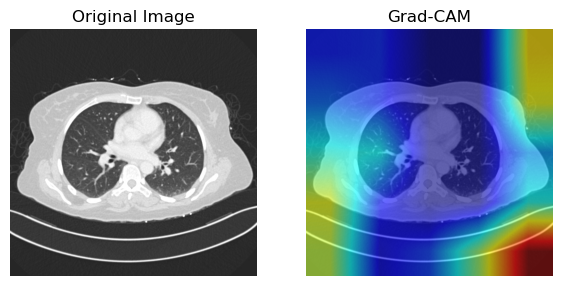

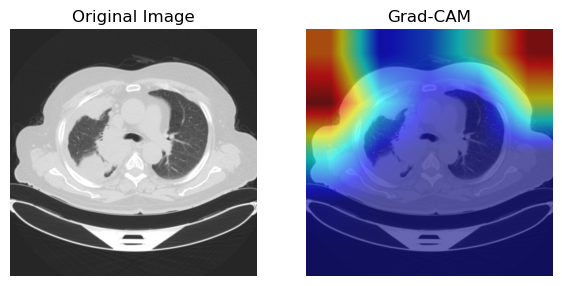

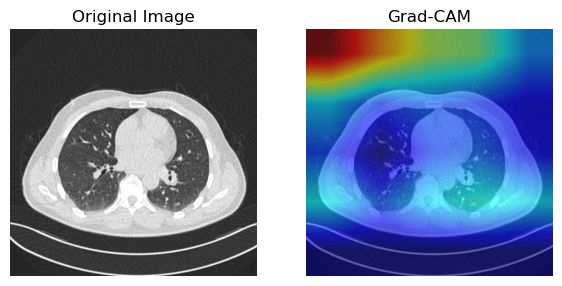

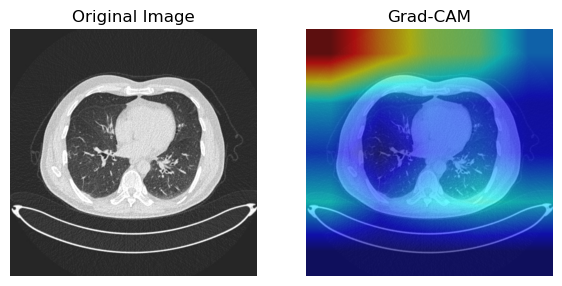

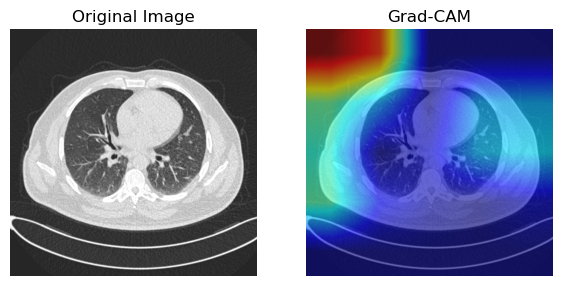

In [79]:

img_path =  '/home/ec2-user/teza-folder/lungs-cancer/malignant/Malignant case (112).jpg'
img_array = get_img_array(img_path, size=(224, 224))
last_conv_layer_name = "mixed10"

heatmap = make_gradcam_heatmap(img_array, model_inception, last_conv_layer_name)
save_and_display_gradcam(img_path, heatmap)

img_path1 =  '/home/ec2-user/teza-folder/lungs-cancer/malignant/Malignant case (20).jpg'
img_array1 = get_img_array(img_path1, size=(224, 224))

heatmap1 = make_gradcam_heatmap(img_array1,model_inception, last_conv_layer_name)
save_and_display_gradcam(img_path1, heatmap1)

img_path2 =  '/home/ec2-user/teza-folder/lungs-cancer/beningn/Bengin case (115).jpg'
img_array2 = get_img_array(img_path2, size=(224, 224))

heatmap2 = make_gradcam_heatmap(img_array2, model_inception, last_conv_layer_name)

save_and_display_gradcam(img_path2, heatmap2)
img_path3 = '/home/ec2-user/teza-folder/lungs-cancer/beningn/Bengin case (10).jpg'
img_array3 = get_img_array(img_path2, size=(224, 224))

heatmap3 = make_gradcam_heatmap(img_array3, model_inception, last_conv_layer_name)

save_and_display_gradcam(img_path3, heatmap3)

img_path4 = '/home/ec2-user/teza-folder/lungs-cancer/beningn/Bengin case (30).jpg'
img_array4 = get_img_array(img_path4, size=(224, 224))

heatmap4 = make_gradcam_heatmap(img_array4, model_inception, last_conv_layer_name)

save_and_display_gradcam(img_path4, heatmap4)

### ResNet50

In [80]:
def resnet50(num_classes=3):
    base_model = ResNet50(weights="imagenet", include_top=False, input_shape=(224, 224,3))

    for layer in base_model.layers:
        layer.trainable = False
    
    x = base_model.output
    x = GlobalAveragePooling2D()(x)
    # x = Dense(512, activation='relu')(x)
    x = Dense(1024, activation='relu')(x)
    # x = Dropout(0.3)(x) 
    output = Dense(num_classes, activation="softmax", name="output")(x)
    model = Model(inputs=base_model.input, outputs=output)
    
    optimizer = Adam(learning_rate=0.0001)
    model.compile(optimizer=optimizer, loss='categorical_crossentropy', metrics=['accuracy'])
    
    return model

In [81]:
input_shape = (224, 224, 3)
num_classes = 3

model_resnet = resnet50( num_classes)

2024-07-17 13:37:19.600503: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1928] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 14785 MB memory:  -> device: 0, name: Tesla V100-SXM2-16GB, pci bus id: 0000:00:1e.0, compute capability: 7.0


In [82]:
history_resnet= model_resnet.fit(
    train_gen,
    #steps_per_epoch=len(df_train)//batch_size,
    validation_data=val_gen,
    #validation_steps=len(df_val)//batch_size,
    epochs=50,
    #class_weight = train_class_weights
)

Epoch 1/50


/home/ec2-user/anaconda3/lib/python3.11/site-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()
I0000 00:00:1721223448.537192  805077 service.cc:145] XLA service 0x7ff8b0003720 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
I0000 00:00:1721223448.537244  805077 service.cc:153]   StreamExecutor device (0): Tesla V100-SXM2-16GB, Compute Capability 7.0
2024-07-17 13:37:28.740363: I tensorflow/compiler/mlir/tensorflow/utils/dump_mlir_util.cc:268] disabling MLIR crash reproducer, set env var `MLIR_CRASH_REPRODUCER_DIRECTORY` to enable.
2024-07-17 13:37:29.914816: I external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:465] Loaded cuDNN version 8907


  9/384 ━━━━━━━━━━━━━━━━━━━━ 5s 14ms/step - accuracy: 0.3084 - loss: 1.5419       

I0000 00:00:1721223451.641760  805077 device_compiler.h:188] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


384/384 ━━━━━━━━━━━━━━━━━━━━ 21s 27ms/step - accuracy: 0.7703 - loss: 0.6299 - val_accuracy: 0.8902 - val_loss: 0.2312
Epoch 2/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 7s 17ms/step - accuracy: 0.8976 - loss: 0.3009 - val_accuracy: 0.8780 - val_loss: 0.3341
Epoch 3/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 7s 17ms/step - accuracy: 0.9366 - loss: 0.1660 - val_accuracy: 0.8780 - val_loss: 0.3126
Epoch 4/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 6s 17ms/step - accuracy: 0.9282 - loss: 0.1588 - val_accuracy: 0.9573 - val_loss: 0.1603
Epoch 5/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 7s 18ms/step - accuracy: 0.9578 - loss: 0.1145 - val_accuracy: 0.9634 - val_loss: 0.1120
Epoch 6/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 7s 17ms/step - accuracy: 0.9601 - loss: 0.1129 - val_accuracy: 0.8963 - val_loss: 0.2242
Epoch 7/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 7s 17ms/step - accuracy: 0.9512 - loss: 0.0996 - val_accuracy: 0.8902 - val_loss: 0.7517
Epoch 8/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 7s 17ms/step - accuracy: 0.9597 - loss: 0.1306 - val_accuracy: 0.96

In [83]:
test_loss_res, test_accuracy_res = model_resnet.evaluate(test_gen)


83/83 ━━━━━━━━━━━━━━━━━━━━ 1s 14ms/step - accuracy: 0.8176 - loss: 0.6664


1/1 ━━━━━━━━━━━━━━━━━━━━ 4s 4s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━

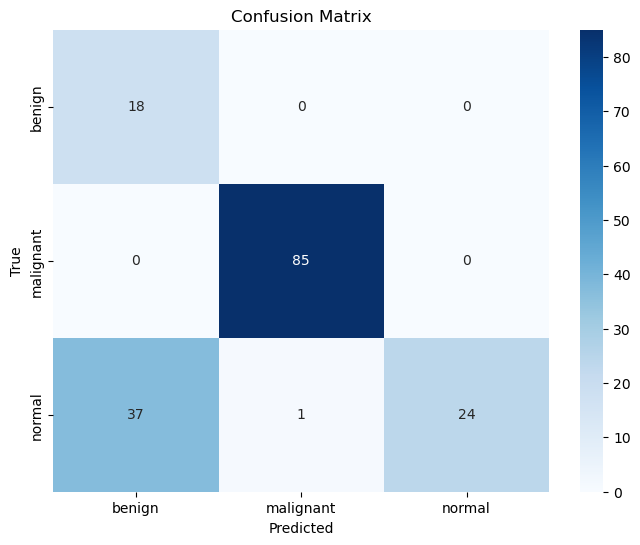

              precision    recall  f1-score   support

           0       0.33      1.00      0.49        18
           1       0.99      1.00      0.99        85
           2       1.00      0.39      0.56        62

    accuracy                           0.77       165
   macro avg       0.77      0.80      0.68       165
weighted avg       0.92      0.77      0.78       165



In [84]:
y_true, y_pred, classes = evaluate_model(model_resnet, test_gen, label_mapping)

In [85]:
cm = confusion_matrix(y_true, y_pred, labels=list(label_mapping.values()))
class_accuracies = accuracy_per_class(cm)
print("Accuracy per class:")
for class_name, accuracy in class_accuracies.items():
    print(f"{class_name}: {accuracy:.2f}")


Accuracy per class:
Benign: 1.00
Malignant: 1.00
Normal: 0.39


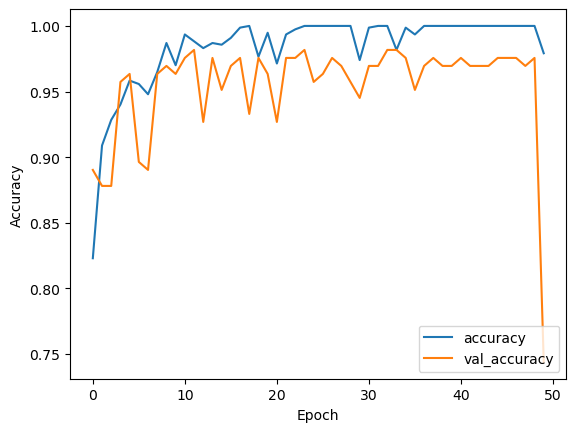

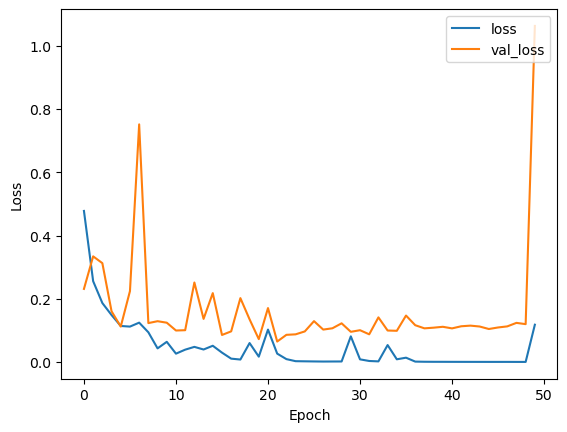

In [86]:
plt.plot(history_resnet.history['accuracy'], label='accuracy')
plt.plot(history_resnet.history['val_accuracy'], label='val_accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend(loc='lower right')
plt.show()

plt.plot(history_resnet.history['loss'], label='loss')
plt.plot(history_resnet.history['val_loss'], label='val_loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend(loc='upper right')
plt.show()

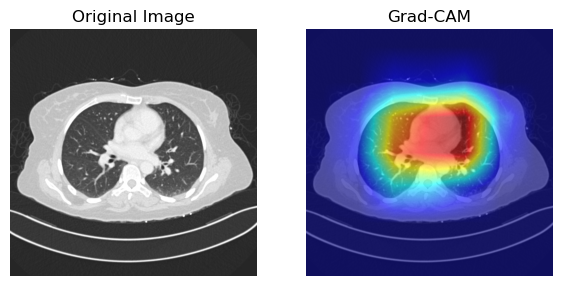

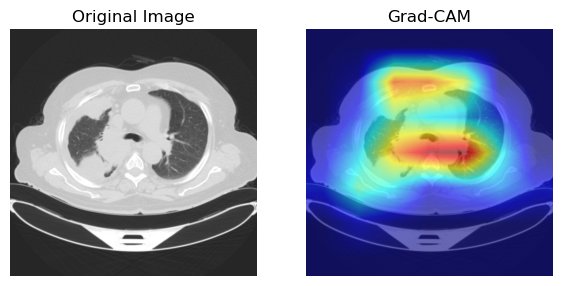

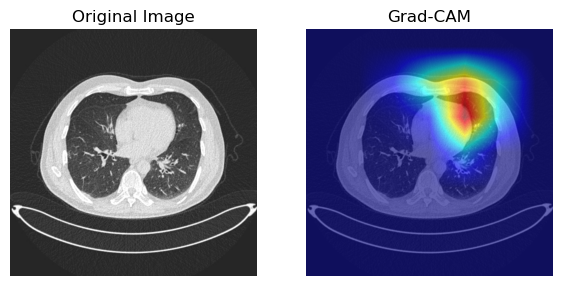

In [87]:

img_path = '/home/ec2-user/teza-folder/lungs-cancer/malignant/Malignant case (112).jpg'
img_array = get_img_array(img_path, size=(224, 224))
last_conv_layer_name = "conv5_block3_3_conv"

heatmap = make_gradcam_heatmap(img_array, model_resnet, last_conv_layer_name)
save_and_display_gradcam(img_path, heatmap)

img_path1 = '/home/ec2-user/teza-folder/lungs-cancer/malignant/Malignant case (20).jpg'
img_array1 = get_img_array(img_path1, size=(224, 224))

heatmap1 = make_gradcam_heatmap(img_array1,model_resnet, last_conv_layer_name)
save_and_display_gradcam(img_path1, heatmap1)

img_path2 =  '/home/ec2-user/teza-folder/lungs-cancer/beningn/Bengin case (10).jpg'
img_array2 = get_img_array(img_path2, size=(224, 224))

heatmap2 = make_gradcam_heatmap(img_array2, model_resnet, last_conv_layer_name)

save_and_display_gradcam(img_path2, heatmap2)

### CT Scans Code 

In [88]:
labels_df = pd.read_csv('/home/ec2-user/teza-folder/labels_exp1.csv')
labels_df2 = pd.read_csv('/home/ec2-user/teza-folder/labels_exp2.csv')
print(labels_df.head())


  type  uuid  slice    x    y
0   FB  1280    100  323  381
1   FB  1009     76  354  288
2   FB  7794     79  163  191
3   FB  7794     94  338  243
4   FB  2997     45  156  135


In [89]:
def load_dicom_images_from_folder(folder_path, relevant_slices):
    slices = []
    for filename in sorted(os.listdir(folder_path)):
        if filename.endswith('.dcm'):
            dicom = pydicom.dcmread(os.path.join(folder_path, filename))
            
            slice_number = int(filename.split('.')[0])  
            
            if slice_number in relevant_slices:
                image = dicom.pixel_array
                image = image / np.max(image)
                slices.append(image)
    
    slices = np.array(slices)
    if len(slices.shape) == 3:
        slices = np.expand_dims(slices, axis=-1)
    return slices

In [90]:
def plot_relevant_slices(df, batch_size=1):
    for start in range(0, len(df), batch_size):
        batch_df = df[start:start + batch_size]
        
        for index, row in batch_df.iterrows():
            folder_path = row['folder_path']  # Correct the folder path
            relevant_slices = row['slice']
            
            # Ensure relevant_slices is a list
            if isinstance(relevant_slices, int):
                relevant_slices = [relevant_slices]
                
            images = load_dicom_images_from_folder(folder_path, relevant_slices)
            
            num_slices = images.shape[0]
            plt.figure(figsize=(20, 4))
            for i in range(num_slices):
                plt.subplot(1, num_slices, i + 1)
                plt.imshow(images[i, :, :, 0], cmap='gray')
                plt.title(f'Slice {relevant_slices[i]}')
                plt.axis('off')
            plt.suptitle(f'Label: {row["type"]}')
            plt.show()

In [91]:
def encode_labels(labels):
    label_encoder = LabelEncoder()
    encoded_labels = label_encoder.fit_transform(labels)
    return encoded_labels, label_encoder

In [92]:
labels_df['file_path'] = labels_df.apply(lambda row: f"EXP1_blind/{row['uuid']}/{row['slice']}.dcm", axis=1)

labels_df['encoded_labels'], label_encoder = encode_labels(labels_df['type'])

print(labels_df.head(100))

   type  uuid  slice    x    y                file_path  encoded_labels
0    FB  1280    100  323  381  EXP1_blind/1280/100.dcm               0
1    FB  1009     76  354  288   EXP1_blind/1009/76.dcm               0
2    FB  7794     79  163  191   EXP1_blind/7794/79.dcm               0
3    FB  7794     94  338  243   EXP1_blind/7794/94.dcm               0
4    FB  2997     45  156  135   EXP1_blind/2997/45.dcm               0
..  ...   ...    ...  ...  ...                      ...             ...
95   TB  6644      0    0    0    EXP1_blind/6644/0.dcm               2
96   TB  1531      0    0    0    EXP1_blind/1531/0.dcm               2
97   TB  1779      0    0    0    EXP1_blind/1779/0.dcm               2
98   TB  1779      0    0    0    EXP1_blind/1779/0.dcm               2
99   TB  1779      0    0    0    EXP1_blind/1779/0.dcm               2

[100 rows x 7 columns]


In [93]:
def shuffle_data(df):
    return df.sample(frac=1).reset_index(drop=True)

In [94]:

labels_df['folder_path'] = labels_df.apply(lambda row: f"EXP1_blind/{row['uuid']}", axis=1)
labels_df['encoded_labels'], label_encoder = encode_labels(labels_df['type'])

train_df_ct, temp_df_ct = train_test_split(labels_df, test_size=0.3, stratify=labels_df['encoded_labels'], random_state=42)
val_df_ct, test_df_ct = train_test_split(temp_df_ct, test_size=0.5, stratify=temp_df_ct['encoded_labels'], random_state=42)

print(f"Training set size: {len(train_df_ct)}")
print(f"Validation set size: {len(val_df_ct)}")
print(f"Test set size: {len(test_df_ct)}")

display(train_df_ct)
display(val_df_ct)
display(test_df_ct)

Training set size: 93
Validation set size: 20
Test set size: 20


,type,uuid,slice,x,y,file_path,encoded_labels,folder_path
30,FB,1402,28,110,331,EXP1_blind/1402/28.dcm,0,EXP1_blind/1402
70,FM,2484,359,190,240,EXP1_blind/2484/359.dcm,1,EXP1_blind/2484
124,TM,3099,51,181,278,EXP1_blind/3099/51.dcm,3,EXP1_blind/3099
101,TB,1632,0,0,0,EXP1_blind/1632/0.dcm,2,EXP1_blind/1632
72,FM,7668,74,392,395,EXP1_blind/7668/74.dcm,1,EXP1_blind/7668
...,...,...,...,...,...,...,...,...
46,FB,1356,119,103,269,EXP1_blind/1356/119.dcm,0,EXP1_blind/1356
122,TM,1871,207,410,222,EXP1_blind/1871/207.dcm,3,EXP1_blind/1871
92,FM,1565,372,337,300,EXP1_blind/1565/372.dcm,1,EXP1_blind/1565
82,FM,2860,188,183,267,EXP1_blind/2860/188.dcm,1,EXP1_blind/2860


,type,uuid,slice,x,y,file_path,encoded_labels,folder_path
20,FB,1067,186,142,291,EXP1_blind/1067/186.dcm,0,EXP1_blind/1067
39,FB,3251,379,95,358,EXP1_blind/3251/379.dcm,0,EXP1_blind/3251
114,TM,2244,97,192,403,EXP1_blind/2244/97.dcm,3,EXP1_blind/2244
95,TB,6644,0,0,0,EXP1_blind/6644/0.dcm,2,EXP1_blind/6644
64,FM,5614,139,394,224,EXP1_blind/5614/139.dcm,1,EXP1_blind/5614
35,FB,2835,41,370,283,EXP1_blind/2835/41.dcm,0,EXP1_blind/2835
110,TM,1546,159,183,243,EXP1_blind/1546/159.dcm,3,EXP1_blind/1546
63,FM,2320,116,146,307,EXP1_blind/2320/116.dcm,1,EXP1_blind/2320
88,FM,2859,83,113,292,EXP1_blind/2859/83.dcm,1,EXP1_blind/2859
78,FM,2819,47,296,276,EXP1_blind/2819/47.dcm,1,EXP1_blind/2819


,type,uuid,slice,x,y,file_path,encoded_labels,folder_path
109,TB,1840,0,0,0,EXP1_blind/1840/0.dcm,2,EXP1_blind/1840
106,TB,4474,0,0,0,EXP1_blind/4474/0.dcm,2,EXP1_blind/4474
14,FB,2446,128,162,309,EXP1_blind/2446/128.dcm,0,EXP1_blind/2446
74,FM,2265,56,322,327,EXP1_blind/2265/56.dcm,1,EXP1_blind/2265
51,FB,2508,188,169,215,EXP1_blind/2508/188.dcm,0,EXP1_blind/2508
116,TM,6031,51,119,315,EXP1_blind/6031/51.dcm,3,EXP1_blind/6031
67,FM,1003,295,163,312,EXP1_blind/1003/295.dcm,1,EXP1_blind/1003
28,FB,1219,47,125,317,EXP1_blind/1219/47.dcm,0,EXP1_blind/1219
112,TM,2244,65,294,360,EXP1_blind/2244/65.dcm,3,EXP1_blind/2244
68,FM,1937,82,202,198,EXP1_blind/1937/82.dcm,1,EXP1_blind/1937


In [95]:

labels_df2['folder_path'] = labels_df2.apply(lambda row: f"EXP2_open/{row['uuid']}", axis=1)
labels_df2['encoded_labels'], label_encoder = encode_labels(labels_df2['type'])

train_df_ct2, temp_df_ct2 = train_test_split(labels_df2, test_size=0.3, stratify=labels_df2['encoded_labels'], random_state=42)
val_df_ct2, test_df_ct2 = train_test_split(temp_df_ct2, test_size=0.5, stratify=temp_df_ct2['encoded_labels'], random_state=42)

print(f"Training set size: {len(train_df_ct2)}")
print(f"Validation set size: {len(val_df_ct2)}")
print(f"Test set size: {len(test_df_ct2)}")

display(train_df_ct2)
display(val_df_ct2)
display(test_df_ct2)

Training set size: 25
Validation set size: 5
Test set size: 6


,type,uuid,slice,x,y,folder_path,encoded_labels
5,FB,7507,319,125,323,EXP2_open/7507,0
1,FB,1251,188,402,294,EXP2_open/1251,0
27,TM,2703,60,152,173,EXP2_open/2703,3
18,TB,3341,0,0,0,EXP2_open/3341,2
22,TB,1563,0,0,0,EXP2_open/1563,2
4,FB,1876,146,414,181,EXP2_open/1876,0
25,TM,2495,130,476,257,EXP2_open/2495,3
11,FM,4635,331,119,245,EXP2_open/4635,1
13,FM,2031,79,232,189,EXP2_open/2031,1
16,FM,1796,220,137,331,EXP2_open/1796,1


,type,uuid,slice,x,y,folder_path,encoded_labels
33,TM,2220,348,322,273,EXP2_open/2220,3
7,FB,6031,64,240,290,EXP2_open/6031,0
29,TM,2703,84,181,230,EXP2_open/2703,3
19,TB,1610,0,0,0,EXP2_open/1610,2
14,FM,4709,74,406,279,EXP2_open/4709,1


,type,uuid,slice,x,y,folder_path,encoded_labels
6,FB,7507,201,316,362,EXP2_open/7507,0
3,FB,2592,163,230,322,EXP2_open/2592,0
35,TM,2575,141,364,305,EXP2_open/2575,3
21,TB,2960,0,0,0,EXP2_open/2960,2
32,TM,2220,298,166,266,EXP2_open/2220,3
15,FM,2590,92,180,239,EXP2_open/2590,1


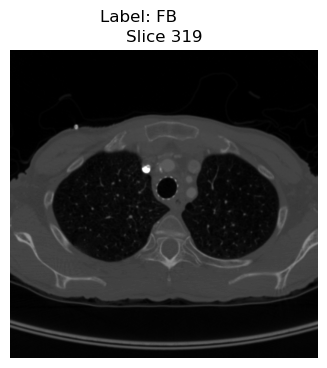

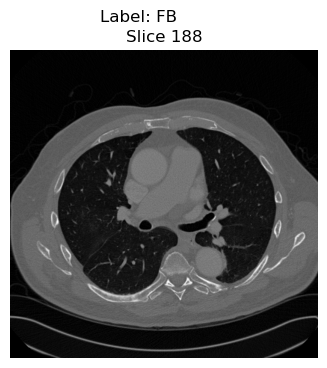

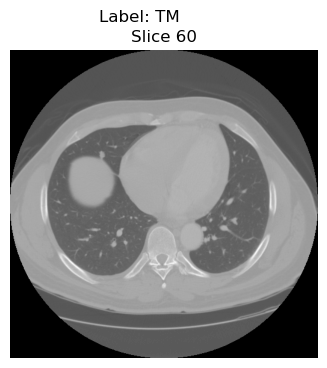

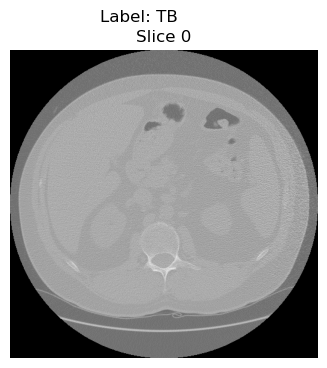

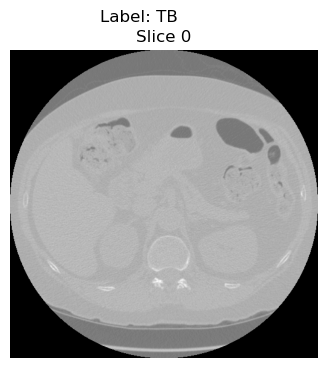

...

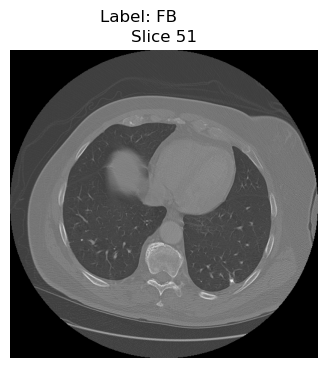

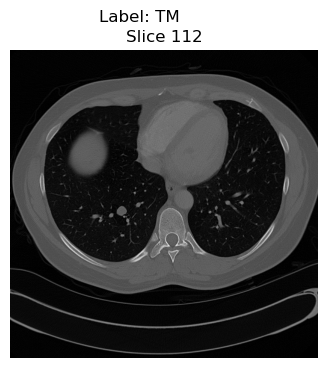

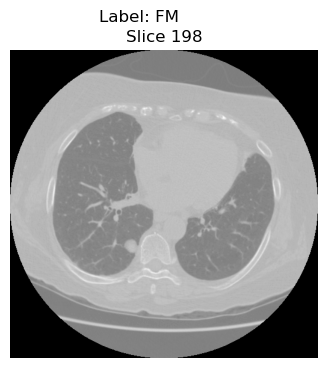

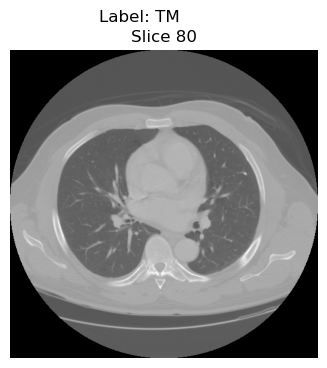

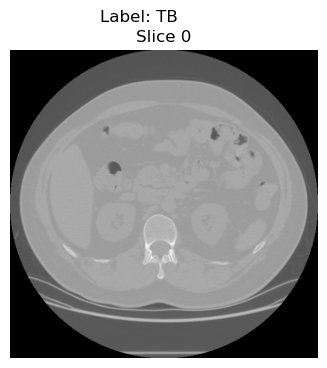

In [96]:
plot_relevant_slices(train_df_ct2, batch_size=5)

In [97]:
def save_relevant_slices_as_jpegs(df, output_folder):
    if not os.path.exists(output_folder):
        os.makedirs(output_folder)

    for index, row in df.iterrows():
        folder_path = row['folder_path']
        relevant_slices = row['slice']
        
        if isinstance(relevant_slices, int):
            relevant_slices = [relevant_slices]
        
        images = load_dicom_images_from_folder(folder_path, relevant_slices)
        
        case_id = row['uuid']
        label = row['type']
        
        for i, img in enumerate(images):
            normalized_img = cv2.normalize(img, None, 0, 255, cv2.NORM_MINMAX)
            img_path = os.path.join(output_folder, f"{case_id}_{label}_slice_{relevant_slices[i]}.jpg")
            cv2.imwrite(img_path, normalized_img.astype(np.uint8)) 
            print(f"Saved {img_path}")


In [98]:
output_folder = "/home/ec2-user/teza-folder/4classes"
save_relevant_slices_as_jpegs(test_df_ct2, output_folder)

Saved /home/ec2-user/teza-folder/4classes/7507_FB_slice_201.jpg
Saved /home/ec2-user/teza-folder/4classes/2592_FB_slice_163.jpg
Saved /home/ec2-user/teza-folder/4classes/2575_TM_slice_141.jpg
Saved /home/ec2-user/teza-folder/4classes/2960_TB_slice_0.jpg
Saved /home/ec2-user/teza-folder/4classes/2220_TM_slice_298.jpg
Saved /home/ec2-user/teza-folder/4classes/2590_FM_slice_92.jpg


In [99]:
dataset_dir = '/home/ec2-user/teza-folder/4classes'

filepaths = []
labels = []

for root, _, files in os.walk(dataset_dir):
    for file in files:
        if file.endswith('.jpg'):
            fpath = os.path.join(root, file)
            # Extract label from filename
            label = file.split('_')[1]
            filepaths.append(fpath)
            labels.append(label)

FSeries = pd.Series(filepaths, name='filepaths')
LSeries = pd.Series(labels, name='labels')
df1 = pd.concat([FSeries, LSeries], axis=1)

In [100]:
train_df_all, tempo_df = train_test_split(df1, train_size=0.7, random_state=42, stratify=df1['labels'])

val_df_all, test_df_all = train_test_split(tempo_df, train_size=0.5, random_state=42, stratify=tempo_df['labels'])

In [101]:
train_df_all.head(100)

,filepaths,labels
154,/home/ec2-user/teza-folder/4classes/9228_FB_sl...,FB
166,/home/ec2-user/teza-folder/4classes/.ipynb_che...,FM
184,/home/ec2-user/teza-folder/4classes/.ipynb_che...,TM
58,/home/ec2-user/teza-folder/4classes/8038_FM_sl...,FM
56,/home/ec2-user/teza-folder/4classes/1860_FM_sl...,FM
...,...,...
137,/home/ec2-user/teza-folder/4classes/4709_FM_sl...,FM
85,/home/ec2-user/teza-folder/4classes/1871_TM_sl...,TM
72,/home/ec2-user/teza-folder/4classes/1452_FM_sl...,FM
103,/home/ec2-user/teza-folder/4classes/1251_FB_sl...,FB


In [102]:
gen1 = ImageDataGenerator(rescale=1./255)

train_generator = gen1.flow_from_dataframe(
    train_df_all,
    x_col='filepaths',
    y_col='labels',
    target_size=(224, 224),
    color_mode='rgb',  
    class_mode='categorical',
    batch_size=2,
    shuffle=True
)

val_generator = gen1.flow_from_dataframe(
    val_df_all,
    x_col='filepaths',
    y_col='labels',
    target_size=(224, 224),
    color_mode='rgb',
    class_mode='categorical',
    batch_size=2,
    shuffle=False
)

test_generator = gen1.flow_from_dataframe(
    test_df_all,
    x_col='filepaths',
    y_col='labels',
    target_size=(224, 224),
    color_mode='rgb',
    class_mode='categorical',
    batch_size=2,
    shuffle=False
)


print(f"Training generator size: {train_generator.samples}")
print(f"Validation generator size: {val_generator.samples}")
print(f"Test generator size: {test_generator.samples}")


Found 133 validated image filenames belonging to 4 classes.
Found 29 validated image filenames belonging to 4 classes.
Found 29 validated image filenames belonging to 4 classes.
Training generator size: 133
Validation generator size: 29
Test generator size: 29


In [103]:
batch_data, batch_labels = next(train_generator)
print(f"Batch data shape: {batch_data.shape}")
print(f"Batch labels shape: {batch_labels.shape}")


Batch data shape: (2, 224, 224, 3)
Batch labels shape: (2, 4)


In [104]:
print(f"DataFrame shape: {df1.shape}")
print(df['labels'].value_counts())

DataFrame shape: (191, 2)
labels
malignant    562
normal       416
beningn      121
Name: count, dtype: int64


In [105]:
unique_labels = train_df_all['labels'].unique()
print(f"Unique labels: {unique_labels}")
num_classes = len(unique_labels)
print(f"Number of classes: {num_classes}")
print(df1['labels'].value_counts())

Unique labels: ['FB' 'FM' 'TM' 'TB']
Number of classes: 4
labels
FB    80
TM    47
FM    44
TB    20
Name: count, dtype: int64


#### CNN

In [106]:
modelcnn_ct = build_2d_cnn((224,224,3), num_classes=4)
modelcnn_ct.compile(optimizer=Adam(learning_rate=0.00001), loss='categorical_crossentropy',  metrics=['accuracy'])

In [107]:
history_cnn_ct = modelcnn_ct.fit(
    train_generator,
    #steps_per_epoch=len(df_train)//batch_size,
    validation_data=val_generator,
    #validation_steps=len(df_val)//batch_size,
    epochs=50,
    #class_weight = train_class_weights
)

Epoch 1/50


/home/ec2-user/anaconda3/lib/python3.11/site-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()
I0000 00:00:1720962470.254671  580885 service.cc:145] XLA service 0x7f8e0c005d10 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
I0000 00:00:1720962470.254731  580885 service.cc:153]   StreamExecutor device (0): Tesla V100-SXM2-16GB, Compute Capability 7.0
2024-07-14 13:07:50.365569: I tensorflow/compiler/mlir/tensorflow/utils/dump_mlir_util.cc:268] disabling MLIR crash reproducer, set env var `MLIR_CRASH_REPRODUCER_DIRECTORY` to enable.
2024-07-14 13:07:50.869176: I external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:465] Loaded cuDNN version 8907


19/64 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - accuracy: 0.3339 - loss: 1.3780

I0000 00:00:1720962474.802593  580885 asm_compiler.cc:369] ptxas warning : Registers are spilled to local memory in function 'input_multiply_reduce_fusion_3', 4 bytes spill stores, 4 bytes spill loads

I0000 00:00:1720962474.811326  580885 device_compiler.h:188] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


64/64 ━━━━━━━━━━━━━━━━━━━━ 11s 37ms/step - accuracy: 0.3883 - loss: 1.3646 - val_accuracy: 0.4074 - val_loss: 1.3746
Epoch 2/50
64/64 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step - accuracy: 0.4644 - loss: 1.3127 - val_accuracy: 0.4074 - val_loss: 1.3559
Epoch 3/50
64/64 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step - accuracy: 0.3960 - loss: 1.2949 - val_accuracy: 0.4074 - val_loss: 1.3255
Epoch 4/50
64/64 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step - accuracy: 0.3846 - loss: 1.2665 - val_accuracy: 0.4074 - val_loss: 1.2936
Epoch 5/50
64/64 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step - accuracy: 0.3761 - loss: 1.2616 - val_accuracy: 0.4074 - val_loss: 1.2679
Epoch 6/50
64/64 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step - accuracy: 0.4256 - loss: 1.2540 - val_accuracy: 0.4074 - val_loss: 1.2291
Epoch 7/50
64/64 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step - accuracy: 0.3989 - loss: 1.2750 - val_accuracy: 0.4074 - val_loss: 1.1678
Epoch 8/50
64/64 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step - accuracy: 0.5485 - loss: 1.1706 - val_accuracy: 0.4815 - val_loss: 1

In [108]:
test_loss_cnn_ct, test_accuracy_cnn_ct = modelcnn_ct.evaluate(test_generator)

14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - accuracy: 0.5435 - loss: 1.0447


/home/ec2-user/anaconda3/lib/python3.11/site-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


In [109]:
label_mapping1={'TM': 0, 'TB': 1, 'FM': 2, 'FB':3}

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 539ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step


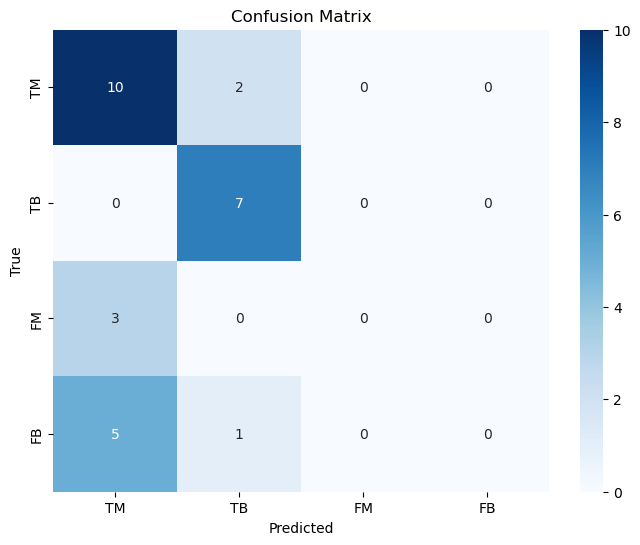

              precision    recall  f1-score   support

           0       0.56      0.83      0.67        12
           1       0.70      1.00      0.82         7
           2       0.00      0.00      0.00         3
           3       0.00      0.00      0.00         6

    accuracy                           0.61        28
   macro avg       0.31      0.46      0.37        28
weighted avg       0.41      0.61      0.49        28



/home/ec2-user/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/ec2-user/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/ec2-user/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [110]:
y_true, y_pred, classes = evaluate_model(modelcnn_ct, test_generator, label_mapping1)

#### VGG19

In [112]:
def build_vgg119_model_ct(input_shape, num_classes):
    base_model = VGG19(weights="imagenet", include_top=False, input_shape=(224, 224,3))

    for layer in base_model.layers:
        layer.trainable = False
    
    x = base_model.output
    #x = Dense(512, activation='relu')(x)
    x = Dense(1024, activation='relu')(x)
    #x = Dropout(0.3)(x) 
    x = GlobalAveragePooling2D()(x)
    output = Dense(num_classes, activation="softmax", name="output")(x)
    model = Model(inputs=base_model.input, outputs=output)
    
    optimizer = Adam(learning_rate=0.0001)
    model.compile(optimizer=optimizer, loss='categorical_crossentropy', metrics=['accuracy'])
    
    return model

In [113]:
input_shape = (224, 224, 3)
num_classes = 4

model_vgg19_ct = build_vgg119_model_ct(input_shape, num_classes)

In [114]:
model_vgg19_ct.summary()

Model: "functional_271"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_36 (InputLayer)     │ (None, 224, 224, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_conv1 (Conv2D)           │ (None, 224, 224, 64)   │         1,792 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_conv2 (Conv2D)           │ (None, 224, 224, 64)   │        36,928 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_pool (MaxPooling2D)      │ (None, 112, 112, 64)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_conv1 (Conv2D)           │ (None, 112, 112, 128)  │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_conv2 (Conv2D)           │ (None, 112, 112, 128)  │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_pool (MaxPooling2D)      │ (None, 56, 56, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv1 (Conv2D)           │ (None, 56, 56, 256)    │       295,168 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv2 (Conv2D)           │ (None, 56, 56, 256)    │       590,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv3 (Conv2D)           │ (None, 56, 56, 256)    │       590,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv4 (Conv2D)           │ (None, 56, 56, 256)    │       590,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_pool (MaxPooling2D)      │ (None, 28, 28, 256)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv1 (Conv2D)           │ (None, 28, 28, 512)    │     1,180,160 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv2 (Conv2D)           │ (None, 28, 28, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv3 (Conv2D)           │ (None, 28, 28, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv4 (Conv2D)           │ (None, 28, 28, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_pool (MaxPooling2D)      │ (None, 14, 14, 512)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv1 (Conv2D)           │ (None, 14, 14, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv2 (Conv2D)           │ (None, 14, 14, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv3 (Conv2D)           │ (None, 14, 14, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv4 (Conv2D)           │ (None, 14, 14, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_pool (MaxPooling2D)      │ (None, 7, 7, 512)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_58 (Dense)                │ (None, 7, 7, 1024)     │       525,312 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_average_pooling2d_34     │ (None, 1024)           │             0 │
│ (GlobalAveragePooling2D)        │                        │               │
├─────────────────────────────────┼────────────────────────┼─────────────

 Total params: 20,553,796 (78.41 MB)

 Trainable params: 529,412 (2.02 MB)

 Non-trainable params: 20,024,384 (76.39 MB)

In [115]:
history_vgg19_ct = model_vgg19_ct.fit(
    train_generator,
    #steps_per_epoch=len(df_train)//batch_size,
    validation_data=val_generator,
    #validation_steps=len(df_val)//batch_size,
    epochs=50,
    #class_weight = train_class_weights
)

Epoch 1/50
57/57 ━━━━━━━━━━━━━━━━━━━━ 4s 33ms/step - accuracy: 0.2873 - loss: 1.3269 - val_accuracy: 0.4400 - val_loss: 1.2079
Epoch 2/50
57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.4489 - loss: 1.2005 - val_accuracy: 0.5200 - val_loss: 1.1730
Epoch 3/50
57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.5136 - loss: 1.1438 - val_accuracy: 0.4400 - val_loss: 1.1398
Epoch 4/50
57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.5064 - loss: 1.0670 - val_accuracy: 0.5600 - val_loss: 1.0734
Epoch 5/50
57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.5978 - loss: 1.0481 - val_accuracy: 0.4800 - val_loss: 1.0260
Epoch 6/50
57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.5589 - loss: 1.0275 - val_accuracy: 0.4400 - val_loss: 1.0572
Epoch 7/50
57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.5876 - loss: 0.9464 - val_accuracy: 0.6800 - val_loss: 0.9907
Epoch 8/50
57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.5539 - loss: 0.9794 - val_accuracy: 0.6800 - val_los

In [116]:
test_loss_vgg19_ct, test_accuracy_vgg19_ct = model_vgg19_ct.evaluate(test_generator)

13/13 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - accuracy: 0.6361 - loss: 0.7883


In [117]:
label_mapping1={'TM': 0, 'TB': 1, 'FM': 2, 'FB':3}

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 765ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 473ms/step


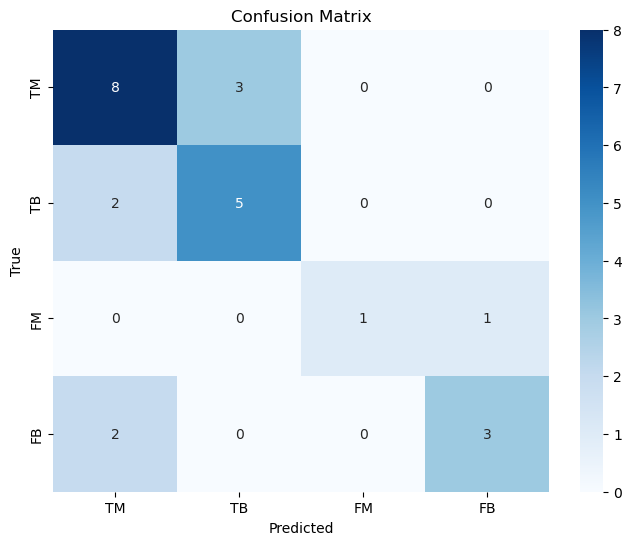

              precision    recall  f1-score   support

           0       0.67      0.73      0.70        11
           1       0.62      0.71      0.67         7
           2       1.00      0.50      0.67         2
           3       0.75      0.60      0.67         5

    accuracy                           0.68        25
   macro avg       0.76      0.64      0.67        25
weighted avg       0.70      0.68      0.68        25



In [118]:
y_true, y_pred, classes = evaluate_model(model_vgg19_ct, test_generator, label_mapping1)

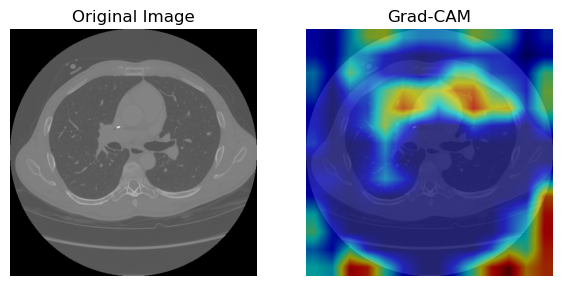

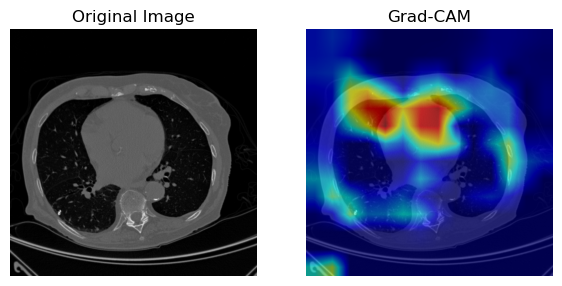

In [119]:

img_path = '/home/ec2-user/teza-folder/4classes/1871_TM_slice_149.jpg'
img_array = get_img_array(img_path, size=(224, 224))
last_conv_layer_name = "block5_conv4"

heatmap = make_gradcam_heatmap(img_array, model_vgg19_ct, last_conv_layer_name)
save_and_display_gradcam(img_path, heatmap)

img_path2 = '/home/ec2-user/teza-folder/4classes/2244_TM_slice_108.jpg' 
img_array2 = get_img_array(img_path2, size=(224, 224))

heatmap2 = make_gradcam_heatmap(img_array2, model_vgg19_ct, last_conv_layer_name)

save_and_display_gradcam(img_path2, heatmap2)

##### Fine tunning VGG 19

In [120]:
def build_vgg119_model_ft(input_shape, num_classes):
    base_model = VGG19(weights="imagenet", include_top=False, input_shape=(224, 224,3))
    
    for layer in base_model.layers[-8:]:
        if not isinstance(layer, Dense):
            layer.trainable = True
    
    x = base_model.output
    x = GlobalAveragePooling2D()(x)
   # x = Dense(512, activation='relu')(x)
    x = Dense(1024, activation='relu')(x)
   # x = Dropout(0.3)(x) 
    output = Dense(num_classes, activation="softmax", name="output")(x)
    model = Model(inputs=base_model.input, outputs=output)
    
    optimizer = Adam(learning_rate=0.0001)
    model.compile(optimizer=optimizer, loss='categorical_crossentropy', metrics=['accuracy'])
    
    return model

In [121]:
input_shape = (224, 224, 3)
num_classes = 4

model_vgg19_ft = build_vgg119_model_ft(input_shape, num_classes)

In [122]:
model_vgg19_ft.summary()

Model: "functional_33"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_28 (InputLayer)     │ (None, 224, 224, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_conv1 (Conv2D)           │ (None, 224, 224, 64)   │         1,792 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_conv2 (Conv2D)           │ (None, 224, 224, 64)   │        36,928 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_pool (MaxPooling2D)      │ (None, 112, 112, 64)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_conv1 (Conv2D)           │ (None, 112, 112, 128)  │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_conv2 (Conv2D)           │ (None, 112, 112, 128)  │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_pool (MaxPooling2D)      │ (None, 56, 56, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv1 (Conv2D)           │ (None, 56, 56, 256)    │       295,168 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv2 (Conv2D)           │ (None, 56, 56, 256)    │       590,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv3 (Conv2D)           │ (None, 56, 56, 256)    │       590,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv4 (Conv2D)           │ (None, 56, 56, 256)    │       590,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_pool (MaxPooling2D)      │ (None, 28, 28, 256)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv1 (Conv2D)           │ (None, 28, 28, 512)    │     1,180,160 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv2 (Conv2D)           │ (None, 28, 28, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv3 (Conv2D)           │ (None, 28, 28, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv4 (Conv2D)           │ (None, 28, 28, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_pool (MaxPooling2D)      │ (None, 14, 14, 512)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv1 (Conv2D)           │ (None, 14, 14, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv2 (Conv2D)           │ (None, 14, 14, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv3 (Conv2D)           │ (None, 14, 14, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv4 (Conv2D)           │ (None, 14, 14, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_pool (MaxPooling2D)      │ (None, 7, 7, 512)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_average_pooling2d_27     │ (None, 512)            │             0 │
│ (GlobalAveragePooling2D)        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_34 (Dense)                │ (None, 1024)           │       525,312 │
├─────────────────────────────────┼────────────────────────┼─────────────

 Total params: 20,553,796 (78.41 MB)

 Trainable params: 20,553,796 (78.41 MB)

 Non-trainable params: 0 (0.00 B)

In [123]:
history_vgg19_ct = model_vgg19_ft.fit(
    train_generator,
    #steps_per_epoch=len(df_train)//batch_size,
    validation_data=val_generator,
    #validation_steps=len(df_val)//batch_size,
    epochs=50,
    #class_weight = train_class_weights
)

Epoch 1/50
 7/57 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.4643 - loss: 1.2744

I0000 00:00:1720283779.312617  103059 asm_compiler.cc:369] ptxas warning : Registers are spilled to local memory in function 'input_reduce_select_fusion_13', 196 bytes spill stores, 196 bytes spill loads



57/57 ━━━━━━━━━━━━━━━━━━━━ 10s 41ms/step - accuracy: 0.4038 - loss: 1.3243 - val_accuracy: 0.4400 - val_loss: 1.2537
Epoch 2/50
57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 22ms/step - accuracy: 0.3813 - loss: 1.3490 - val_accuracy: 0.4400 - val_loss: 1.2858
Epoch 3/50
57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 22ms/step - accuracy: 0.4237 - loss: 1.3660 - val_accuracy: 0.4400 - val_loss: 1.2528
Epoch 4/50
57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 22ms/step - accuracy: 0.4009 - loss: 1.3106 - val_accuracy: 0.4400 - val_loss: 1.2435
Epoch 5/50
57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 22ms/step - accuracy: 0.4659 - loss: 1.2528 - val_accuracy: 0.4400 - val_loss: 1.2419
Epoch 6/50
57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 22ms/step - accuracy: 0.4041 - loss: 1.2582 - val_accuracy: 0.4400 - val_loss: 1.2919
Epoch 7/50
57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 22ms/step - accuracy: 0.4002 - loss: 1.3589 - val_accuracy: 0.4400 - val_loss: 1.2517
Epoch 8/50
57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 22ms/step - accuracy: 0.4103 - loss: 1.3302 - val_accuracy: 0.4400 - val_loss: 1

In [124]:
test_loss_vgg19_ct, test_accuracy_vgg19_ct = model_vgg19_ft.evaluate(test_generator)


13/13 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - accuracy: 0.4861 - loss: 1.2610   


#### Inception V3

In [127]:
def build_inception_ct(input_shape, num_classes):
    base_model = InceptionV3(weights="imagenet", include_top=False, input_shape=(224, 224,3))

    for layer in base_model.layers:
        layer.trainable = False
    
    x = base_model.output
    x = GlobalAveragePooling2D()(x)

   # x = Dense(512, activation='relu')(x)
 
    x = Dense(1024, activation='relu')(x)
   # x = Dropout(0.3)(x) 
    output = Dense(num_classes, activation="softmax", name="output")(x)
    model = Model(inputs=base_model.input, outputs=output)
    
    optimizer = Adam(learning_rate=0.0001)
    model.compile(optimizer=optimizer, loss='categorical_crossentropy', metrics=['accuracy'])
    
    return model

In [128]:
input_shape = (224, 224, 3)
num_classes = 4

inception_ct = build_inception_ct(input_shape, num_classes)

In [129]:
inception_ct.summary()

Model: "functional_277"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_37      │ (None, 224, 224,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_658 (Conv2D) │ (None, 111, 111,  │        864 │ input_layer_37[0… │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 111, 111,  │         96 │ conv2d_658[0][0]  │
│ (BatchNormalizatio… │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_838      │ (None, 111, 111,  │          0 │ batch_normalizat… │
│ (Activation)        │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_659 (Conv2D) │ (None, 109, 109,  │      9,216 │ activation_838[0… │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 109, 109,  │         96 │ conv2d_659[0][0]  │
│ (BatchNormalizatio… │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_839      │ (None, 109, 109,  │          0 │ batch_normalizat… │
│ (Activation)        │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_660 (Conv2D) │ (None, 109, 109,  │     18,432 │ activation_839[0… │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 109, 109,  │        192 │ conv2d_660[0][0]  │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_840      │ (None, 109, 109,  │          0 │ batch_normalizat… │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d_28    │ (None, 54, 54,    │          0 │ activation_840[0… │
│ (MaxPooling2D)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_661 (Conv2D) │ (None, 54, 54,    │      5,120 │ max_pooling2d_28… │
│                     │ 80)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 54, 54,    │        240 │ conv2d_661[0][0]  │
│ (BatchNormalizatio… │ 80)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_841      │ (None, 54, 54,    │          0 │ batch_normalizat… │
│ (Activation)        │ 80)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_662 (Conv2D) │ (None, 52, 52,    │    138,240 │ activation_841[0… │
│                     │ 192)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 52, 52,    │        576 │ conv2d_662[0][0]  │
│ (BatchNormalizatio… │ 192)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_842      │ (None, 52, 52,    │          0 │ batch_normalizat

 Total params: 23,905,060 (91.19 MB)

 Trainable params: 2,102,276 (8.02 MB)

 Non-trainable params: 21,802,784 (83.17 MB)

In [130]:
history_inception_ct = inception_ct.fit(
    train_generator,
    #steps_per_epoch=len(df_train)//batch_size,
    validation_data=val_generator,
    #validation_steps=len(df_val)//batch_size,
    epochs=50,
    #class_weight = train_class_weights
)

Epoch 1/50
57/57 ━━━━━━━━━━━━━━━━━━━━ 21s 140ms/step - accuracy: 0.4466 - loss: 1.7010 - val_accuracy: 0.6800 - val_loss: 0.8962
Epoch 2/50
57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 13ms/step - accuracy: 0.7562 - loss: 0.6686 - val_accuracy: 0.6800 - val_loss: 0.7848
Epoch 3/50
57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 13ms/step - accuracy: 0.7953 - loss: 0.4986 - val_accuracy: 0.6800 - val_loss: 0.8128
Epoch 4/50
57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 13ms/step - accuracy: 0.9391 - loss: 0.2549 - val_accuracy: 0.6400 - val_loss: 0.8620
Epoch 5/50
57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 13ms/step - accuracy: 0.9652 - loss: 0.2159 - val_accuracy: 0.6400 - val_loss: 0.8663
Epoch 6/50
57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 13ms/step - accuracy: 0.9644 - loss: 0.1627 - val_accuracy: 0.6800 - val_loss: 0.8143
Epoch 7/50
57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 13ms/step - accuracy: 0.9789 - loss: 0.1382 - val_accuracy: 0.6800 - val_loss: 0.8421
Epoch 8/50
57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 13ms/step - accuracy: 0.9727 - loss: 0.1468 - val_accuracy: 0.6800 -

In [131]:
test_loss_inc_ct, test_accuracy_inc_ct = inception_ct.evaluate(test_generator)

13/13 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - accuracy: 0.4925 - loss: 2.3191  


1/1 ━━━━━━━━━━━━━━━━━━━━ 5s 5s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 5s 5s/step


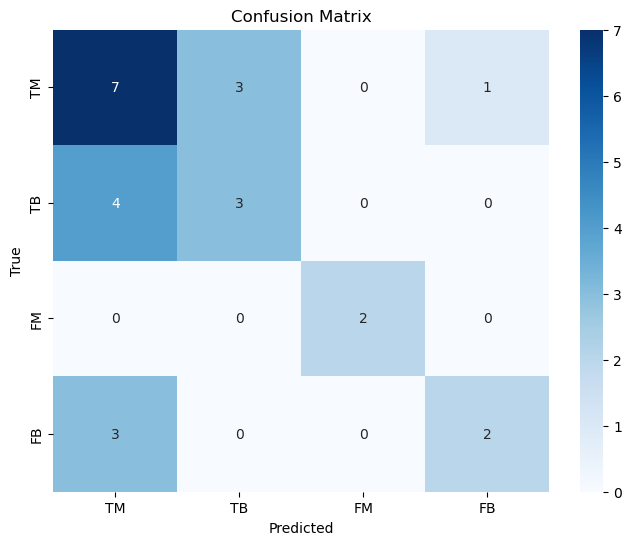

              precision    recall  f1-score   support

           0       0.50      0.64      0.56        11
           1       0.50      0.43      0.46         7
           2       1.00      1.00      1.00         2
           3       0.67      0.40      0.50         5

    accuracy                           0.56        25
   macro avg       0.67      0.62      0.63        25
weighted avg       0.57      0.56      0.56        25



In [132]:
y_true, y_pred, classes = evaluate_model(inception_ct, test_generator, label_mapping1)

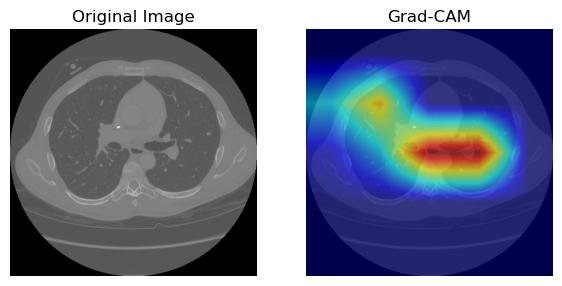

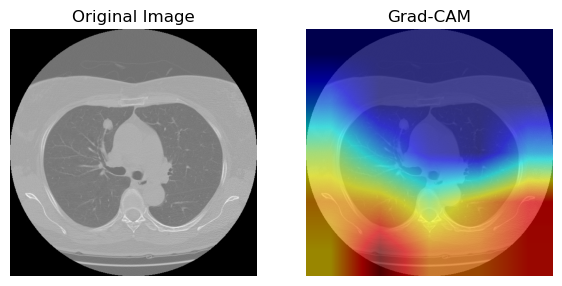

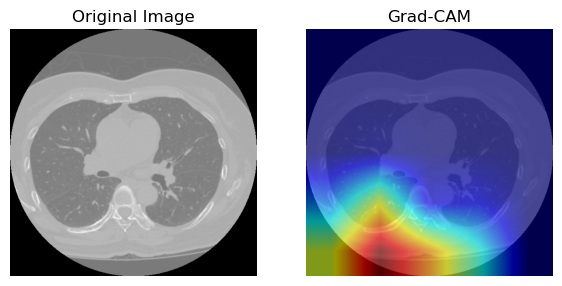

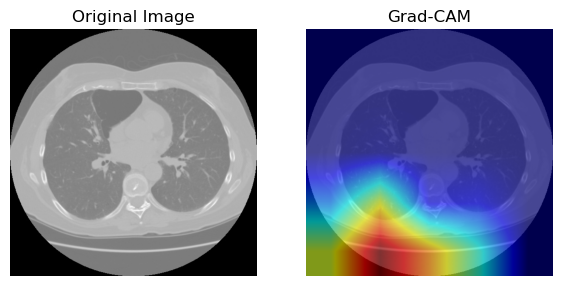

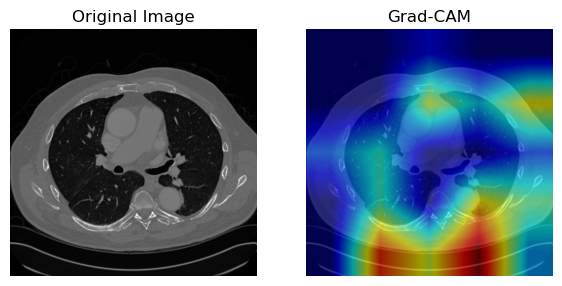

In [133]:

img_path = '/home/ec2-user/teza-folder/4classes/1871_TM_slice_149.jpg'
img_array = get_img_array(img_path, size=(224, 224))
last_conv_layer_name = "mixed10"

heatmap = make_gradcam_heatmap(img_array, inception_ct, last_conv_layer_name)
save_and_display_gradcam(img_path, heatmap)

img_path1 = '/home/ec2-user/teza-folder/4classes/1937_FM_slice_82.jpg' 
img_array1 = get_img_array(img_path1, size=(224, 224))

heatmap1 = make_gradcam_heatmap(img_array1,inception_ct, last_conv_layer_name)
save_and_display_gradcam(img_path1, heatmap1)

img_path2 = '/home/ec2-user/teza-folder/4classes/3251_FB_slice_304.jpg' 
img_array2 = get_img_array(img_path2, size=(224, 224))

heatmap2 = make_gradcam_heatmap(img_array2, inception_ct, last_conv_layer_name)

save_and_display_gradcam(img_path2, heatmap2)
img_path3 = '/home/ec2-user/teza-folder/4classes/2997_FB_slice_70.jpg' 
img_array3 = get_img_array(img_path2, size=(224, 224))

heatmap3 = make_gradcam_heatmap(img_array3, inception_ct, last_conv_layer_name)

save_and_display_gradcam(img_path3, heatmap3)

img_path4 = '/home/ec2-user/teza-folder/4classes/1251_FB_slice_188.jpg' 
img_array4 = get_img_array(img_path4, size=(224, 224))

heatmap4 = make_gradcam_heatmap(img_array4, inception_ct, last_conv_layer_name)

save_and_display_gradcam(img_path4, heatmap4)

#### ResNet50

In [134]:
def build_resnet_ct(input_shape, num_classes):
    base_model = ResNet50(weights="imagenet", include_top=False, input_shape=(224, 224,3))

    for layer in base_model.layers:
        layer.trainable = False
    
    x = base_model.output
    x = GlobalAveragePooling2D()(x)
   # x = Dense(512, activation='relu')(x)
    x = Dense(1024, activation='relu')(x)
   # x = Dropout(0.3)(x) 
    output = Dense(num_classes, activation="sigmoid", name="output")(x)
    model = Model(inputs=base_model.input, outputs=output)
    
    optimizer = Adam(learning_rate=0.0001)
    model.compile(optimizer=optimizer, loss='binary_crossentropy', metrics=['accuracy'])
    
    return model

In [135]:
input_shape = (224, 224, 3)
num_classes = 4

model_resnet_ct = build_resnet_ct(input_shape, num_classes)

In [136]:
model_resnet_ct.summary()

Model: "functional_283"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_38      │ (None, 224, 224,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_pad           │ (None, 230, 230,  │          0 │ input_layer_38[0… │
│ (ZeroPadding2D)     │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_conv (Conv2D) │ (None, 112, 112,  │      9,472 │ conv1_pad[0][0]   │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_bn            │ (None, 112, 112,  │        256 │ conv1_conv[0][0]  │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_relu          │ (None, 112, 112,  │          0 │ conv1_bn[0][0]    │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool1_pad           │ (None, 114, 114,  │          0 │ conv1_relu[0][0]  │
│ (ZeroPadding2D)     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool1_pool          │ (None, 56, 56,    │          0 │ pool1_pad[0][0]   │
│ (MaxPooling2D)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_conv │ (None, 56, 56,    │      4,160 │ pool1_pool[0][0]  │
│ (Conv2D)            │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_bn   │ (None, 56, 56,    │        256 │ conv2_block1_1_c… │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_relu │ (None, 56, 56,    │          0 │ conv2_block1_1_b… │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_2_conv │ (None, 56, 56,    │     36,928 │ conv2_block1_1_r… │
│ (Conv2D)            │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_2_bn   │ (None, 56, 56,    │        256 │ conv2_block1_2_c… │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_2_relu │ (None, 56, 56,    │          0 │ conv2_block1_2_b… │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_0_conv │ (None, 56, 56,    │     16,640 │ pool1_pool[0][0]  │
│ (Conv2D)            │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_3_conv │ (None, 56, 56,    │     16,640 │ conv2_block1_2_r… │
│ (Conv2D)            │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_0_bn   │ (None, 56, 56,    │      1,024 │ conv2_block1_0_c… │
│ (BatchNormalizatio… │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_3_bn   │ (None, 56, 56,    │      1,024 │ conv2_block1_3_c

 Total params: 25,689,988 (98.00 MB)

 Trainable params: 2,102,276 (8.02 MB)

 Non-trainable params: 23,587,712 (89.98 MB)

In [137]:
history_resnet_ct = model_resnet_ct.fit(
    train_generator,
    #steps_per_epoch=len(df_train)//batch_size,
    validation_data=val_generator,
    #validation_steps=len(df_val)//batch_size,
    epochs=50,
    #class_weight = train_class_weights
)

Epoch 1/50
57/57 ━━━━━━━━━━━━━━━━━━━━ 15s 95ms/step - accuracy: 0.3413 - loss: 0.6046 - val_accuracy: 0.4400 - val_loss: 0.5140
Epoch 2/50
57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.4711 - loss: 0.5105 - val_accuracy: 0.4400 - val_loss: 0.5067
Epoch 3/50
57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.4995 - loss: 0.5047 - val_accuracy: 0.2400 - val_loss: 0.5173
Epoch 4/50
57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.3124 - loss: 0.5235 - val_accuracy: 0.4400 - val_loss: 0.5181
Epoch 5/50
57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.3820 - loss: 0.5237 - val_accuracy: 0.4400 - val_loss: 0.5140
Epoch 6/50
57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.4286 - loss: 0.5275 - val_accuracy: 0.4400 - val_loss: 0.4888
Epoch 7/50
57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step - accuracy: 0.4406 - loss: 0.5253 - val_accuracy: 0.6400 - val_loss: 0.4831
Epoch 8/50
57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step - accuracy: 0.5627 - loss: 0.4906 - val_accuracy: 0.5200 - 

In [138]:
test_loss_res_ct, test_accuracy_res_ct = model_resnet_ct.evaluate(test_generator)

13/13 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - accuracy: 0.3685 - loss: 0.4967   


1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step


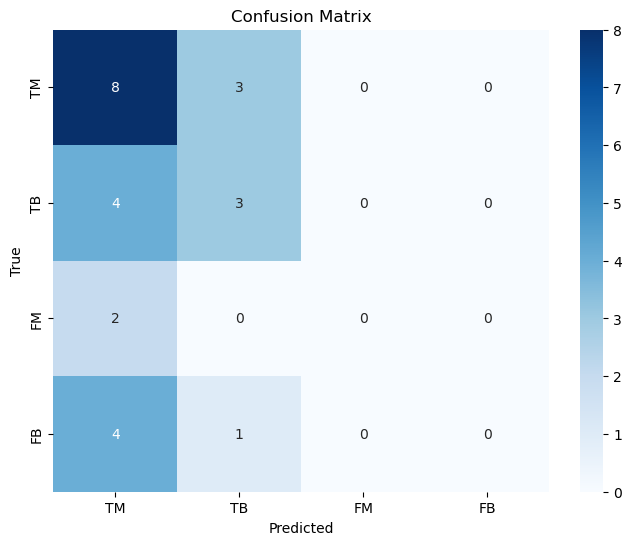

              precision    recall  f1-score   support

           0       0.44      0.73      0.55        11
           1       0.43      0.43      0.43         7
           2       0.00      0.00      0.00         2
           3       0.00      0.00      0.00         5

    accuracy                           0.44        25
   macro avg       0.22      0.29      0.25        25
weighted avg       0.32      0.44      0.36        25



/home/ec2-user/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/ec2-user/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/ec2-user/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [139]:
y_true, y_pred, classes = evaluate_model(model_resnet_ct, test_generator, label_mapping1)

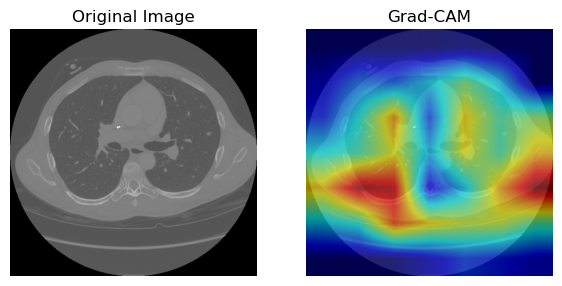

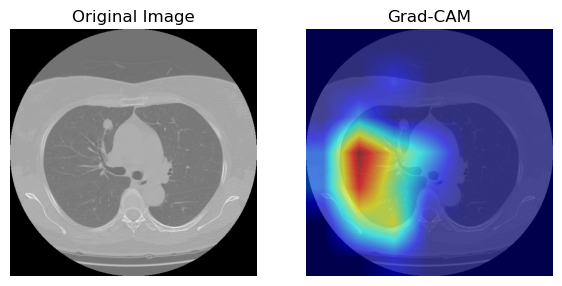

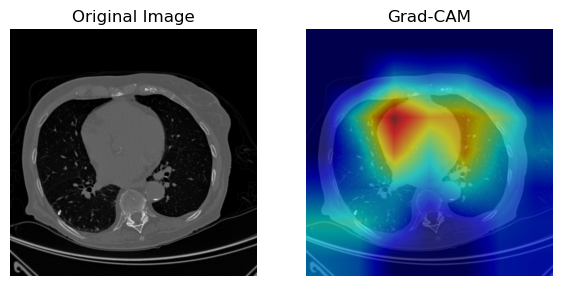

In [140]:

img_path = '/home/ec2-user/teza-folder/4classes/1871_TM_slice_149.jpg'
img_array = get_img_array(img_path, size=(224, 224))
last_conv_layer_name = "conv5_block3_3_conv"

heatmap = make_gradcam_heatmap(img_array, model_resnet_ct, last_conv_layer_name)
save_and_display_gradcam(img_path, heatmap)

img_path1 = '/home/ec2-user/teza-folder/4classes/1937_FM_slice_82.jpg' 
img_array1 = get_img_array(img_path1, size=(224, 224))

heatmap1 = make_gradcam_heatmap(img_array1,model_resnet_ct, last_conv_layer_name)
save_and_display_gradcam(img_path1, heatmap1)

img_path2 = '/home/ec2-user/teza-folder/4classes/2244_TM_slice_108.jpg' 
img_array2 = get_img_array(img_path2, size=(224, 224))

heatmap2 = make_gradcam_heatmap(img_array2, model_resnet_ct, last_conv_layer_name)

save_and_display_gradcam(img_path2, heatmap2)

#### MobileNetV3Large

In [141]:
def build_mobilenet_ct(input_shape, num_classes):
    base_model = MobileNetV3Large(weights="imagenet", include_top=False, input_shape=(224, 224,3))

    for layer in base_model.layers:
        layer.trainable = False
    
    x = base_model.output
    x = GlobalAveragePooling2D()(x)
   # x = Dense(512, activation='relu')(x)
    x = Dense(1024, activation='relu')(x)
   # x = Dropout(0.3)(x) 
    output = Dense(num_classes, activation="sigmoid", name="output")(x)
    model = Model(inputs=base_model.input, outputs=output)
    
    optimizer = Adam(learning_rate=0.0001)
    model.compile(optimizer=optimizer, loss='binary_crossentropy', metrics=['accuracy'])
    
    return model

In [142]:
input_shape = (224, 224, 3)
num_classes = 4

mob = build_mobilenet_ct(input_shape, num_classes)

In [143]:
mob.summary()

Model: "functional_287"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_39      │ (None, 224, 224,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ rescaling_9         │ (None, 224, 224,  │          0 │ input_layer_39[0… │
│ (Rescaling)         │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv (Conv2D)       │ (None, 112, 112,  │        432 │ rescaling_9[0][0] │
│                     │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv_bn             │ (None, 112, 112,  │         64 │ conv[0][0]        │
│ (BatchNormalizatio… │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_932      │ (None, 112, 112,  │          0 │ conv_bn[0][0]     │
│ (Activation)        │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_dept… │ (None, 112, 112,  │        144 │ activation_932[0… │
│ (DepthwiseConv2D)   │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_dept… │ (None, 112, 112,  │         64 │ expanded_conv_de… │
│ (BatchNormalizatio… │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ re_lu_171 (ReLU)    │ (None, 112, 112,  │          0 │ expanded_conv_de… │
│                     │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_proj… │ (None, 112, 112,  │        256 │ re_lu_171[0][0]   │
│ (Conv2D)            │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_proj… │ (None, 112, 112,  │         64 │ expanded_conv_pr… │
│ (BatchNormalizatio… │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_add   │ (None, 112, 112,  │          0 │ activation_932[0… │
│ (Add)               │ 16)               │            │ expanded_conv_pr… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_1_ex… │ (None, 112, 112,  │      1,024 │ expanded_conv_ad… │
│ (Conv2D)            │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_1_ex… │ (None, 112, 112,  │        256 │ expanded_conv_1_… │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ re_lu_172 (ReLU)    │ (None, 112, 112,  │          0 │ expanded_conv_1_… │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_1_de… │ (None, 113, 113,  │          0 │ re_lu_172[0][0]   │
│ (ZeroPadding2D)     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_1_de… │ (None, 56, 56,    │        576 │ expanded_conv_1_… │
│ (DepthwiseConv2D)   │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_1_de… │ (None, 56, 56,    │        256 │ expanded_conv_1_

 Total params: 3,984,516 (15.20 MB)

 Trainable params: 988,164 (3.77 MB)

 Non-trainable params: 2,996,352 (11.43 MB)

In [144]:
history_mob = mob.fit(
    train_generator,
    #steps_per_epoch=len(df_train)//batch_size,
    validation_data=val_generator,
    #validation_steps=len(df_val)//batch_size,
    epochs=50,
    #class_weight = train_class_weights
)

Epoch 1/50
57/57 ━━━━━━━━━━━━━━━━━━━━ 14s 98ms/step - accuracy: 0.3945 - loss: 0.6119 - val_accuracy: 0.4400 - val_loss: 0.5154
Epoch 2/50
57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.4894 - loss: 0.5047 - val_accuracy: 0.4400 - val_loss: 0.5128
Epoch 3/50
57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.4288 - loss: 0.5259 - val_accuracy: 0.4400 - val_loss: 0.5073
Epoch 4/50
57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.4103 - loss: 0.5172 - val_accuracy: 0.4400 - val_loss: 0.5020
Epoch 5/50
57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.4232 - loss: 0.5168 - val_accuracy: 0.5200 - val_loss: 0.4970
Epoch 6/50
57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.3937 - loss: 0.5159 - val_accuracy: 0.4400 - val_loss: 0.4933
Epoch 7/50
57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.4127 - loss: 0.5199 - val_accuracy: 0.5200 - val_loss: 0.4876
Epoch 8/50
57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.4348 - loss: 0.5137 - val_accuracy: 0.6000 - val

In [145]:
test_loss_mob_ct, test_accuracy_mob_ct = mob.evaluate(test_generator)

13/13 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - accuracy: 0.3897 - loss: 0.5506   


1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step


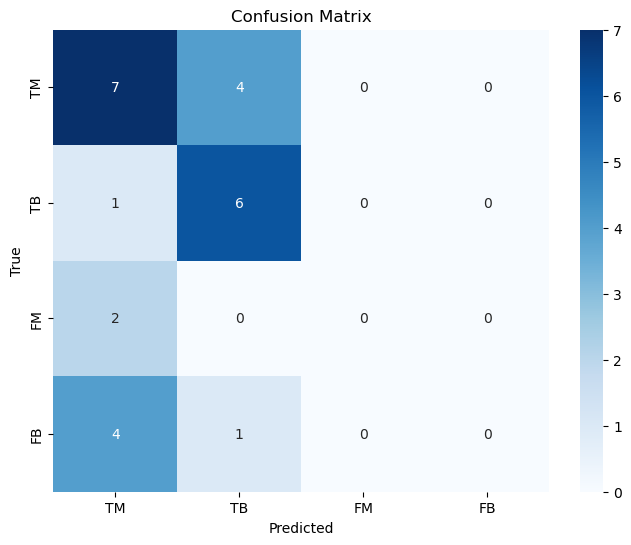

              precision    recall  f1-score   support

           0       0.50      0.64      0.56        11
           1       0.55      0.86      0.67         7
           2       0.00      0.00      0.00         2
           3       0.00      0.00      0.00         5

    accuracy                           0.52        25
   macro avg       0.26      0.37      0.31        25
weighted avg       0.37      0.52      0.43        25



/home/ec2-user/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/ec2-user/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/ec2-user/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [146]:
y_true, y_pred, classes = evaluate_model(mob, test_generator, label_mapping1)

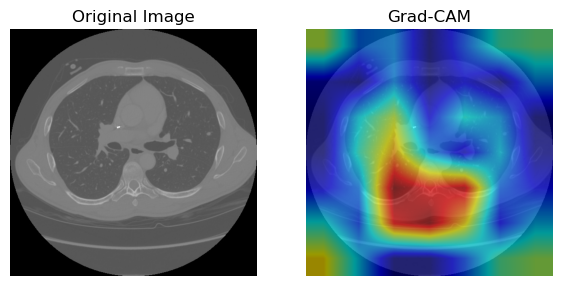

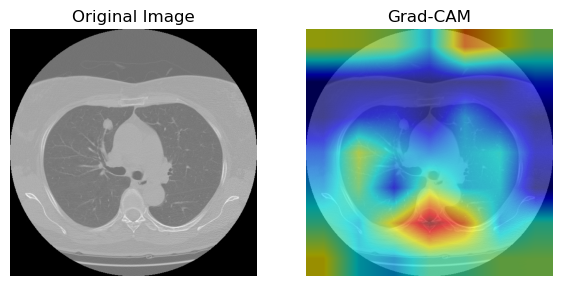

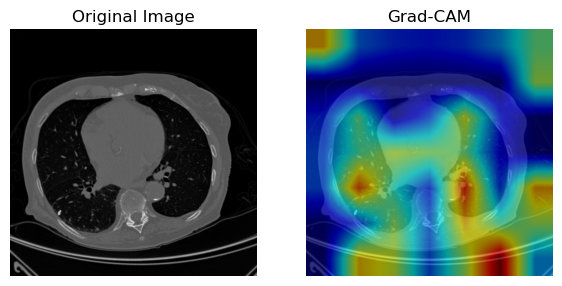

In [147]:

img_path = '/home/ec2-user/teza-folder/4classes/1871_TM_slice_149.jpg'
img_array = get_img_array(img_path, size=(224, 224))
last_conv_layer_name = "activation_951"

heatmap = make_gradcam_heatmap(img_array, mob, last_conv_layer_name)
save_and_display_gradcam(img_path, heatmap)

img_path1 = '/home/ec2-user/teza-folder/4classes/1937_FM_slice_82.jpg' 
img_array1 = get_img_array(img_path1, size=(224, 224))

heatmap1 = make_gradcam_heatmap(img_array1,mob, last_conv_layer_name)
save_and_display_gradcam(img_path1, heatmap1)

img_path2 = '/home/ec2-user/teza-folder/4classes/2244_TM_slice_108.jpg' 
img_array2 = get_img_array(img_path2, size=(224, 224))

heatmap2 = make_gradcam_heatmap(img_array2, mob, last_conv_layer_name)

save_and_display_gradcam(img_path2, heatmap2)

#### Transfer Learning 

#### CNN

In [148]:
def build_2d_cnn(input_shape, num_classes):
    inputs = Input(shape=input_shape)

    x = Conv2D(64, (3, 3), padding='same')(inputs)
    x = Activation('relu')(x)
    x = BatchNormalization()(x)
    x = MaxPooling2D(pool_size=(2, 2), strides=(2, 2), padding='same')(x)

    x = Conv2D(128, (3, 3), padding='same')(x)
    x = Activation('relu')(x)
    x = BatchNormalization()(x)
    x = MaxPooling2D(pool_size=(2, 2), strides=(2, 2), padding='same')(x)

    x = Conv2D(256, (3, 3), padding='same')(x)
    x = Activation('relu')(x)
    x = BatchNormalization()(x)
    x = MaxPooling2D(pool_size=(2, 2), strides=(2, 2), padding='same')(x)

    x = Conv2DTranspose(256, (3, 3), strides=(2, 2), padding='same')(x)
    x = Activation('relu')(x)
    x = BatchNormalization()(x)

    x = Conv2DTranspose(128, (3, 3), strides=(2, 2), padding='same')(x)
    x = Activation('relu')(x)
    x = BatchNormalization()(x)

    x = Conv2DTranspose(64, (3, 3), strides=(2, 2), padding='same')(x)
    x = Activation('relu')(x)
    x = BatchNormalization()(x)

    x = Conv2D(num_classes, (1, 1), padding='same')(x)
    x = Activation('softmax')(x)

    outputs = GlobalAveragePooling2D()(x)

    model = Model(inputs=inputs, outputs=outputs)
    
    return model


In [149]:
modelcnn_ct1 = build_2d_cnn((224,224,3), num_classes=3)
modelcnn_ct1.compile(optimizer=Adam(learning_rate=0.0001), loss='categorical_crossentropy',  metrics=['accuracy'])

In [150]:
history_cnn1_ct = modelcnn_ct1.fit(
    train_gen,
    #steps_per_epoch=len(df_train)//batch_size,
    validation_data=val_gen,
    #validation_steps=len(df_val)//batch_size,
    epochs=50,
    #class_weight = train_class_weights
)

Epoch 1/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 13s 17ms/step - accuracy: 0.9412 - loss: 0.1858 - val_accuracy: 0.7256 - val_loss: 0.5502
Epoch 2/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 6s 16ms/step - accuracy: 0.9631 - loss: 0.1590 - val_accuracy: 0.5366 - val_loss: 0.8364
Epoch 3/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 6s 15ms/step - accuracy: 0.9452 - loss: 0.1847 - val_accuracy: 0.8171 - val_loss: 0.5070
Epoch 4/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 6s 15ms/step - accuracy: 0.9704 - loss: 0.1446 - val_accuracy: 0.8476 - val_loss: 0.4426
Epoch 5/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 6s 15ms/step - accuracy: 0.9681 - loss: 0.1418 - val_accuracy: 0.5793 - val_loss: 0.6768
Epoch 6/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 6s 15ms/step - accuracy: 0.9353 - loss: 0.2141 - val_accuracy: 0.7744 - val_loss: 0.5435
Epoch 7/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 6s 15ms/step - accuracy: 0.9671 - loss: 0.1316 - val_accuracy: 0.8354 - val_loss: 0.5966
Epoch 8/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 6s 15ms/step - accuracy: 0.9683 - loss: 0.1476 - val_acc

In [151]:
modelcnn_ct1.save('/home/ec2-user/teza-folder/models/cnn_ct.h5')
modelcnn_ct1.save_weights('/home/ec2-user/teza-folder/models/cnn_ct.weights.h5')

In [152]:
input_shape=(224,224,3)
num_classes = 4

In [153]:
new_model_cnn = load_model('/home/ec2-user/teza-folder/models/cnn_ct.h5')
#new_model_cnn.load_weights('models_weights/cnn.weights.h5')

x = new_model_cnn.layers[-4].output
output = Conv2D(4, (1, 1), padding='same', activation='softmax')(x)
output = GlobalAveragePooling2D()(output)
new_model_cnn = Model(inputs=new_model_cnn.input, outputs=output)
#new_model_cnn.summary()

In [154]:
optimizer = Adam(learning_rate=0.0001)
new_model_cnn.compile(optimizer=optimizer, loss='categorical_crossentropy', metrics=['accuracy'])


In [155]:
history_cnn_ct_ltp2 = new_model_cnn.fit(
    train_generator,
    #steps_per_epoch=len(df_train)//batch_size,
    validation_data=val_generator,
    #validation_steps=len(df_val)//batch_size,
    epochs=50,
    #class_weight = train_class_weights
)

Epoch 1/50
67/67 ━━━━━━━━━━━━━━━━━━━━ 10s 54ms/step - accuracy: 0.2888 - loss: 1.3644 - val_accuracy: 0.4138 - val_loss: 1.3149
Epoch 2/50
67/67 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.5189 - loss: 1.1873 - val_accuracy: 0.4138 - val_loss: 1.3356
Epoch 3/50
67/67 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.4666 - loss: 1.2051 - val_accuracy: 0.4138 - val_loss: 1.3789
Epoch 4/50
67/67 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.3567 - loss: 1.2040 - val_accuracy: 0.4138 - val_loss: 1.5845
Epoch 5/50
67/67 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.5366 - loss: 1.1312 - val_accuracy: 0.4138 - val_loss: 1.6983
Epoch 6/50
67/67 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.5147 - loss: 1.1084 - val_accuracy: 0.4138 - val_loss: 1.5565
Epoch 7/50
67/67 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.5604 - loss: 1.1027 - val_accuracy: 0.4138 - val_loss: 1.5854
Epoch 8/50
67/67 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.5402 - loss: 1.0597 - val_accuracy: 0.4138 - 

In [156]:
test_loss_cnn_ct, test_accuracy_cnn_ct = new_model_cnn.evaluate(test_generator)

15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - accuracy: 0.7422 - loss: 0.8903


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 476ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 498ms/step


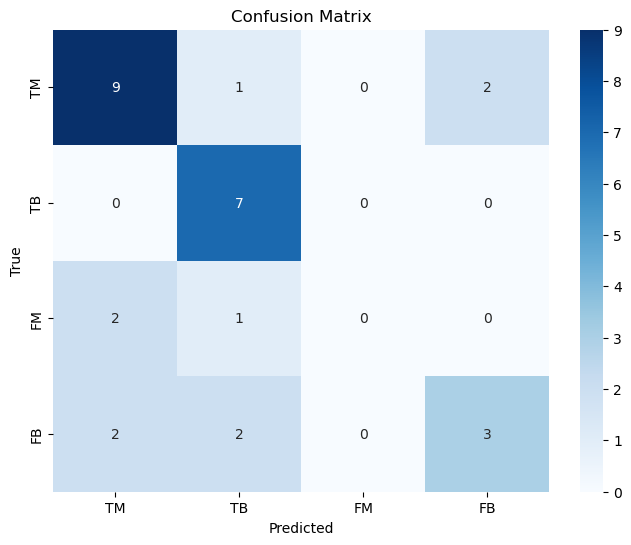

              precision    recall  f1-score   support

           0       0.69      0.75      0.72        12
           1       0.64      1.00      0.78         7
           2       0.00      0.00      0.00         3
           3       0.60      0.43      0.50         7

    accuracy                           0.66        29
   macro avg       0.48      0.54      0.50        29
weighted avg       0.58      0.66      0.61        29



/home/ec2-user/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/ec2-user/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/ec2-user/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [157]:
_true, y_pred, classes = evaluate_model(new_model_cnn, test_generator, label_mapping1)

#### VGG19

In [158]:
def build_vgg119_model_ct_lt(input_shape, num_classes):
    base_model = VGG19( include_top=False, input_shape=(224, 224,3))

    for layer in base_model.layers:
        layer.trainable = False
    
    x = base_model.output
    #x = Dense(512, activation='relu')(x)
    x = Dense(1024, activation='relu')(x)
    #x = Dropout(0.3)(x) 
    x = GlobalAveragePooling2D()(x)
    output = Dense(num_classes, activation="softmax", name="output")(x)
    model = Model(inputs=base_model.input, outputs=output)
    
    optimizer = Adam(learning_rate=0.0001)
    model.compile(optimizer=optimizer, loss='categorical_crossentropy', metrics=['accuracy'])
    
    return model

In [159]:
input_shape = (224, 224, 3)
num_classes = 3

model_vgg19_ct_p1 = build_vgg119_model_ct_lt(input_shape, num_classes)


In [160]:
history_vgg19_lt = model_vgg19_ct_p1.fit(
    train_gen,
    #steps_per_epoch=len(df_train)//batch_size,
    validation_data=val_gen,
    #validation_steps=len(df_val)//batch_size,
    epochs=50,
    #class_weight = train_class_weights
)

Epoch 1/50


/home/ec2-user/anaconda3/lib/python3.11/site-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()
I0000 00:00:1720768293.362710  376324 service.cc:145] XLA service 0x7f2e840020e0 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
I0000 00:00:1720768293.362776  376324 service.cc:153]   StreamExecutor device (0): Tesla V100-SXM2-16GB, Compute Capability 7.0
2024-07-12 07:11:33.414137: I tensorflow/compiler/mlir/tensorflow/utils/dump_mlir_util.cc:268] disabling MLIR crash reproducer, set env var `MLIR_CRASH_REPRODUCER_DIRECTORY` to enable.
2024-07-12 07:11:33.700215: I external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:465] Loaded cuDNN version 8907
I0000 00:00:172

 13/384 ━━━━━━━━━━━━━━━━━━━━ 5s 14ms/step - accuracy: 0.6235 - loss: 2.5135

I0000 00:00:1720768299.963602  376324 device_compiler.h:188] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


384/384 ━━━━━━━━━━━━━━━━━━━━ 17s 23ms/step - accuracy: 0.7203 - loss: 0.9710 - val_accuracy: 0.9030 - val_loss: 0.2369
Epoch 2/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 6s 16ms/step - accuracy: 0.9269 - loss: 0.1926 - val_accuracy: 0.9455 - val_loss: 0.1842
Epoch 3/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 6s 16ms/step - accuracy: 0.9653 - loss: 0.1133 - val_accuracy: 0.9394 - val_loss: 0.1828
Epoch 4/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 7s 17ms/step - accuracy: 0.9683 - loss: 0.0880 - val_accuracy: 0.9455 - val_loss: 0.1720
Epoch 5/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 6s 16ms/step - accuracy: 0.9641 - loss: 0.1039 - val_accuracy: 0.9515 - val_loss: 0.1511
Epoch 6/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 6s 16ms/step - accuracy: 0.9909 - loss: 0.0353 - val_accuracy: 0.9576 - val_loss: 0.1770
Epoch 7/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 6s 16ms/step - accuracy: 0.9905 - loss: 0.0329 - val_accuracy: 0.9455 - val_loss: 0.1288
Epoch 8/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 6s 16ms/step - accuracy: 0.9940 - loss: 0.0181 - val_accuracy: 0.93

In [161]:
model_vgg19_ct_p1.save_weights('/home/ec2-user/teza-folder/models_weights/vgg19.weights.h5')

In [162]:
model_vgg19_ct_p1.save('home/ec2-user/teza-folder/models/vgg19.keras')

In [163]:
def build_vgg119_model_ct_lt_p2(input_shape, num_classes):
    base_model = VGG19( include_top=False, input_shape=(224, 224,3))

    for layer in base_model.layers:
        layer.trainable = False
    for layer in base_model.layers[-8:]:
        layer.trainable = True
    
    x = base_model.output
    #x = Dense(512, activation='relu')(x)
    x = Dense(1024, activation='relu')(x)
    #x = Dropout(0.3)(x) 
    x = GlobalAveragePooling2D()(x)
    output = Dense(num_classes, activation="softmax", name="output")(x)
    model = Model(inputs=base_model.input, outputs=output)

    return model

In [164]:
new_model_vgg19 = build_vgg119_model_ct_lt_p2(input_shape, num_classes)
new_model_vgg19.load_weights('/home/ec2-user/teza-folder/models_weights/vgg19.weights.h5')

x = new_model_vgg19.layers[-2].output

output = layers.Dense(4, activation='softmax')(x)

new_model_vgg19 = Model(inputs=new_model_vgg19.input, outputs=output)

new_model_vgg19.summary()

Model: "functional_4"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_3 (InputLayer)      │ (None, 224, 224, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_conv1 (Conv2D)           │ (None, 224, 224, 64)   │         1,792 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_conv2 (Conv2D)           │ (None, 224, 224, 64)   │        36,928 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_pool (MaxPooling2D)      │ (None, 112, 112, 64)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_conv1 (Conv2D)           │ (None, 112, 112, 128)  │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_conv2 (Conv2D)           │ (None, 112, 112, 128)  │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_pool (MaxPooling2D)      │ (None, 56, 56, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv1 (Conv2D)           │ (None, 56, 56, 256)    │       295,168 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv2 (Conv2D)           │ (None, 56, 56, 256)    │       590,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv3 (Conv2D)           │ (None, 56, 56, 256)    │       590,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv4 (Conv2D)           │ (None, 56, 56, 256)    │       590,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_pool (MaxPooling2D)      │ (None, 28, 28, 256)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv1 (Conv2D)           │ (None, 28, 28, 512)    │     1,180,160 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv2 (Conv2D)           │ (None, 28, 28, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv3 (Conv2D)           │ (None, 28, 28, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv4 (Conv2D)           │ (None, 28, 28, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_pool (MaxPooling2D)      │ (None, 14, 14, 512)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv1 (Conv2D)           │ (None, 14, 14, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv2 (Conv2D)           │ (None, 14, 14, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv3 (Conv2D)           │ (None, 14, 14, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv4 (Conv2D)           │ (None, 14, 14, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_pool (MaxPooling2D)      │ (None, 7, 7, 512)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 7, 7, 1024)     │       525,312 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_average_pooling2d_3      │ (None, 1024)           │             0 │
│ (GlobalAveragePooling2D)        │                        │               │
├─────────────────────────────────┼────────────────────────┼─────────────

 Total params: 20,553,796 (78.41 MB)

 Trainable params: 14,688,260 (56.03 MB)

 Non-trainable params: 5,865,536 (22.38 MB)

In [165]:
optimizer = Adam(learning_rate=0.0001)
new_model_vgg19.compile(optimizer=optimizer, loss='categorical_crossentropy', metrics=['accuracy'])
    

In [166]:
history_vgg19_ct_ltp2 = new_model_vgg19.fit(
    train_generator,
    #steps_per_epoch=len(df_train)//batch_size,
    validation_data=val_generator,
    #validation_steps=len(df_val)//batch_size,
    epochs=50,
    #class_weight = train_class_weights
)

Epoch 1/50


/home/ec2-user/anaconda3/lib/python3.11/site-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


64/64 ━━━━━━━━━━━━━━━━━━━━ 9s 59ms/step - accuracy: 0.3253 - loss: 1.4225 - val_accuracy: 0.3704 - val_loss: 1.2659
Epoch 2/50
64/64 ━━━━━━━━━━━━━━━━━━━━ 1s 14ms/step - accuracy: 0.3937 - loss: 1.2524 - val_accuracy: 0.4074 - val_loss: 1.2441
Epoch 3/50
64/64 ━━━━━━━━━━━━━━━━━━━━ 1s 14ms/step - accuracy: 0.4088 - loss: 1.2332 - val_accuracy: 0.2963 - val_loss: 1.2549
Epoch 4/50
64/64 ━━━━━━━━━━━━━━━━━━━━ 1s 14ms/step - accuracy: 0.3402 - loss: 1.2202 - val_accuracy: 0.4815 - val_loss: 1.0491
Epoch 5/50
64/64 ━━━━━━━━━━━━━━━━━━━━ 1s 14ms/step - accuracy: 0.4534 - loss: 1.1680 - val_accuracy: 0.5185 - val_loss: 0.9798
Epoch 6/50
64/64 ━━━━━━━━━━━━━━━━━━━━ 1s 14ms/step - accuracy: 0.5296 - loss: 0.9504 - val_accuracy: 0.5185 - val_loss: 1.0032
Epoch 7/50
64/64 ━━━━━━━━━━━━━━━━━━━━ 1s 14ms/step - accuracy: 0.6924 - loss: 0.8167 - val_accuracy: 0.4815 - val_loss: 0.9058
Epoch 8/50
64/64 ━━━━━━━━━━━━━━━━━━━━ 1s 14ms/step - accuracy: 0.6944 - loss: 0.7111 - val_accuracy: 0.5556 - val_loss: 1.

In [167]:
test_loss_vgg19_ct, test_accuracy_vgg19_ct = new_model_vgg19.evaluate(test_generator)

14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - accuracy: 0.7381 - loss: 1.3684


/home/ec2-user/anaconda3/lib/python3.11/site-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 896ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step


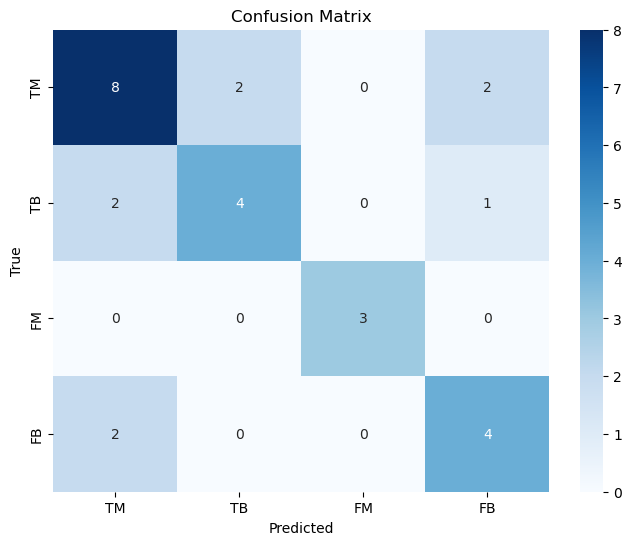

              precision    recall  f1-score   support

           0       0.67      0.67      0.67        12
           1       0.67      0.57      0.62         7
           2       1.00      1.00      1.00         3
           3       0.57      0.67      0.62         6

    accuracy                           0.68        28
   macro avg       0.73      0.73      0.72        28
weighted avg       0.68      0.68      0.68        28



In [168]:
y_true, y_pred, classes = evaluate_model(new_model_vgg19, test_generator, label_mapping1)

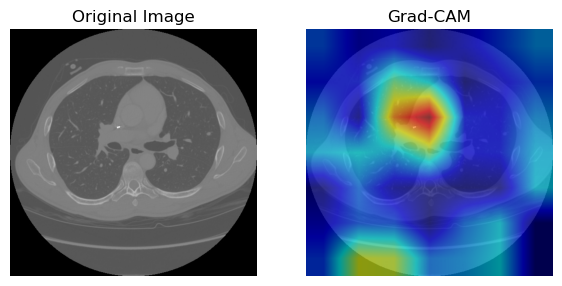

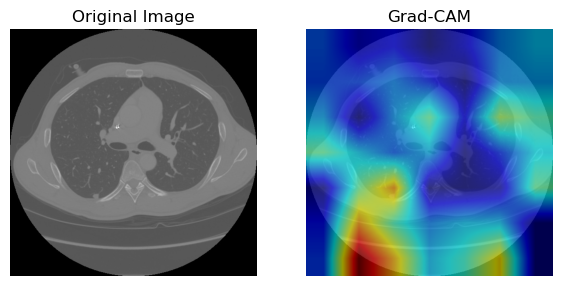

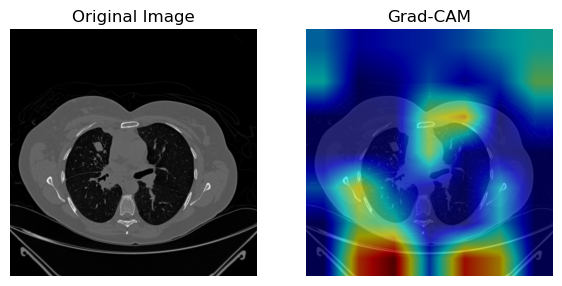

In [169]:

img_path = '/home/ec2-user/teza-folder/4classes/1871_TM_slice_149.jpg'
img_array = get_img_array(img_path, size=(224, 224))
last_conv_layer_name = "dense_1"

heatmap = make_gradcam_heatmap(img_array, new_model_vgg19, last_conv_layer_name)
save_and_display_gradcam(img_path, heatmap)

img_path2 = '/home/ec2-user/teza-folder/4classes/1871_TM_slice_156.jpg' 
img_array2 = get_img_array(img_path2, size=(224, 224))

heatmap2 = make_gradcam_heatmap(img_array2, new_model_vgg19, last_conv_layer_name)

save_and_display_gradcam(img_path2, heatmap2)
img_path3 = '/home/ec2-user/teza-folder/4classes/1546_TM_slice_159.jpg' 
img_array3 = get_img_array(img_path3, size=(224, 224))

heatmap3 = make_gradcam_heatmap(img_array3, new_model_vgg19, last_conv_layer_name)

save_and_display_gradcam(img_path3, heatmap3)

#### InceptionV3

In [170]:
def build_inception_tl(input_shape, num_classes):
    base_model = InceptionV3( include_top=False, input_shape=(224, 224,3))

    for layer in base_model.layers:
        layer.trainable = False
    
    x = base_model.output
    x = GlobalAveragePooling2D()(x)

   # x = Dense(512, activation='relu')(x)
 
    x = Dense(1024, activation='relu')(x)
   # x = Dropout(0.3)(x) 
    output = Dense(num_classes, activation="softmax", name="output")(x)
    model = Model(inputs=base_model.input, outputs=output)
    
    optimizer = Adam(learning_rate=0.0001)
    model.compile(optimizer=optimizer, loss='categorical_crossentropy', metrics=['accuracy'])
    
    return model

In [171]:
input_shape = (224, 224, 3)
num_classes = 3

model_inc_p1 = build_inception_tl(input_shape, num_classes)
model_inc_p1.summary()

2024-07-13 12:13:23.263736: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1928] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 14785 MB memory:  -> device: 0, name: Tesla V100-SXM2-16GB, pci bus id: 0000:00:1e.0, compute capability: 7.0


Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer         │ (None, 224, 224,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d (Conv2D)     │ (None, 111, 111,  │        864 │ input_layer[0][0] │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalization │ (None, 111, 111,  │         96 │ conv2d[0][0]      │
│ (BatchNormalizatio… │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation          │ (None, 111, 111,  │          0 │ batch_normalizat… │
│ (Activation)        │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_1 (Conv2D)   │ (None, 109, 109,  │      9,216 │ activation[0][0]  │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 109, 109,  │         96 │ conv2d_1[0][0]    │
│ (BatchNormalizatio… │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_1        │ (None, 109, 109,  │          0 │ batch_normalizat… │
│ (Activation)        │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_2 (Conv2D)   │ (None, 109, 109,  │     18,432 │ activation_1[0][… │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 109, 109,  │        192 │ conv2d_2[0][0]    │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_2        │ (None, 109, 109,  │          0 │ batch_normalizat… │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d       │ (None, 54, 54,    │          0 │ activation_2[0][… │
│ (MaxPooling2D)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_3 (Conv2D)   │ (None, 54, 54,    │      5,120 │ max_pooling2d[0]… │
│                     │ 80)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 54, 54,    │        240 │ conv2d_3[0][0]    │
│ (BatchNormalizatio… │ 80)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_3        │ (None, 54, 54,    │          0 │ batch_normalizat… │
│ (Activation)        │ 80)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_4 (Conv2D)   │ (None, 52, 52,    │    138,240 │ activation_3[0][… │
│                     │ 192)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 52, 52,    │        576 │ conv2d_4[0][0]    │
│ (BatchNormalizatio… │ 192)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_4        │ (None, 52, 52,    │          0 │ batch_normalizat

 Total params: 23,904,035 (91.19 MB)

 Trainable params: 2,101,251 (8.02 MB)

 Non-trainable params: 21,802,784 (83.17 MB)

In [172]:
history_inc_lt = model_inc_p1.fit(
    train_gen,
    #steps_per_epoch=len(df_train)//batch_size,
    validation_data=val_gen,
    #validation_steps=len(df_val)//batch_size,
    epochs=50,
    #class_weight = train_class_weights
)

Epoch 1/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 7s 17ms/step - accuracy: 0.9564 - loss: 0.2801 - val_accuracy: 0.9515 - val_loss: 0.3346
Epoch 2/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 7s 17ms/step - accuracy: 0.9783 - loss: 0.0973 - val_accuracy: 0.9212 - val_loss: 0.4065
Epoch 3/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 7s 17ms/step - accuracy: 0.9550 - loss: 0.1471 - val_accuracy: 0.9515 - val_loss: 0.3752
Epoch 4/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 7s 17ms/step - accuracy: 0.9676 - loss: 0.1413 - val_accuracy: 0.9697 - val_loss: 0.1823
Epoch 5/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 7s 17ms/step - accuracy: 0.9729 - loss: 0.1428 - val_accuracy: 0.9576 - val_loss: 0.2390
Epoch 6/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 7s 17ms/step - accuracy: 0.9739 - loss: 0.1217 - val_accuracy: 0.8364 - val_loss: 1.0250
Epoch 7/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 7s 17ms/step - accuracy: 0.9359 - loss: 0.2089 - val_accuracy: 0.9455 - val_loss: 0.2900
Epoch 8/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 7s 17ms/step - accuracy: 0.9883 - loss: 0.0606 - val_accu

In [173]:
model_inc_p1.save_weights('/home/ec2-user/teza-folder/models_weights/inception_notpre.weights.h5')

In [174]:
def inc_tl_p2(input_shape, num_classes):
    base_model = InceptionV3( include_top=False, input_shape=(224, 224,3))

    for layer in base_model.layers:
        layer.trainable = False

    
    x = base_model.output
    #x = Dense(512, activation='relu')(x)
    x = Dense(1024, activation='relu')(x)
    #x = Dropout(0.3)(x) 
    x = GlobalAveragePooling2D()(x)
    output = Dense(num_classes, activation="softmax", name="output")(x)
    model = Model(inputs=base_model.input, outputs=output)
    for layer in base_model.layers[-8:]:
        layer.trainable = True

    return model

In [175]:
new_model_inc = inc_tl_p2(input_shape, num_classes)
new_model_inc.load_weights('/home/ec2-user/teza-folder/models_weights/inception_notpre.weights.h5')

x = new_model_inc.layers[-2].output

output = layers.Dense(4, activation='softmax')(x)

new_model_inc = Model(inputs=new_model_inc.input, outputs=output)

new_model_inc.summary()

Model: "functional_33"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_5       │ (None, 224, 224,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_102 (Conv2D) │ (None, 111, 111,  │        864 │ input_layer_5[0]… │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 111, 111,  │         96 │ conv2d_102[0][0]  │
│ (BatchNormalizatio… │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_106      │ (None, 111, 111,  │          0 │ batch_normalizat… │
│ (Activation)        │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_103 (Conv2D) │ (None, 109, 109,  │      9,216 │ activation_106[0… │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 109, 109,  │         96 │ conv2d_103[0][0]  │
│ (BatchNormalizatio… │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_107      │ (None, 109, 109,  │          0 │ batch_normalizat… │
│ (Activation)        │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_104 (Conv2D) │ (None, 109, 109,  │     18,432 │ activation_107[0… │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 109, 109,  │        192 │ conv2d_104[0][0]  │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_108      │ (None, 109, 109,  │          0 │ batch_normalizat… │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d_10    │ (None, 54, 54,    │          0 │ activation_108[0… │
│ (MaxPooling2D)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_105 (Conv2D) │ (None, 54, 54,    │      5,120 │ max_pooling2d_10… │
│                     │ 80)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 54, 54,    │        240 │ conv2d_105[0][0]  │
│ (BatchNormalizatio… │ 80)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_109      │ (None, 54, 54,    │          0 │ batch_normalizat… │
│ (Activation)        │ 80)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_106 (Conv2D) │ (None, 52, 52,    │    138,240 │ activation_109[0… │
│                     │ 192)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 52, 52,    │        576 │ conv2d_106[0][0]  │
│ (BatchNormalizatio… │ 192)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_110      │ (None, 52, 52,    │          0 │ batch_normalizat

 Total params: 23,905,060 (91.19 MB)

 Trainable params: 2,102,468 (8.02 MB)

 Non-trainable params: 21,802,592 (83.17 MB)

In [176]:
optimizer = Adam(learning_rate=0.0001)
new_model_inc.compile(optimizer=optimizer, loss='categorical_crossentropy', metrics=['accuracy'])
    

In [177]:
history_inc_ltp2 = new_model_inc.fit(
    train_generator,
    #steps_per_epoch=len(df_train)//batch_size,
    validation_data=val_generator,
    #validation_steps=len(df_val)//batch_size,
    epochs=50,
    #class_weight = train_class_weights
)

Epoch 1/50
64/64 ━━━━━━━━━━━━━━━━━━━━ 1s 14ms/step - accuracy: 0.9735 - loss: 0.0263 - val_accuracy: 0.6667 - val_loss: 1.5278
Epoch 2/50
64/64 ━━━━━━━━━━━━━━━━━━━━ 1s 13ms/step - accuracy: 0.9951 - loss: 0.0066 - val_accuracy: 0.6667 - val_loss: 1.4144
Epoch 3/50
64/64 ━━━━━━━━━━━━━━━━━━━━ 1s 13ms/step - accuracy: 0.9790 - loss: 0.0209 - val_accuracy: 0.5926 - val_loss: 1.4901
Epoch 4/50
64/64 ━━━━━━━━━━━━━━━━━━━━ 1s 13ms/step - accuracy: 0.9921 - loss: 0.0089 - val_accuracy: 0.6296 - val_loss: 1.5548
Epoch 5/50
64/64 ━━━━━━━━━━━━━━━━━━━━ 1s 13ms/step - accuracy: 0.9946 - loss: 0.0163 - val_accuracy: 0.6296 - val_loss: 1.7055
Epoch 6/50
64/64 ━━━━━━━━━━━━━━━━━━━━ 1s 13ms/step - accuracy: 0.9989 - loss: 0.0074 - val_accuracy: 0.6667 - val_loss: 1.6294
Epoch 7/50
64/64 ━━━━━━━━━━━━━━━━━━━━ 1s 13ms/step - accuracy: 0.9947 - loss: 0.0092 - val_accuracy: 0.6296 - val_loss: 1.4864
Epoch 8/50
64/64 ━━━━━━━━━━━━━━━━━━━━ 1s 13ms/step - accuracy: 0.9994 - loss: 0.0022 - val_accuracy: 0.6296 - v

In [178]:
test_loss_inc_ct, test_accuracy_inc_ct = new_model_inc.evaluate(test_generator)

14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - accuracy: 0.8433 - loss: 0.8989


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


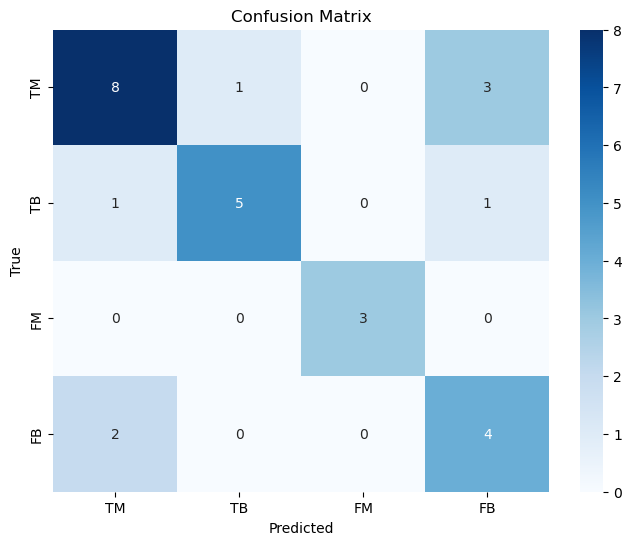

              precision    recall  f1-score   support

           0       0.73      0.67      0.70        12
           1       0.83      0.71      0.77         7
           2       1.00      1.00      1.00         3
           3       0.50      0.67      0.57         6

    accuracy                           0.71        28
   macro avg       0.77      0.76      0.76        28
weighted avg       0.73      0.71      0.72        28



In [179]:
y_true, y_pred, classes = evaluate_model(new_model_inc, test_generator, label_mapping1)

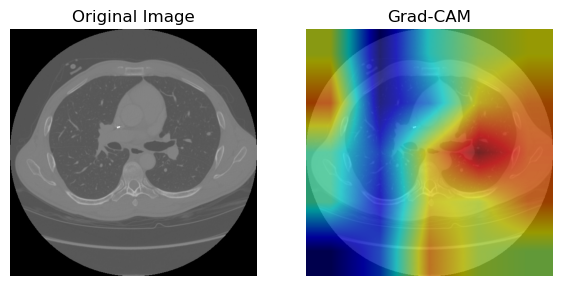

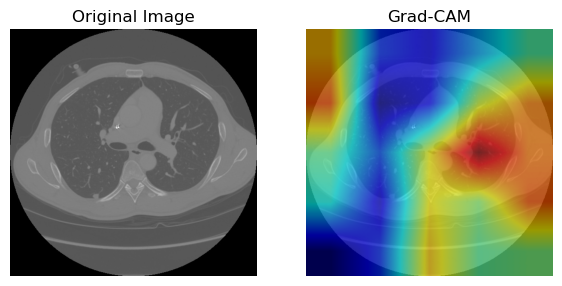

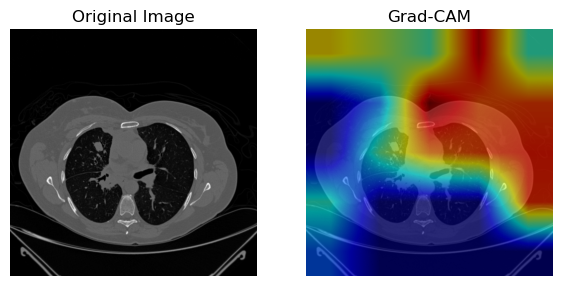

In [180]:

img_path = '/home/ec2-user/teza-folder/4classes/1871_TM_slice_149.jpg'
img_array = get_img_array(img_path, size=(224, 224))
last_conv_layer_name = "dense_5"

heatmap = make_gradcam_heatmap(img_array, new_model_inc, last_conv_layer_name)
save_and_display_gradcam(img_path, heatmap)

img_path2 = '/home/ec2-user/teza-folder/4classes/1871_TM_slice_156.jpg' 
img_array2 = get_img_array(img_path2, size=(224, 224))

heatmap2 = make_gradcam_heatmap(img_array2, new_model_inc, last_conv_layer_name)

save_and_display_gradcam(img_path2, heatmap2)
img_path3 = '/home/ec2-user/teza-folder/4classes/1546_TM_slice_159.jpg' 
img_array3 = get_img_array(img_path3, size=(224, 224))

heatmap3 = make_gradcam_heatmap(img_array3, new_model_inc, last_conv_layer_name)

save_and_display_gradcam(img_path3, heatmap3)

#### ResNet50

In [181]:
def build_resnet_tl(input_shape, num_classes):
    base_model = ResNet50(include_top=False, input_shape=(224, 224,3))

    for layer in base_model.layers:
        layer.trainable = False
    
    x = base_model.output
    x = GlobalAveragePooling2D()(x)
   # x = Dense(512, activation='relu')(x)
    x = Dense(1024, activation='relu')(x)
   # x = Dropout(0.3)(x) 
    output = Dense(num_classes, activation="sigmoid", name="output")(x)
    model = Model(inputs=base_model.input, outputs=output)
    
    optimizer = Adam(learning_rate=0.0001)
    model.compile(optimizer=optimizer, loss='binary_crossentropy', metrics=['accuracy'])
    
    return model

In [182]:
input_shape = (224, 224, 3)
num_classes = 3

model_resnet_tl = build_resnet_tl(input_shape, num_classes)

In [183]:
history_res_lt = model_resnet_tl.fit(
    train_gen,
    #steps_per_epoch=len(df_train)//batch_size,
    validation_data=val_gen,
    #validation_steps=len(df_val)//batch_size,
    epochs=50,
    #class_weight = train_class_weights
)

Epoch 1/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 24s 37ms/step - accuracy: 0.7978 - loss: 0.3485 - val_accuracy: 0.8727 - val_loss: 0.1995
Epoch 2/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 7s 17ms/step - accuracy: 0.8861 - loss: 0.1797 - val_accuracy: 0.9333 - val_loss: 0.1265
Epoch 3/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 7s 17ms/step - accuracy: 0.9188 - loss: 0.1335 - val_accuracy: 0.9515 - val_loss: 0.1217
Epoch 4/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 7s 17ms/step - accuracy: 0.9466 - loss: 0.1041 - val_accuracy: 0.9576 - val_loss: 0.1059
Epoch 5/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 7s 17ms/step - accuracy: 0.9437 - loss: 0.1048 - val_accuracy: 0.8970 - val_loss: 0.1671
Epoch 6/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 7s 17ms/step - accuracy: 0.9623 - loss: 0.0748 - val_accuracy: 0.9273 - val_loss: 0.1373
Epoch 7/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 7s 17ms/step - accuracy: 0.9734 - loss: 0.0577 - val_accuracy: 0.9576 - val_loss: 0.1024
Epoch 8/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 7s 18ms/step - accuracy: 0.9569 - loss: 0.0656 - val_acc

In [184]:
model_resnet_tl.save_weights('/home/ec2-user/teza-folder/models_weights/resnet.weights.h5')

In [185]:
def resnet_tl_p2(input_shape, num_classes):
    base_model = ResNet50( include_top=False, input_shape=(224, 224,3))

    for layer in base_model.layers:
        layer.trainable = False
    for layer in base_model.layers[-8:]:
        layer.trainable = True
    
    x = base_model.output
    #x = Dense(512, activation='relu')(x)
    x = Dense(1024, activation='relu')(x)
    #x = Dropout(0.3)(x) 
    x = GlobalAveragePooling2D()(x)
    output = Dense(num_classes, activation="softmax", name="output")(x)
    model = Model(inputs=base_model.input, outputs=output)

    return model

In [186]:
new_model_resnet = resnet_tl_p2(input_shape, num_classes)
new_model_resnet.load_weights('/home/ec2-user/teza-folder/models_weights/resnet.weights.h5')

x = new_model_resnet.layers[-2].output

output = layers.Dense(4, activation='softmax')(x)

new_model_resnet = Model(inputs=new_model_resnet.input, outputs=output)

new_model_resnet.summary()

Model: "functional_40"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_25      │ (None, 224, 224,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_pad           │ (None, 230, 230,  │          0 │ input_layer_25[0… │
│ (ZeroPadding2D)     │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_conv (Conv2D) │ (None, 112, 112,  │      9,472 │ conv1_pad[0][0]   │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_bn            │ (None, 112, 112,  │        256 │ conv1_conv[0][0]  │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_relu          │ (None, 112, 112,  │          0 │ conv1_bn[0][0]    │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool1_pad           │ (None, 114, 114,  │          0 │ conv1_relu[0][0]  │
│ (ZeroPadding2D)     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool1_pool          │ (None, 56, 56,    │          0 │ pool1_pad[0][0]   │
│ (MaxPooling2D)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_conv │ (None, 56, 56,    │      4,160 │ pool1_pool[0][0]  │
│ (Conv2D)            │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_bn   │ (None, 56, 56,    │        256 │ conv2_block1_1_c… │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_relu │ (None, 56, 56,    │          0 │ conv2_block1_1_b… │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_2_conv │ (None, 56, 56,    │     36,928 │ conv2_block1_1_r… │
│ (Conv2D)            │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_2_bn   │ (None, 56, 56,    │        256 │ conv2_block1_2_c… │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_2_relu │ (None, 56, 56,    │          0 │ conv2_block1_2_b… │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_0_conv │ (None, 56, 56,    │     16,640 │ pool1_pool[0][0]  │
│ (Conv2D)            │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_3_conv │ (None, 56, 56,    │     16,640 │ conv2_block1_2_r… │
│ (Conv2D)            │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_0_bn   │ (None, 56, 56,    │      1,024 │ conv2_block1_0_c… │
│ (BatchNormalizatio… │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_3_bn   │ (None, 56, 56,    │      1,024 │ conv2_block1_3_c

 Total params: 25,689,988 (98.00 MB)

 Trainable params: 5,517,828 (21.05 MB)

 Non-trainable params: 20,172,160 (76.95 MB)

In [187]:
optimizer = Adam(learning_rate=0.0001)
new_model_resnet.compile(optimizer=optimizer, loss='categorical_crossentropy', metrics=['accuracy'])
    

In [188]:
history_res_ltp2 = new_model_resnet.fit(
    train_generator,
    #steps_per_epoch=len(df_train)//batch_size,
    validation_data=val_generator,
    #validation_steps=len(df_val)//batch_size,
    epochs=50,
    #class_weight = train_class_weights
)

Epoch 1/50


I0000 00:00:1720774336.045967  386219 asm_compiler.cc:369] ptxas warning : Registers are spilled to local memory in function 'triton_gemm_dot', 1300 bytes spill stores, 1284 bytes spill loads



64/64 ━━━━━━━━━━━━━━━━━━━━ 25s 142ms/step - accuracy: 0.3688 - loss: 1.5321 - val_accuracy: 0.4074 - val_loss: 1.2945
Epoch 2/50
64/64 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step - accuracy: 0.4496 - loss: 1.3250 - val_accuracy: 0.4815 - val_loss: 1.2286
Epoch 3/50
64/64 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step - accuracy: 0.4033 - loss: 1.2091 - val_accuracy: 0.4074 - val_loss: 1.1778
Epoch 4/50
64/64 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step - accuracy: 0.3742 - loss: 1.2092 - val_accuracy: 0.4074 - val_loss: 1.1282
Epoch 5/50
64/64 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step - accuracy: 0.4724 - loss: 1.1618 - val_accuracy: 0.5185 - val_loss: 1.0021
Epoch 6/50
64/64 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step - accuracy: 0.5414 - loss: 1.0864 - val_accuracy: 0.4074 - val_loss: 1.1546
Epoch 7/50
64/64 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step - accuracy: 0.5017 - loss: 1.1490 - val_accuracy: 0.5185 - val_loss: 0.9394
Epoch 8/50
64/64 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step - accuracy: 0.4277 - loss: 1.0352 - val_accuracy: 0.5556 - val_loss: 

In [189]:
test_loss_res_ct, test_accuracy_res_ct = new_model_resnet.evaluate(test_generator)

14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - accuracy: 0.4381 - loss: 1.0356   


1/1 ━━━━━━━━━━━━━━━━━━━━ 4s 4s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step


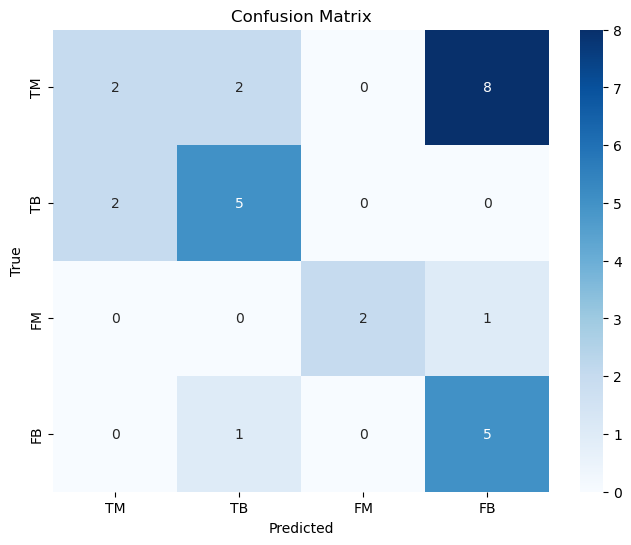

              precision    recall  f1-score   support

           0       0.50      0.17      0.25        12
           1       0.62      0.71      0.67         7
           2       1.00      0.67      0.80         3
           3       0.36      0.83      0.50         6

    accuracy                           0.50        28
   macro avg       0.62      0.60      0.55        28
weighted avg       0.55      0.50      0.47        28



In [190]:
y_true, y_pred, classes = evaluate_model(new_model_resnet, test_generator, label_mapping1)

#### MobileNetV3Large

In [191]:
def build_mobilenet_tl(input_shape, num_classes):
    base_model = MobileNetV3Large(include_top=False, input_shape=(224, 224,3))

    for layer in base_model.layers:
        layer.trainable = False
    
    x = base_model.output
    x = GlobalAveragePooling2D()(x)
   # x = Dense(512, activation='relu')(x)
    x = Dense(1024, activation='relu')(x)
   # x = Dropout(0.3)(x) 
    output = Dense(num_classes, activation="sigmoid", name="output")(x)
    model = Model(inputs=base_model.input, outputs=output)
    
    optimizer = Adam(learning_rate=0.0001)
    model.compile(optimizer=optimizer, loss='binary_crossentropy', metrics=['accuracy'])
    
    return model

In [192]:
input_shape = (224, 224, 3)
num_classes = 3

mob_tl = build_mobilenet_tl(input_shape, num_classes)

In [193]:
history_mob_tl = mob_tl.fit(
    train_gen,
    #steps_per_epoch=len(df_train)//batch_size,
    validation_data=val_gen,
    #validation_steps=len(df_val)//batch_size,
    epochs=50,
    #class_weight = train_class_weights
)

Epoch 1/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 26s 41ms/step - accuracy: 0.8082 - loss: 0.3363 - val_accuracy: 0.9030 - val_loss: 0.1697
Epoch 2/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 7s 17ms/step - accuracy: 0.9207 - loss: 0.1481 - val_accuracy: 0.9333 - val_loss: 0.1586
Epoch 3/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 7s 17ms/step - accuracy: 0.9033 - loss: 0.1464 - val_accuracy: 0.8909 - val_loss: 0.1693
Epoch 4/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 6s 17ms/step - accuracy: 0.9422 - loss: 0.1121 - val_accuracy: 0.9152 - val_loss: 0.1312
Epoch 5/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 7s 17ms/step - accuracy: 0.9571 - loss: 0.0860 - val_accuracy: 0.9273 - val_loss: 0.1257
Epoch 6/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 7s 17ms/step - accuracy: 0.9650 - loss: 0.0670 - val_accuracy: 0.9030 - val_loss: 0.1317
Epoch 7/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 6s 16ms/step - accuracy: 0.9759 - loss: 0.0575 - val_accuracy: 0.9394 - val_loss: 0.1004
Epoch 8/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 6s 17ms/step - accuracy: 0.9828 - loss: 0.0509 - val_acc

In [194]:
mob_tl.save_weights('/home/ec2-user/teza-folder/models_weights/mobilenet.weights.h5')

In [195]:
def mobilenet_tl_p2(input_shape, num_classes):
    base_model = MobileNetV3Large( include_top=False, input_shape=(224, 224,3))

    for layer in base_model.layers:
        layer.trainable = False
    for layer in base_model.layers[-8:]:
        layer.trainable = True
    
    x = base_model.output
    #x = Dense(512, activation='relu')(x)
    x = Dense(1024, activation='relu')(x)
    #x = Dropout(0.3)(x) 
    x = GlobalAveragePooling2D()(x)
    output = Dense(num_classes, activation="softmax", name="output")(x)
    model = Model(inputs=base_model.input, outputs=output)

    return model

In [196]:
new_model_mob = mobilenet_tl_p2(input_shape, num_classes)
new_model_mob.load_weights('/home/ec2-user/teza-folder/models_weights/mobilenet.weights.h5')

x = new_model_mob.layers[-2].output

output = layers.Dense(4, activation='softmax')(x)

new_model_mob = Model(inputs=new_model_mob.input, outputs=output)

new_model_mob.summary()

Model: "functional_43"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_27      │ (None, 224, 224,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ rescaling_1         │ (None, 224, 224,  │          0 │ input_layer_27[0… │
│ (Rescaling)         │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv (Conv2D)       │ (None, 112, 112,  │        432 │ rescaling_1[0][0] │
│                     │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv_bn             │ (None, 112, 112,  │         64 │ conv[0][0]        │
│ (BatchNormalizatio… │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_584      │ (None, 112, 112,  │          0 │ conv_bn[0][0]     │
│ (Activation)        │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_dept… │ (None, 112, 112,  │        144 │ activation_584[0… │
│ (DepthwiseConv2D)   │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_dept… │ (None, 112, 112,  │         64 │ expanded_conv_de… │
│ (BatchNormalizatio… │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ re_lu_19 (ReLU)     │ (None, 112, 112,  │          0 │ expanded_conv_de… │
│                     │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_proj… │ (None, 112, 112,  │        256 │ re_lu_19[0][0]    │
│ (Conv2D)            │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_proj… │ (None, 112, 112,  │         64 │ expanded_conv_pr… │
│ (BatchNormalizatio… │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_add   │ (None, 112, 112,  │          0 │ activation_584[0… │
│ (Add)               │ 16)               │            │ expanded_conv_pr… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_1_ex… │ (None, 112, 112,  │      1,024 │ expanded_conv_ad… │
│ (Conv2D)            │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_1_ex… │ (None, 112, 112,  │        256 │ expanded_conv_1_… │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ re_lu_20 (ReLU)     │ (None, 112, 112,  │          0 │ expanded_conv_1_… │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_1_de… │ (None, 113, 113,  │          0 │ re_lu_20[0][0]    │
│ (ZeroPadding2D)     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_1_de… │ (None, 56, 56,    │        576 │ expanded_conv_1_… │
│ (DepthwiseConv2D)   │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_1_de… │ (None, 56, 56,    │        256 │ expanded_conv_1_

 Total params: 3,984,516 (15.20 MB)

 Trainable params: 1,297,604 (4.95 MB)

 Non-trainable params: 2,686,912 (10.25 MB)

In [197]:
optimizer = Adam(learning_rate=0.0001)
new_model_mob.compile(optimizer=optimizer, loss='categorical_crossentropy', metrics=['accuracy'])
  

In [198]:
history_inc_ltp2 = new_model_mob.fit(
    train_generator,
    #steps_per_epoch=len(df_train)//batch_size,
    validation_data=val_generator,
    #validation_steps=len(df_val)//batch_size,
    epochs=50,
    #class_weight = train_class_weights
)

Epoch 1/50


I0000 00:00:1720775914.557667  389577 asm_compiler.cc:369] ptxas warning : Registers are spilled to local memory in function 'triton_gemm_dot', 620 bytes spill stores, 604 bytes spill loads

I0000 00:00:1720775920.033769  389580 asm_compiler.cc:369] ptxas warning : Registers are spilled to local memory in function 'triton_gemm_dot', 42652 bytes spill stores, 42832 bytes spill loads



64/64 ━━━━━━━━━━━━━━━━━━━━ 31s 176ms/step - accuracy: 0.2828 - loss: 1.5198 - val_accuracy: 0.2222 - val_loss: 1.3784
Epoch 2/50
64/64 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.5161 - loss: 1.1449 - val_accuracy: 0.2222 - val_loss: 1.3681
Epoch 3/50
64/64 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.5268 - loss: 1.1768 - val_accuracy: 0.2222 - val_loss: 1.3727
Epoch 4/50
64/64 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.4774 - loss: 1.0750 - val_accuracy: 0.2222 - val_loss: 1.3564
Epoch 5/50
64/64 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.5716 - loss: 1.0523 - val_accuracy: 0.2222 - val_loss: 1.3688
Epoch 6/50
64/64 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.5929 - loss: 1.0439 - val_accuracy: 0.2222 - val_loss: 1.3644
Epoch 7/50
64/64 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.4557 - loss: 1.1477 - val_accuracy: 0.2222 - val_loss: 1.3776
Epoch 8/50
64/64 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.4997 - loss: 1.0440 - val_accuracy: 0.2222 - val_loss: 1.3

In [199]:
test_loss_mob_ct, test_accuracy_mob_ct = new_model_mob.evaluate(test_generator)

14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - accuracy: 0.5089 - loss: 1.2290


1/1 ━━━━━━━━━━━━━━━━━━━━ 4s 4s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


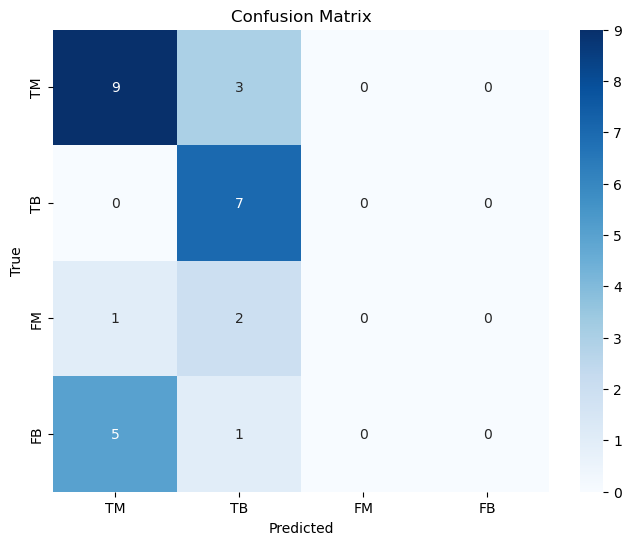

              precision    recall  f1-score   support

           0       0.60      0.75      0.67        12
           1       0.54      1.00      0.70         7
           2       0.00      0.00      0.00         3
           3       0.00      0.00      0.00         6

    accuracy                           0.57        28
   macro avg       0.28      0.44      0.34        28
weighted avg       0.39      0.57      0.46        28



/home/ec2-user/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/ec2-user/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/ec2-user/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [200]:
y_true, y_pred, classes = evaluate_model(new_model_mob, test_generator, label_mapping1)

#### Binary classification 

In [201]:
label_map = {'TM': '0', 'FB': '0', 'FM': '1', 'TB': '1'}
df1['binary_labels'] = df1['labels'].map(label_map)


In [202]:
train_df_bin, remaining_df = train_test_split(df1, test_size=0.3, random_state=42)

val_df_bin, test_df_bin = train_test_split(remaining_df, test_size=(1/3), random_state=42)

display(train_df_bin)

,filepaths,labels,binary_labels
26,/home/ec2-user/teza-folder/4classes/2494_FB_sl...,FB,0
38,/home/ec2-user/teza-folder/4classes/1411_FB_sl...,FB,0
118,/home/ec2-user/teza-folder/4classes/5614_FM_sl...,FM,1
170,/home/ec2-user/teza-folder/4classes/.ipynb_che...,FB,0
104,/home/ec2-user/teza-folder/4classes/2199_TM_sl...,TM,0
...,...,...,...
106,/home/ec2-user/teza-folder/4classes/6031_FB_sl...,FB,0
14,/home/ec2-user/teza-folder/4classes/2142_FB_sl...,FB,0
92,/home/ec2-user/teza-folder/4classes/3341_TB_sl...,TB,1
179,/home/ec2-user/teza-folder/4classes/.ipynb_che...,TM,0


In [203]:
datagen = ImageDataGenerator(rescale=1./255)

train_generator1 = datagen.flow_from_dataframe(
    train_df_bin,
    x_col='filepaths',
    y_col='binary_labels',
    target_size=(224, 224),
    color_mode='rgb',
    class_mode='binary',
    batch_size=2,
    shuffle=True
)

val_generator1 = datagen.flow_from_dataframe(
    val_df_bin,
    x_col='filepaths',
    y_col='binary_labels',
    target_size=(224, 224),
    color_mode='rgb',
    class_mode='binary',
    batch_size=2,
    shuffle=False
)

test_generator1 = datagen.flow_from_dataframe(
    test_df_bin,
    x_col='filepaths',
    y_col='binary_labels',
    target_size=(224, 224),
    color_mode='rgb',
    class_mode='binary',
    batch_size=2,
    shuffle=False
)


print(f"Training generator size: {train_generator.samples}")
print(f"Validation generator size: {val_generator.samples}")
print(f"Test generator size: {test_generator.samples}")


Found 133 validated image filenames belonging to 2 classes.
Found 38 validated image filenames belonging to 2 classes.
Found 20 validated image filenames belonging to 2 classes.
Training generator size: 133
Validation generator size: 29
Test generator size: 29


#### CNN

In [204]:
def build_2d_cnn_bin(input_shape, num_classes):
    inputs = Input(shape=input_shape)

    x = Conv2D(64, (3, 3), padding='same')(inputs)
    x = Activation('relu')(x)
    x = BatchNormalization()(x)
    x = MaxPooling2D(pool_size=(2, 2), strides=(2, 2), padding='same')(x)

    x = Conv2D(128, (3, 3), padding='same')(x)
    x = Activation('relu')(x)
    x = BatchNormalization()(x)
    x = MaxPooling2D(pool_size=(2, 2), strides=(2, 2), padding='same')(x)

    x = Conv2D(256, (3, 3), padding='same')(x)
    x = Activation('relu')(x)
    x = BatchNormalization()(x)
    x = MaxPooling2D(pool_size=(2, 2), strides=(2, 2), padding='same')(x)

    x = Conv2DTranspose(256, (3, 3), strides=(2, 2), padding='same')(x)
    x = Activation('relu')(x)
    x = BatchNormalization()(x)

    x = Conv2DTranspose(128, (3, 3), strides=(2, 2), padding='same')(x)
    x = Activation('relu')(x)
    x = BatchNormalization()(x)

    x = Conv2DTranspose(64, (3, 3), strides=(2, 2), padding='same')(x)
    x = Activation('relu')(x)
    x = BatchNormalization()(x)

    x = Conv2D(1, (1, 1), padding='same')(x)
    x = Activation('sigmoid')(x)

    outputs = GlobalAveragePooling2D()(x)

    model = Model(inputs=inputs, outputs=outputs)
    
    return model


In [205]:
modelcnn_bin = build_2d_cnn_bin((224,224,3), num_classes=2)
modelcnn_bin.compile(optimizer=Adam(learning_rate=0.0001), loss='binary_crossentropy',  metrics=['accuracy'])

In [206]:
history_cnn_bin  = modelcnn_bin.fit(
    train_generator1,
    #steps_per_epoch=len(df_train)//batch_size,
    validation_data=val_generator1,
    #validation_steps=len(df_val)//batch_size,
    epochs=50,
    #class_weight = train_class_weights
)

Epoch 1/50


/home/ec2-user/anaconda3/lib/python3.11/site-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


67/67 ━━━━━━━━━━━━━━━━━━━━ 19s 219ms/step - accuracy: 0.5429 - loss: 0.6337 - val_accuracy: 0.6842 - val_loss: 0.6455
Epoch 2/50
67/67 ━━━━━━━━━━━━━━━━━━━━ 14s 211ms/step - accuracy: 0.6984 - loss: 0.5869 - val_accuracy: 0.6842 - val_loss: 0.6082
Epoch 3/50
67/67 ━━━━━━━━━━━━━━━━━━━━ 14s 210ms/step - accuracy: 0.7571 - loss: 0.5715 - val_accuracy: 0.6842 - val_loss: 0.6079
Epoch 4/50
67/67 ━━━━━━━━━━━━━━━━━━━━ 14s 211ms/step - accuracy: 0.7029 - loss: 0.5808 - val_accuracy: 0.6842 - val_loss: 0.4845
Epoch 5/50
67/67 ━━━━━━━━━━━━━━━━━━━━ 14s 211ms/step - accuracy: 0.7868 - loss: 0.4846 - val_accuracy: 0.8158 - val_loss: 0.4344
Epoch 6/50
67/67 ━━━━━━━━━━━━━━━━━━━━ 14s 212ms/step - accuracy: 0.7528 - loss: 0.4940 - val_accuracy: 0.6842 - val_loss: 0.5429
Epoch 7/50
67/67 ━━━━━━━━━━━━━━━━━━━━ 14s 212ms/step - accuracy: 0.7547 - loss: 0.5147 - val_accuracy: 0.6842 - val_loss: 0.5690
Epoch 8/50
67/67 ━━━━━━━━━━━━━━━━━━━━ 14s 209ms/step - accuracy: 0.8116 - loss: 0.4563 - val_accuracy: 0.815

In [207]:
test_loss_bin_ct, test_accuracy_bin_ct = modelcnn_bin.evaluate(test_generator1)

10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - accuracy: 0.4321 - loss: 9.0539   


In [208]:
history_cnn_bin  = modelcnn_bin.fit(
    train_generator1,
    #steps_per_epoch=len(df_train)//batch_size,
    validation_data=val_generator1,
    #validation_steps=len(df_val)//batch_size,
    epochs=50,
    #class_weight = train_class_weights
)

Epoch 1/50


/home/ec2-user/anaconda3/lib/python3.11/site-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()
I0000 00:00:1722318449.605319  138384 service.cc:145] XLA service 0x7f36b4019aa0 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
I0000 00:00:1722318449.605383  138384 service.cc:153]   StreamExecutor device (0): Tesla V100-SXM2-16GB, Compute Capability 7.0
2024-07-30 05:47:29.723909: I tensorflow/compiler/mlir/tensorflow/utils/dump_mlir_util.cc:268] disabling MLIR crash reproducer, set env var `MLIR_CRASH_REPRODUCER_DIRECTORY` to enable.
2024-07-30 05:47:30.265759: I external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:465] Loaded cuDNN version 8907


 1/67 ━━━━━━━━━━━━━━━━━━━━ 10:01 9s/step - accuracy: 0.5000 - loss: 0.7029

I0000 00:00:1722318454.163425  138384 device_compiler.h:188] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


67/67 ━━━━━━━━━━━━━━━━━━━━ 14s 77ms/step - accuracy: 0.6795 - loss: 0.6360 - val_accuracy: 0.7632 - val_loss: 0.6279
Epoch 2/50
67/67 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step - accuracy: 0.6823 - loss: 0.5466 - val_accuracy: 0.7632 - val_loss: 0.5600
Epoch 3/50
67/67 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step - accuracy: 0.6247 - loss: 0.5763 - val_accuracy: 0.7632 - val_loss: 0.4977
Epoch 4/50
67/67 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step - accuracy: 0.7535 - loss: 0.5444 - val_accuracy: 0.7632 - val_loss: 0.4110
Epoch 5/50
67/67 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step - accuracy: 0.8346 - loss: 0.4677 - val_accuracy: 0.7895 - val_loss: 0.3234
Epoch 6/50
67/67 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step - accuracy: 0.7851 - loss: 0.4728 - val_accuracy: 0.8684 - val_loss: 0.3127
Epoch 7/50
67/67 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step - accuracy: 0.7522 - loss: 0.4836 - val_accuracy: 0.8421 - val_loss: 0.2920
Epoch 8/50
67/67 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step - accuracy: 0.6646 - loss: 0.5399 - val_accuracy: 0.7632 - val_loss: 0

In [209]:
test_loss_bin_ct, test_accuracy_bin_ct = modelcnn_bin.evaluate(test_generator1)

10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step - accuracy: 0.7409 - loss: 0.4207


In [210]:
def evaluate_model1(model, test_gen):
    y_true = []
    y_pred = []
    test_gen.reset()
    
    for _ in range(len(test_gen)):
        batch_x, batch_y = next(test_gen)
        preds = model.predict(batch_x)
        y_true.extend(batch_y)
        y_pred.extend(preds)
    y_pred_binary = [1 if pred > 0.5 else 0 for pred in y_pred]
    
    y_true = np.array(y_true).astype(int)
    y_pred_binary = np.array(y_pred_binary)
 
    cm = confusion_matrix(y_true, y_pred_binary)
    cr = classification_report(y_true, y_pred_binary, target_names=['Class 0', 'Class 1'])
    
    return y_true, y_pred_binary, cm, cr



In [211]:
y_true, y_pred, cm, cr  = evaluate_model1(modelcnn_bin, test_generator1)
print(cr)

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step
              precision    recall  f1-score   support

     Class 0       0.92      0.79      0.85        14
     Class 1       0.62      0.83      0.71         6

    accuracy                           0.80        20
   macro avg       0.77      0.81      0.78        20
weighted avg       0.83      0.80      0.81        20



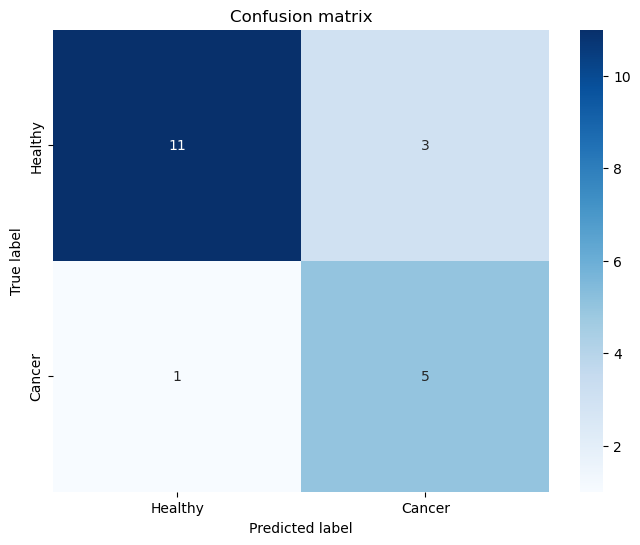

In [212]:
def plot_confusion_matrix(cm, classes, title='Confusion matrix', cmap=plt.cm.Blues):
    plt.figure(figsize=(8, 6))
    sns.heatmap(cm, annot=True, fmt='d', cmap=cmap, xticklabels=classes, yticklabels=classes)
    plt.title(title)
    plt.ylabel('True label')
    plt.xlabel('Predicted label')
    plt.show()
plot_confusion_matrix(cm, classes=['Healthy', 'Cancer'])

In [213]:
modelcnn_bin.save_weights('/home/ec2-user/teza-folder/models_weights/cnn_bin.weights.h5')

#### VGG19

In [214]:
def build_vgg119_bin_ct(input_shape, num_classes):
    base_model = VGG19(weights="imagenet", include_top=False, input_shape=(224, 224,3))

    for layer in base_model.layers:
        layer.trainable = False
    
    x = base_model.output
    x = GlobalAveragePooling2D()(x)
    x = Dense(512, activation='relu')(x)
    x = Dense(1024, activation='relu')(x)
    x = Dropout(0.3)(x) 
    output = Dense(1, activation="sigmoid", name="output")(x)
    model = Model(inputs=base_model.input, outputs=output)
    
    optimizer = Adam(learning_rate=0.0001)
    model.compile(optimizer=optimizer, loss='binary_crossentropy', metrics=['accuracy'])
    
    return model

In [215]:
input_shape = (224, 224, 3)
num_classes = 2

model_vgg19_ct = build_vgg119_bin_ct(input_shape, num_classes)
model_vgg19_ct.summary()

Model: "functional_160"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_31 (InputLayer)     │ (None, 224, 224, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_conv1 (Conv2D)           │ (None, 224, 224, 64)   │         1,792 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_conv2 (Conv2D)           │ (None, 224, 224, 64)   │        36,928 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_pool (MaxPooling2D)      │ (None, 112, 112, 64)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_conv1 (Conv2D)           │ (None, 112, 112, 128)  │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_conv2 (Conv2D)           │ (None, 112, 112, 128)  │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_pool (MaxPooling2D)      │ (None, 56, 56, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv1 (Conv2D)           │ (None, 56, 56, 256)    │       295,168 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv2 (Conv2D)           │ (None, 56, 56, 256)    │       590,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv3 (Conv2D)           │ (None, 56, 56, 256)    │       590,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv4 (Conv2D)           │ (None, 56, 56, 256)    │       590,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_pool (MaxPooling2D)      │ (None, 28, 28, 256)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv1 (Conv2D)           │ (None, 28, 28, 512)    │     1,180,160 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv2 (Conv2D)           │ (None, 28, 28, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv3 (Conv2D)           │ (None, 28, 28, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv4 (Conv2D)           │ (None, 28, 28, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_pool (MaxPooling2D)      │ (None, 14, 14, 512)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv1 (Conv2D)           │ (None, 14, 14, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv2 (Conv2D)           │ (None, 14, 14, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv3 (Conv2D)           │ (None, 14, 14, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv4 (Conv2D)           │ (None, 14, 14, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_pool (MaxPooling2D)      │ (None, 7, 7, 512)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_average_pooling2d_29     │ (None, 512)            │             0 │
│ (GlobalAveragePooling2D)        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_51 (Dense)                │ (None, 512)            │       262,656 │
├─────────────────────────────────┼────────────────────────┼─────────────

 Total params: 20,813,377 (79.40 MB)

 Trainable params: 788,993 (3.01 MB)

 Non-trainable params: 20,024,384 (76.39 MB)

In [216]:
history_vgg19_ct = model_vgg19_ct.fit(
    train_generator1,
    #steps_per_epoch=len(df_train)//batch_size,
    validation_data=val_generator1,
    #validation_steps=len(df_val)//batch_size,
    epochs=50,
    #class_weight = train_class_weights
)

Epoch 1/50
57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.9567 - loss: 0.1262 - val_accuracy: 0.8182 - val_loss: 0.4249
Epoch 2/50
57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.9615 - loss: 0.1102 - val_accuracy: 0.8485 - val_loss: 0.3832
Epoch 3/50
57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.9919 - loss: 0.0883 - val_accuracy: 0.8182 - val_loss: 0.4741
Epoch 4/50
57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.9482 - loss: 0.1246 - val_accuracy: 0.8182 - val_loss: 0.4363
Epoch 5/50
57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.9287 - loss: 0.1043 - val_accuracy: 0.7576 - val_loss: 0.6646
Epoch 6/50
57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.9486 - loss: 0.1011 - val_accuracy: 0.8485 - val_loss: 0.4322
Epoch 7/50
57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.9874 - loss: 0.0850 - val_accuracy: 0.8182 - val_loss: 0.4787
Epoch 8/50
57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.9791 - loss: 0.0539 - val_accuracy: 0.8485 - v

In [217]:
test_loss_bin_ct, test_accuracy_bin_ct = model_vgg19_ct.evaluate(test_generator1)

9/9 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - accuracy: 0.8379 - loss: 2.7259   


/home/ec2-user/anaconda3/lib/python3.11/site-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


In [218]:
y_true, y_pred, cm, cr  = evaluate_model1(model_vgg19_ct, test_generator1)
print(cr)

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
              precision    recall  f1-score   support

     Class 0       0.82      0.90      0.86        10
     Class 1       0.83      0.71      0.77         7

    accuracy                           0.82        17
   macro avg       0.83      0.81      0.81        17
weighted avg       0.82      0.82      0.82        17



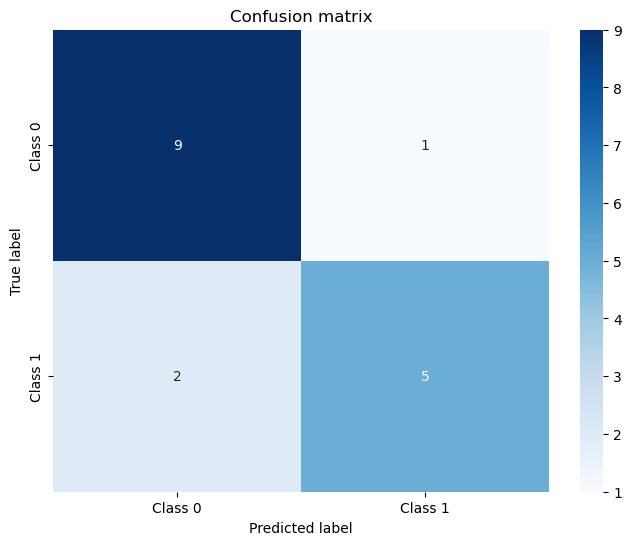

In [219]:
def plot_confusion_matrix(cm, classes, title='Confusion matrix', cmap=plt.cm.Blues):
    plt.figure(figsize=(8, 6))
    sns.heatmap(cm, annot=True, fmt='d', cmap=cmap, xticklabels=classes, yticklabels=classes)
    plt.title(title)
    plt.ylabel('True label')
    plt.xlabel('Predicted label')
    plt.show()
plot_confusion_matrix(cm, classes=['Class 0', 'Class 1'])

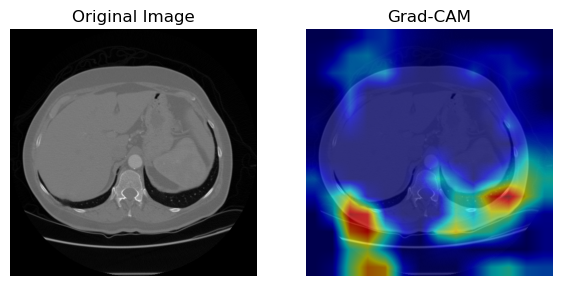

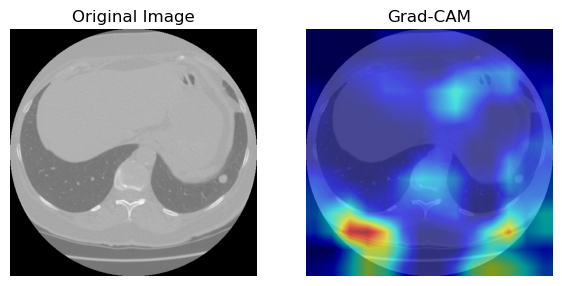

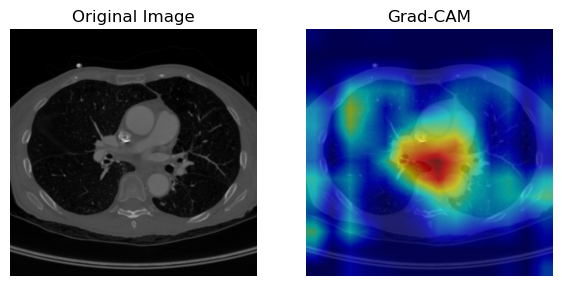

In [220]:

img_path = '/home/ec2-user/teza-folder/4classes/2494_FB_slice_23.jpg'
img_array = get_img_array(img_path, size=(224, 224))
last_conv_layer_name = "block5_conv4"

heatmap = make_gradcam_heatmap(img_array, model_vgg19_ct, last_conv_layer_name)
save_and_display_gradcam(img_path, heatmap)

img_path1 = '/home/ec2-user/teza-folder/4classes/2495_TM_slice_96.jpg' 
img_array1 = get_img_array(img_path1, size=(224, 224))

heatmap1 = make_gradcam_heatmap(img_array1,model_vgg19_ct, last_conv_layer_name)
save_and_display_gradcam(img_path1, heatmap1)

img_path2 = '/home/ec2-user/teza-folder/4classes/7507_TM_slice_201.jpg' 
img_array2 = get_img_array(img_path2, size=(224, 224))

heatmap2 = make_gradcam_heatmap(img_array2, model_vgg19_ct, last_conv_layer_name)

save_and_display_gradcam(img_path2, heatmap2)

#### Inception V3

In [221]:
def build_inc_bin_ct(input_shape, num_classes):
    base_model = InceptionV3(weights="imagenet", include_top=False, input_shape=(224, 224,3))

    for layer in base_model.layers:
        layer.trainable = False
    
    x = base_model.output
    x = GlobalAveragePooling2D()(x)
    x = Dense(512, activation='relu')(x)
    x = Dense(1024, activation='relu')(x)
    x = Dropout(0.3)(x) 
    output = Dense(1, activation="sigmoid", name="output")(x)
    model = Model(inputs=base_model.input, outputs=output)
    
    optimizer = Adam(learning_rate=0.0001)
    model.compile(optimizer=optimizer, loss='binary_crossentropy', metrics=['accuracy'])
    
    return model

In [222]:
input_shape = (224, 224, 3)
num_classes = 2

model_inc_ct_bin = build_inc_bin_ct(input_shape, num_classes)


In [223]:
model_inc_ct_bin.summary()

Model: "functional_21"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_19      │ (None, 224, 224,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_68 (Conv2D)  │ (None, 111, 111,  │        864 │ input_layer_19[0… │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 111, 111,  │         96 │ conv2d_68[0][0]   │
│ (BatchNormalizatio… │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_119      │ (None, 111, 111,  │          0 │ batch_normalizat… │
│ (Activation)        │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_69 (Conv2D)  │ (None, 109, 109,  │      9,216 │ activation_119[0… │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 109, 109,  │         96 │ conv2d_69[0][0]   │
│ (BatchNormalizatio… │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_120      │ (None, 109, 109,  │          0 │ batch_normalizat… │
│ (Activation)        │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_70 (Conv2D)  │ (None, 109, 109,  │     18,432 │ activation_120[0… │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 109, 109,  │        192 │ conv2d_70[0][0]   │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_121      │ (None, 109, 109,  │          0 │ batch_normalizat… │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d_51    │ (None, 54, 54,    │          0 │ activation_121[0… │
│ (MaxPooling2D)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_71 (Conv2D)  │ (None, 54, 54,    │      5,120 │ max_pooling2d_51… │
│                     │ 80)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 54, 54,    │        240 │ conv2d_71[0][0]   │
│ (BatchNormalizatio… │ 80)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_122      │ (None, 54, 54,    │          0 │ batch_normalizat… │
│ (Activation)        │ 80)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_72 (Conv2D)  │ (None, 52, 52,    │    138,240 │ activation_122[0… │
│                     │ 192)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 52, 52,    │        576 │ conv2d_72[0][0]   │
│ (BatchNormalizatio… │ 192)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_123      │ (None, 52, 52,    │          0 │ batch_normalizat

 Total params: 26,529,061 (101.20 MB)

 Trainable params: 1,575,425 (6.01 MB)

 Non-trainable params: 21,802,784 (83.17 MB)

 Optimizer params: 3,150,852 (12.02 MB)

In [224]:
history_inc_ct_bin = model_inc_ct_bin.fit(
    train_generator1,
    #steps_per_epoch=len(df_train)//batch_size,
    validation_data=val_generator1,
    #validation_steps=len(df_val)//batch_size,
    epochs=50,
    #class_weight = train_class_weights
)

Epoch 1/50
67/67 ━━━━━━━━━━━━━━━━━━━━ 27s 184ms/step - accuracy: 0.7430 - loss: 0.5259 - val_accuracy: 0.8684 - val_loss: 0.3243
Epoch 2/50
67/67 ━━━━━━━━━━━━━━━━━━━━ 1s 14ms/step - accuracy: 0.8904 - loss: 0.2932 - val_accuracy: 0.8947 - val_loss: 0.2274
Epoch 3/50
67/67 ━━━━━━━━━━━━━━━━━━━━ 1s 14ms/step - accuracy: 0.8713 - loss: 0.2127 - val_accuracy: 0.8947 - val_loss: 0.2047
Epoch 4/50
67/67 ━━━━━━━━━━━━━━━━━━━━ 1s 14ms/step - accuracy: 0.9433 - loss: 0.1429 - val_accuracy: 0.8947 - val_loss: 0.2843
Epoch 5/50
67/67 ━━━━━━━━━━━━━━━━━━━━ 1s 14ms/step - accuracy: 0.8958 - loss: 0.1926 - val_accuracy: 0.8947 - val_loss: 0.1560
Epoch 6/50
67/67 ━━━━━━━━━━━━━━━━━━━━ 1s 14ms/step - accuracy: 0.9795 - loss: 0.0818 - val_accuracy: 0.9211 - val_loss: 0.1435
Epoch 7/50
67/67 ━━━━━━━━━━━━━━━━━━━━ 1s 14ms/step - accuracy: 0.9779 - loss: 0.0941 - val_accuracy: 0.8947 - val_loss: 0.1499
Epoch 8/50
67/67 ━━━━━━━━━━━━━━━━━━━━ 1s 14ms/step - accuracy: 0.9996 - loss: 0.0291 - val_accuracy: 0.9737 -

In [225]:
test_loss_inc_ct, test_accuracy_inc_ct = model_inc_ct_bin.evaluate(test_generator1)

10/10 ━━━━━━━━━━━━━━━━━━━━ 3s 296ms/step - accuracy: 0.9300 - loss: 1.3679


In [226]:
y_true, y_pred, cm, cr  = evaluate_model1(model_inc_ct_bin, test_generator1)
print(cr)

1/1 ━━━━━━━━━━━━━━━━━━━━ 5s 5s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 5s 5s/step
              precision    recall  f1-score   support

     Class 0       0.90      1.00      0.95         9
     Class 1       1.00      0.90      0.95        10

    accuracy                           0.95        19
   macro avg       0.95      0.95      0.95        19
weighted avg       0.95      0.95      0.95        19



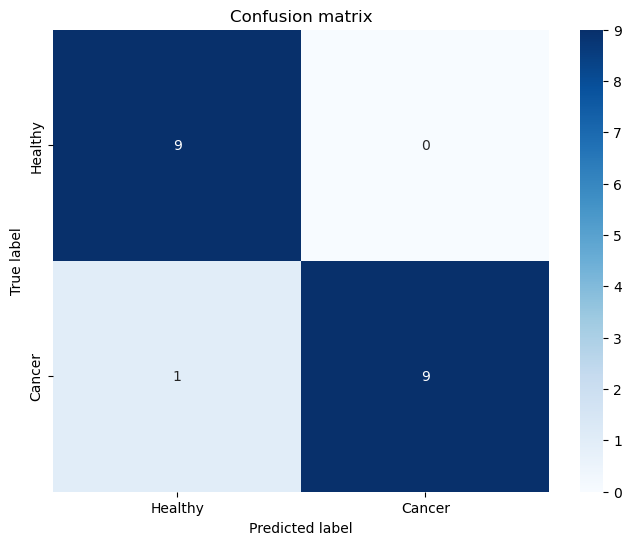

In [227]:
plot_confusion_matrix(cm, classes=['Healthy', 'Cancer'])

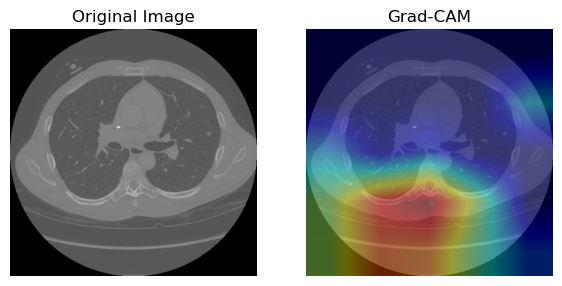

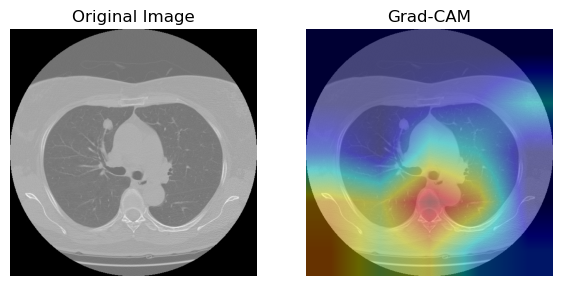

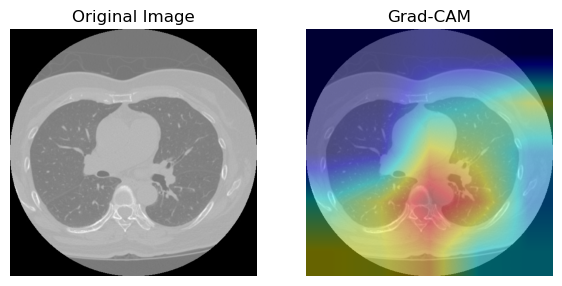

In [228]:

img_path = '/home/ec2-user/teza-folder/4classes/1871_TM_slice_149.jpg'
img_array = get_img_array(img_path, size=(224, 224))
last_conv_layer_name = "mixed10"

heatmap = make_gradcam_heatmap(img_array, model_inc_ct_bin, last_conv_layer_name)
save_and_display_gradcam(img_path, heatmap)

img_path1 = '/home/ec2-user/teza-folder/4classes/1937_FM_slice_82.jpg' 
img_array1 = get_img_array(img_path1, size=(224, 224))

heatmap1 = make_gradcam_heatmap(img_array1,model_inc_ct_bin, last_conv_layer_name)
save_and_display_gradcam(img_path1, heatmap1)

img_path2 = '/home/ec2-user/teza-folder/4classes/3251_FB_slice_304.jpg' 
img_array2 = get_img_array(img_path2, size=(224, 224))

heatmap2 = make_gradcam_heatmap(img_array2, model_inc_ct_bin, last_conv_layer_name)

save_and_display_gradcam(img_path2, heatmap2)


#### ResNet50

In [229]:
def build_resnet_bin_ct(input_shape, num_classes):
    base_model = ResNet50(weights="imagenet", include_top=False, input_shape=(224, 224,3))

    for layer in base_model.layers:
        layer.trainable = False
    
    x = base_model.output
    x = GlobalAveragePooling2D()(x)
    x = Dense(512, activation='relu')(x)
    x = Dense(1024, activation='relu')(x)
    x = Dropout(0.3)(x) 
    output = Dense(1, activation="sigmoid", name="output")(x)
    model = Model(inputs=base_model.input, outputs=output)
    
    optimizer = Adam(learning_rate=0.0001)
    model.compile(optimizer=optimizer, loss='binary_crossentropy', metrics=['accuracy'])
    
    return model

In [230]:
input_shape = (224, 224, 3)
num_classes = 2

model_resnet_ct_bin = build_resnet_bin_ct(input_shape, num_classes)


In [231]:
history_resnet_ct_bin = model_resnet_ct_bin.fit(
    train_generator1,
    #steps_per_epoch=len(df_train)//batch_size,
    validation_data=val_generator1,
    #validation_steps=len(df_val)//batch_size,
    epochs=50,
    #class_weight = train_class_weights
)

Epoch 1/50
57/57 ━━━━━━━━━━━━━━━━━━━━ 17s 102ms/step - accuracy: 0.5344 - loss: 0.7172 - val_accuracy: 0.7273 - val_loss: 0.5858
Epoch 2/50
57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.5617 - loss: 0.7501 - val_accuracy: 0.7273 - val_loss: 0.5501
Epoch 3/50
57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.6307 - loss: 0.6448 - val_accuracy: 0.4848 - val_loss: 0.6800
Epoch 4/50
57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.6188 - loss: 0.6478 - val_accuracy: 0.7273 - val_loss: 0.5275
Epoch 5/50
57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.6781 - loss: 0.5955 - val_accuracy: 0.7576 - val_loss: 0.5318
Epoch 6/50
57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.6784 - loss: 0.5868 - val_accuracy: 0.7273 - val_loss: 0.4906
Epoch 7/50
57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.6738 - loss: 0.5805 - val_accuracy: 0.8485 - val_loss: 0.5148
Epoch 8/50
57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.6891 - loss: 0.5805 - val_accuracy: 0.7879 -

In [232]:
test_loss_inc_ct, test_accuracy_inc_ct = model_resnet_ct_bin.evaluate(test_generator1)

9/9 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - accuracy: 0.7944 - loss: 0.8268


In [233]:
y_true, y_pred, cm, cr  = evaluate_model1(model_resnet_ct_bin, test_generator1)
print(cr)

1/1 ━━━━━━━━━━━━━━━━━━━━ 4s 4s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 4s 4s/step
              precision    recall  f1-score   support

     Class 0       0.80      0.80      0.80        10
     Class 1       0.71      0.71      0.71         7

    accuracy                           0.76        17
   macro avg       0.76      0.76      0.76        17
weighted avg       0.76      0.76      0.76        17



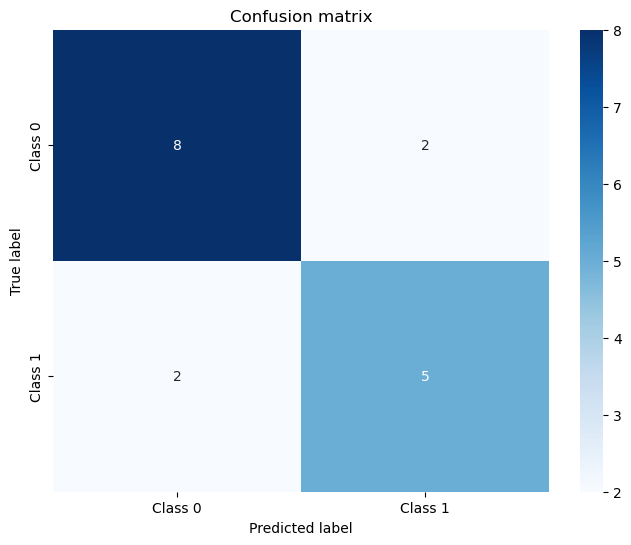

In [234]:
plot_confusion_matrix(cm, classes=['Class 0', 'Class 1'])

In [235]:
model_resnet_ct_bin.summary()

Model: "functional_6"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_3       │ (None, 224, 224,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_pad           │ (None, 230, 230,  │          0 │ input_layer_3[0]… │
│ (ZeroPadding2D)     │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_conv (Conv2D) │ (None, 112, 112,  │      9,472 │ conv1_pad[0][0]   │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_bn            │ (None, 112, 112,  │        256 │ conv1_conv[0][0]  │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_relu          │ (None, 112, 112,  │          0 │ conv1_bn[0][0]    │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool1_pad           │ (None, 114, 114,  │          0 │ conv1_relu[0][0]  │
│ (ZeroPadding2D)     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool1_pool          │ (None, 56, 56,    │          0 │ pool1_pad[0][0]   │
│ (MaxPooling2D)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_conv │ (None, 56, 56,    │      4,160 │ pool1_pool[0][0]  │
│ (Conv2D)            │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_bn   │ (None, 56, 56,    │        256 │ conv2_block1_1_c… │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_relu │ (None, 56, 56,    │          0 │ conv2_block1_1_b… │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_2_conv │ (None, 56, 56,    │     36,928 │ conv2_block1_1_r… │
│ (Conv2D)            │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_2_bn   │ (None, 56, 56,    │        256 │ conv2_block1_2_c… │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_2_relu │ (None, 56, 56,    │          0 │ conv2_block1_2_b… │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_0_conv │ (None, 56, 56,    │     16,640 │ pool1_pool[0][0]  │
│ (Conv2D)            │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_3_conv │ (None, 56, 56,    │     16,640 │ conv2_block1_2_r… │
│ (Conv2D)            │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_0_bn   │ (None, 56, 56,    │      1,024 │ conv2_block1_0_c… │
│ (BatchNormalizatio… │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_3_bn   │ (None, 56, 56,    │      1,024 │ conv2_block1_3_c

 Total params: 25,163,137 (95.99 MB)

 Trainable params: 1,575,425 (6.01 MB)

 Non-trainable params: 23,587,712 (89.98 MB)

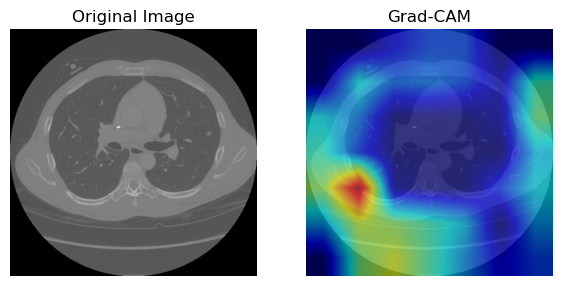

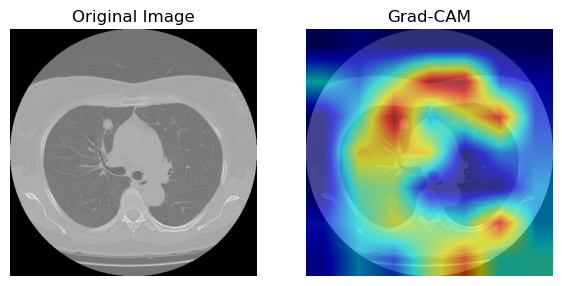

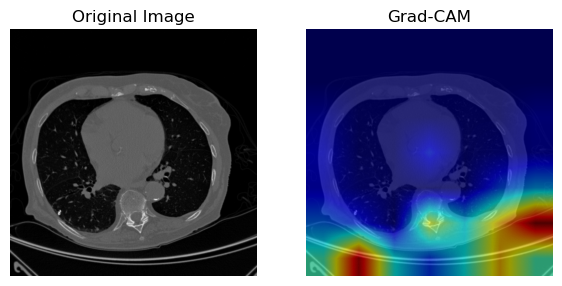

In [236]:

img_path = '/home/ec2-user/teza-folder/4classes/1871_TM_slice_149.jpg'
img_array = get_img_array(img_path, size=(224, 224))
last_conv_layer_name = "conv5_block3_out"

heatmap = make_gradcam_heatmap(img_array, model_resnet_ct_bin, last_conv_layer_name)
save_and_display_gradcam(img_path, heatmap)

img_path1 = '/home/ec2-user/teza-folder/4classes/1937_FM_slice_82.jpg' 
img_array1 = get_img_array(img_path1, size=(224, 224))

heatmap1 = make_gradcam_heatmap(img_array1,model_resnet_ct_bin, last_conv_layer_name)
save_and_display_gradcam(img_path1, heatmap1)

img_path2 = '/home/ec2-user/teza-folder/4classes/2244_TM_slice_108.jpg' 
img_array2 = get_img_array(img_path2, size=(224, 224))

heatmap2 = make_gradcam_heatmap(img_array2, model_resnet_ct_bin, last_conv_layer_name)

save_and_display_gradcam(img_path2, heatmap2)

#### MobileNet

In [237]:
def build_mobilenet_bin_ct(input_shape, num_classes):
    base_model = MobileNetV3Large(weights="imagenet", include_top=False, input_shape=(224, 224,3))

    for layer in base_model.layers:
        layer.trainable = False
    
    x = base_model.output
    x = GlobalAveragePooling2D()(x)
    x = Dense(512, activation='relu')(x)
    x = Dense(1024, activation='relu')(x)
    x = Dropout(0.3)(x) 
    output = Dense(1, activation="sigmoid", name="output")(x)
    model = Model(inputs=base_model.input, outputs=output)
    
    optimizer = Adam(learning_rate=0.0001)
    model.compile(optimizer=optimizer, loss='binary_crossentropy', metrics=['accuracy'])
    
    return model

In [238]:
input_shape = (224, 224, 3)
num_classes = 2

mobilenet_ct_bin = build_mobilenet_bin_ct(input_shape, num_classes)

In [239]:
mobilenet_ct_bin.summary()

Model: "functional_138"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_30      │ (None, 224, 224,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ rescaling_8         │ (None, 224, 224,  │          0 │ input_layer_30[0… │
│ (Rescaling)         │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv (Conv2D)       │ (None, 112, 112,  │        432 │ rescaling_8[0][0] │
│                     │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv_bn             │ (None, 112, 112,  │         64 │ conv[0][0]        │
│ (BatchNormalizatio… │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_630      │ (None, 112, 112,  │          0 │ conv_bn[0][0]     │
│ (Activation)        │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_dept… │ (None, 112, 112,  │        144 │ activation_630[0… │
│ (DepthwiseConv2D)   │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_dept… │ (None, 112, 112,  │         64 │ expanded_conv_de… │
│ (BatchNormalizatio… │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ re_lu_152 (ReLU)    │ (None, 112, 112,  │          0 │ expanded_conv_de… │
│                     │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_proj… │ (None, 112, 112,  │        256 │ re_lu_152[0][0]   │
│ (Conv2D)            │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_proj… │ (None, 112, 112,  │         64 │ expanded_conv_pr… │
│ (BatchNormalizatio… │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_add   │ (None, 112, 112,  │          0 │ activation_630[0… │
│ (Add)               │ 16)               │            │ expanded_conv_pr… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_1_ex… │ (None, 112, 112,  │      1,024 │ expanded_conv_ad… │
│ (Conv2D)            │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_1_ex… │ (None, 112, 112,  │        256 │ expanded_conv_1_… │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ re_lu_153 (ReLU)    │ (None, 112, 112,  │          0 │ expanded_conv_1_… │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_1_de… │ (None, 113, 113,  │          0 │ re_lu_153[0][0]   │
│ (ZeroPadding2D)     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_1_de… │ (None, 56, 56,    │        576 │ expanded_conv_1_… │
│ (DepthwiseConv2D)   │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_1_de… │ (None, 56, 56,    │        256 │ expanded_conv_1_

 Total params: 4,014,721 (15.31 MB)

 Trainable params: 1,018,369 (3.88 MB)

 Non-trainable params: 2,996,352 (11.43 MB)

In [240]:
history_mobilenet_ct_bin = mobilenet_ct_bin.fit(
    train_generator1,
    #steps_per_epoch=len(df_train)//batch_size,
    validation_data=val_generator1,
    #validation_steps=len(df_val)//batch_size,
    epochs=50,
    #class_weight = train_class_weights
)

Epoch 1/50
57/57 ━━━━━━━━━━━━━━━━━━━━ 18s 118ms/step - accuracy: 0.6362 - loss: 0.6443 - val_accuracy: 0.7273 - val_loss: 0.5824
Epoch 2/50
57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.6363 - loss: 0.6629 - val_accuracy: 0.7273 - val_loss: 0.5694
Epoch 3/50
57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.6464 - loss: 0.6242 - val_accuracy: 0.7273 - val_loss: 0.5674
Epoch 4/50
57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.6902 - loss: 0.5989 - val_accuracy: 0.7273 - val_loss: 0.5546
Epoch 5/50
57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.6908 - loss: 0.6177 - val_accuracy: 0.7273 - val_loss: 0.5839
Epoch 6/50
57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.6712 - loss: 0.6154 - val_accuracy: 0.7273 - val_loss: 0.5315
Epoch 7/50
57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.7012 - loss: 0.5838 - val_accuracy: 0.7273 - val_loss: 0.5063
Epoch 8/50
57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.6350 - loss: 0.6298 - val_accuracy: 0.7273 - val_

In [241]:
test_loss_mob_bin_ct, test_accuracy_mob_bin_ct = mobilenet_ct_bin.evaluate(test_generator1)

9/9 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - accuracy: 0.7357 - loss: 0.7342


In [242]:
y_true, y_pred, cm, cr  = evaluate_model1(mobilenet_ct_bin, test_generator1)
print(cr)

1/1 ━━━━━━━━━━━━━━━━━━━━ 4s 4s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 4s 4s/step
              precision    recall  f1-score   support

     Class 0       0.67      0.80      0.73        10
     Class 1       0.60      0.43      0.50         7

    accuracy                           0.65        17
   macro avg       0.63      0.61      0.61        17
weighted avg       0.64      0.65      0.63        17



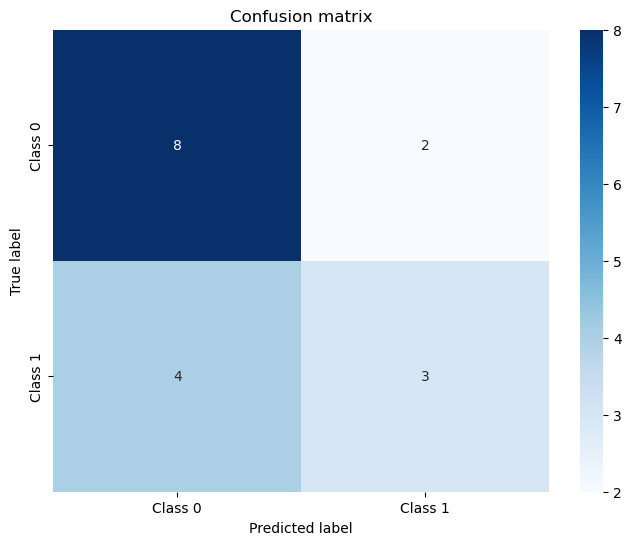

In [243]:
plot_confusion_matrix(cm, classes=['Class 0', 'Class 1'])

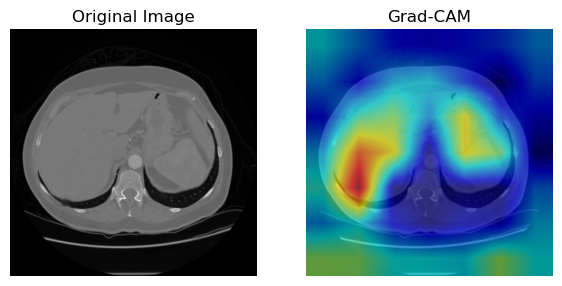

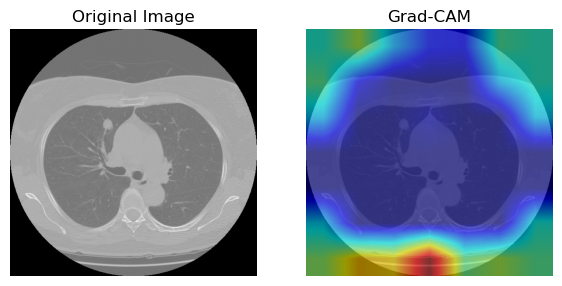

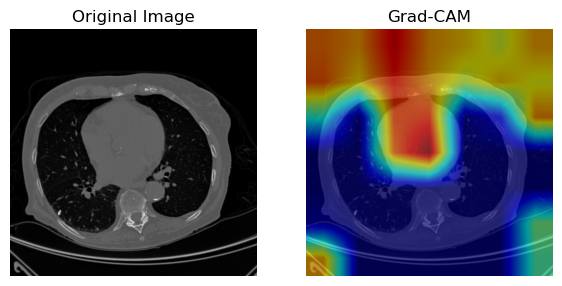

In [244]:
img_path = '/home/ec2-user/teza-folder/4classes/2494_FB_slice_23.jpg'
img_array = get_img_array(img_path, size=(224, 224))
last_conv_layer_name = "conv_1_bn"

heatmap = make_gradcam_heatmap(img_array, mobilenet_ct_bin, last_conv_layer_name)
save_and_display_gradcam(img_path, heatmap)

img_path1 = '/home/ec2-user/teza-folder/4classes/1937_FM_slice_82.jpg' 
img_array1 = get_img_array(img_path1, size=(224, 224))

heatmap1 = make_gradcam_heatmap(img_array1,mobilenet_ct_bin, last_conv_layer_name)
save_and_display_gradcam(img_path1, heatmap1)

img_path2 = '/home/ec2-user/teza-folder/4classes/2244_TM_slice_108.jpg' 
img_array2 = get_img_array(img_path2, size=(224, 224))

heatmap2 = make_gradcam_heatmap(img_array2, mobilenet_ct_bin, last_conv_layer_name)

save_and_display_gradcam(img_path2, heatmap2)

#### Transfer learning 

In [245]:
def build_2d_cnn_bin_tl(input_shape, num_classes):
    model = Sequential([
        Conv2D(64, (3, 3), padding='same', input_shape=input_shape),
        Activation('relu'),
        BatchNormalization(),
        MaxPooling2D(pool_size=(2, 2), strides=(2, 2), padding='same'),  # Adjusted pooling size

        Conv2D(128, (3, 3), padding='same'),
        Activation('relu'),
        BatchNormalization(),
        MaxPooling2D(pool_size=(2, 2), strides=(2, 2), padding='same'),  # Adjusted pooling size

        Conv2D(256, (3, 3), padding='same'),
        Activation('relu'),
        BatchNormalization(),
        MaxPooling2D(pool_size=(2, 2), strides=(2, 2), padding='same'),  # Adjusted pooling size

        Conv2DTranspose(256, (3, 3), strides=(2, 2), padding='same'),
        Activation('relu'),
        BatchNormalization(),

        Conv2DTranspose(128, (3, 3), strides=(2, 2), padding='same'),
        Activation('relu'),
        BatchNormalization(),

        Conv2DTranspose(64, (3, 3), strides=(2, 2), padding='same'),
        Activation('relu'),
        BatchNormalization(),
    
        Conv2D(1, (1, 1), activation='sigmoid', padding='same'),  # Single neuron with sigmoid activation
        
        GlobalAveragePooling2D(),
    ])
    
    #optimizer = Adam(learning_rate=0.0001)
    #model.compile(optimizer=optimizer, loss='binary_crossentropy', metrics=['accuracy'])

    return model
    return model


In [246]:
modelcnn_bin = build_2d_cnn_bin_tl((240,240,3), num_classes=2)
#modelcnn_bin.compile(optimizer=Adam(learning_rate=0.0001), loss='binary_crossentropy',  metrics=['accuracy'])

/home/ec2-user/anaconda3/lib/python3.11/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


In [247]:
history_cnn_bin  = modelcnn_bin.fit(
    train_gen_tl,
    #steps_per_epoch=len(df_train)//batch_size,
    validation_data=val_gen_tl,
    #validation_steps=len(df_val)//batch_size,
    epochs=50,
    #class_weight = train_class_weights
)

Epoch 1/50


/home/ec2-user/anaconda3/lib/python3.11/site-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


384/384 ━━━━━━━━━━━━━━━━━━━━ 17s 25ms/step - accuracy: 0.6383 - loss: 0.6271 - val_accuracy: 0.6970 - val_loss: 0.5423
Epoch 2/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 6s 16ms/step - accuracy: 0.7361 - loss: 0.5248 - val_accuracy: 0.8545 - val_loss: 0.3768
Epoch 3/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 6s 16ms/step - accuracy: 0.7070 - loss: 0.5275 - val_accuracy: 0.8788 - val_loss: 0.3418
Epoch 4/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 6s 16ms/step - accuracy: 0.7747 - loss: 0.4616 - val_accuracy: 0.6364 - val_loss: 0.6039
Epoch 5/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 6s 17ms/step - accuracy: 0.7262 - loss: 0.4928 - val_accuracy: 0.7212 - val_loss: 0.3570
Epoch 6/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 7s 17ms/step - accuracy: 0.7732 - loss: 0.4357 - val_accuracy: 0.8485 - val_loss: 0.3327
Epoch 7/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 6s 16ms/step - accuracy: 0.8377 - loss: 0.3940 - val_accuracy: 0.8788 - val_loss: 0.3027
Epoch 8/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 7s 17ms/step - accuracy: 0.8313 - loss: 0.3832 - val_accuracy: 0.83

In [248]:
test_loss_cnn_tl, test_accuracy_cnn_tl = modelcnn_bin.evaluate(test_gen_tl)

83/83 ━━━━━━━━━━━━━━━━━━━━ 1s 13ms/step - accuracy: 0.9075 - loss: 0.2813


In [249]:
modelcnn_bin.save_weights('/home/ec2-user/teza-folder/models_weights/cnn_bin.weights.h5')

In [250]:
input_shape = (224, 224, 3)
num_classes = 2
new_model_tl = build_2d_cnn_bin_tl(input_shape, num_classes)

/home/ec2-user/anaconda3/lib/python3.11/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


In [251]:
#new_model_tl.compile(optimizer=Adam(learning_rate=0.00001), loss='binary_crossentropy',  metrics=['accuracy'])

In [252]:
new_model_tl.load_weights('/home/ec2-user/teza-folder/models_weights/cnn_bin.weights.h5')

In [253]:
optimizer = Adam(learning_rate=0.0001)
new_model_tl.compile(optimizer=optimizer, loss='binary_crossentropy', metrics=['accuracy'])


In [254]:
history_cnn_bin_tl  = new_model_tl.fit(
    train_generator1,
    #steps_per_epoch=len(df_train)//batch_size,
    validation_data=val_generator1,
    #validation_steps=len(df_val)//batch_size,
    epochs=30,
    #class_weight = train_class_weights
)

Epoch 1/30
57/57 ━━━━━━━━━━━━━━━━━━━━ 8s 27ms/step - accuracy: 0.6435 - loss: 0.6798 - val_accuracy: 0.7273 - val_loss: 1.0388
Epoch 2/30
57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step - accuracy: 0.6970 - loss: 0.5457 - val_accuracy: 0.7273 - val_loss: 3.6949
Epoch 3/30
57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step - accuracy: 0.7629 - loss: 0.4187 - val_accuracy: 0.7273 - val_loss: 4.3958
Epoch 4/30
57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step - accuracy: 0.8012 - loss: 0.4284 - val_accuracy: 0.7273 - val_loss: 4.3958
Epoch 5/30
57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step - accuracy: 0.7107 - loss: 0.4961 - val_accuracy: 0.7273 - val_loss: 4.3958
Epoch 6/30
57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step - accuracy: 0.7448 - loss: 0.5066 - val_accuracy: 0.7273 - val_loss: 3.4762
Epoch 7/30
57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step - accuracy: 0.8893 - loss: 0.3564 - val_accuracy: 0.7273 - val_loss: 2.7878
Epoch 8/30
57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step - accuracy: 0.8198 - loss: 0.4520 - val_accuracy: 0.7273 - v

In [255]:
loss_tl, accuracy_tl = new_model_tl.evaluate(test_generator1)

9/9 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - accuracy: 0.8009 - loss: 0.9299


In [256]:
y_true, y_pred, cm, cr  = evaluate_model1(new_model_tl, test_generator1)
print(cr)

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
              precision    recall  f1-score   support

     Class 0       0.67      1.00      0.80        10
     Class 1       1.00      0.29      0.44         7

    accuracy                           0.71        17
   macro avg       0.83      0.64      0.62        17
weighted avg       0.80      0.71      0.65        17



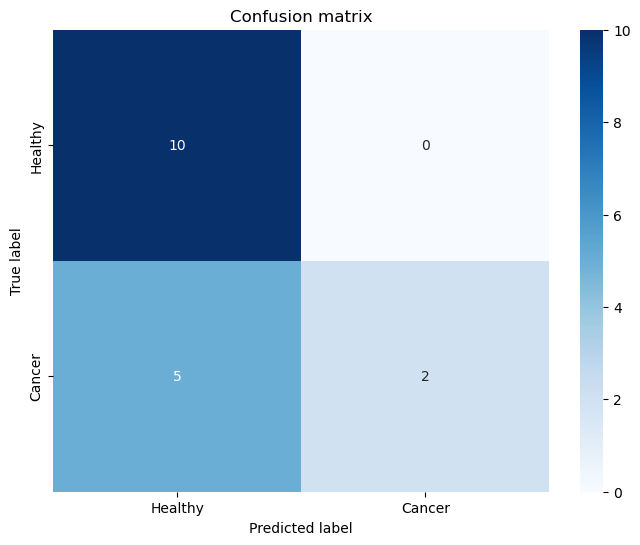

In [257]:
plot_confusion_matrix(cm, classes=['Healthy', 'Cancer'])

#### VGG19 Transfer Learning 

In [258]:
def build_vgg119_bin_ct_new(input_shape, num_classes):
    base_model = VGG19( weights="imagenet", include_top=False, input_shape=(224, 224,3))

    for layer in base_model.layers:
        layer.trainable = False
    
    x = base_model.output
    x = GlobalAveragePooling2D()(x)
    x = Dense(512, activation='relu')(x)
    x = Dense(1024, activation='relu')(x)
    x = Dropout(0.3)(x) 
    output = Dense(1, activation="sigmoid", name="output")(x)
    model = Model(inputs=base_model.input, outputs=output)
    
    #optimizer = Adam(learning_rate=0.0001)
    #model.compile(optimizer=optimizer, loss='binary_crossentropy', metrics=['accuracy'])
    
    return model

In [259]:
input_shape = (224, 224, 3)
num_classes = 2

model_vgg19_tl = build_vgg119_bin_ct_new(input_shape, num_classes)
optimizer = Adam(learning_rate=0.0001)
model_vgg19_tl.compile(optimizer=optimizer, loss='binary_crossentropy', metrics=['accuracy'])
    

In [260]:
history_vgg19_tl_1 = model_vgg19_tl.fit(
    train_gen_tl,
    #steps_per_epoch=len(df_train)//batch_size,
    validation_data=val_gen_tl,
    #validation_steps=len(df_val)//batch_size,
    epochs=50,
    #class_weight = train_class_weights
)

Epoch 1/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 13s 23ms/step - accuracy: 0.8130 - loss: 0.4761 - val_accuracy: 0.8242 - val_loss: 0.4457
Epoch 2/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 6s 16ms/step - accuracy: 0.9019 - loss: 0.2338 - val_accuracy: 0.9576 - val_loss: 0.1194
Epoch 3/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 7s 17ms/step - accuracy: 0.9306 - loss: 0.1733 - val_accuracy: 0.9515 - val_loss: 0.1274
Epoch 4/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 6s 16ms/step - accuracy: 0.9587 - loss: 0.1002 - val_accuracy: 0.9697 - val_loss: 0.1169
Epoch 5/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 7s 17ms/step - accuracy: 0.9611 - loss: 0.1053 - val_accuracy: 0.9636 - val_loss: 0.1008
Epoch 6/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 6s 16ms/step - accuracy: 0.9820 - loss: 0.0506 - val_accuracy: 0.9697 - val_loss: 0.1047
Epoch 7/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 6s 16ms/step - accuracy: 0.9907 - loss: 0.0391 - val_accuracy: 0.9576 - val_loss: 0.1144
Epoch 8/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 6s 16ms/step - accuracy: 0.9891 - loss: 0.0344 - val_acc

In [261]:
model_vgg19_tl.save_weights('/home/ec2-user/teza-folder/models_weights/vgg19_bin.weights.h5')

In [262]:
def build_vgg119_bin_tl(input_shape, num_classes):
    base_model = VGG19( weights="imagenet", include_top=False, input_shape=(224, 224,3))


    for layer in base_model.layers:
        layer.trainable = False
    for layer in base_model.layers[-8:]:
        layer.trainable = True
    
    x = base_model.output
    x = GlobalAveragePooling2D()(x)
    x = Dense(512, activation='relu')(x)
    x = Dense(1024, activation='relu')(x)
    x = Dropout(0.3)(x) 
    output = Dense(1, activation="sigmoid", name="output")(x)
    model = Model(inputs=base_model.input, outputs=output)
    
    #optimizer = Adam(learning_rate=0.0001)
    #model.compile(optimizer=optimizer, loss='binary_crossentropy', metrics=['accuracy'])
    
    return model

In [263]:
input_shape = (224, 224, 3)
num_classes = 2
new_vgg19_tl = build_vgg119_bin_tl(input_shape, num_classes)

In [264]:
new_vgg19_tl.load_weights('/home/ec2-user/teza-folder/models_weights/vgg19_bin.weights.h5')

In [265]:
optimizer = Adam(learning_rate=0.0000001)
new_vgg19_tl.compile(optimizer=optimizer, loss='binary_crossentropy', metrics=['accuracy'])


In [266]:
history_vgg19_bin_tl  = new_vgg19_tl.fit(
    train_generator1,
    #steps_per_epoch=len(df_train)//batch_size,
    validation_data=val_generator1,
    #validation_steps=len(df_val)//batch_size,
    epochs=30,
    #class_weight = train_class_weights
)

Epoch 1/30
57/57 ━━━━━━━━━━━━━━━━━━━━ 7s 32ms/step - accuracy: 0.7010 - loss: 1.9632 - val_accuracy: 0.7273 - val_loss: 1.6574
Epoch 2/30
57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - accuracy: 0.5993 - loss: 2.4321 - val_accuracy: 0.7273 - val_loss: 1.5344
Epoch 3/30
57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - accuracy: 0.6518 - loss: 1.9682 - val_accuracy: 0.7273 - val_loss: 1.4130
Epoch 4/30
57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - accuracy: 0.6225 - loss: 1.8930 - val_accuracy: 0.7273 - val_loss: 1.2809
Epoch 5/30
57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - accuracy: 0.6550 - loss: 1.6020 - val_accuracy: 0.7273 - val_loss: 1.1573
Epoch 6/30
57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - accuracy: 0.6172 - loss: 1.6180 - val_accuracy: 0.7273 - val_loss: 1.0349
Epoch 7/30
57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - accuracy: 0.6602 - loss: 1.2375 - val_accuracy: 0.7273 - val_loss: 0.9307
Epoch 8/30
57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - accuracy: 0.6577 - loss: 1.1498 - val_accuracy: 0.7273 - v

In [267]:
loss_tl, accuracy_tl = new_vgg19_tl.evaluate(test_generator1)

9/9 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - accuracy: 0.7567 - loss: 0.6809


In [268]:
y_true, y_pred, cm, cr  = evaluate_model1(new_vgg19_tl, test_generator1)
print(cr)

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 493ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 501ms/step
              precision    recall  f1-score   support

     Class 0       0.67      1.00      0.80        10
     Class 1       1.00      0.29      0.44         7

    accuracy                           0.71        17
   macro avg       0.83      0.64      0.62        17
weighted avg       0.80      0.71      0.65        17



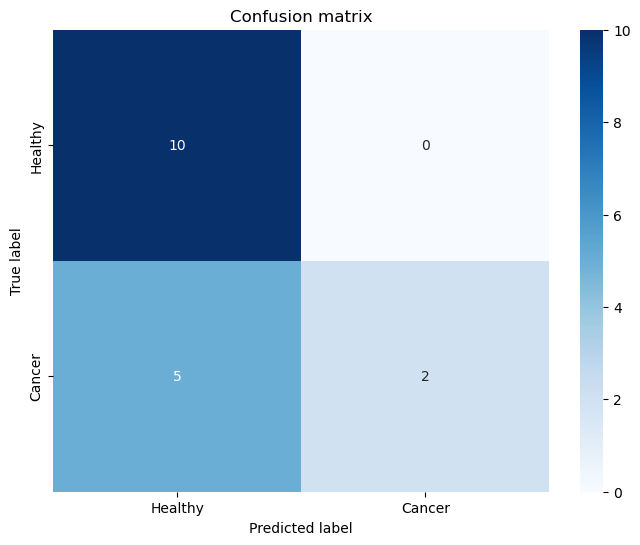

In [269]:
def plot_confusion_matrix(cm, classes, title='Confusion matrix', cmap=plt.cm.Blues):
    plt.figure(figsize=(8, 6))
    sns.heatmap(cm, annot=True, fmt='d', cmap=cmap, xticklabels=classes, yticklabels=classes)
    plt.title(title)
    plt.ylabel('True label')
    plt.xlabel('Predicted label')
    plt.show()

plot_confusion_matrix(cm, classes=['Healthy', 'Cancer'])

#### ResNet50 Transfer Learning 

In [270]:
def build_resnet_bin_tl_new(input_shape, num_classes):
    base_model = ResNet50(weights="imagenet", include_top=False, input_shape=(224, 224,3))

    for layer in base_model.layers:
        layer.trainable = False
    
    x = base_model.output
    x = GlobalAveragePooling2D()(x)
    x = Dense(512, activation='relu')(x)
    x = Dense(1024, activation='relu')(x)
    x = Dropout(0.3)(x) 
    output = Dense(1, activation="sigmoid", name="output")(x)
    model = Model(inputs=base_model.input, outputs=output)
    
   # optimizer = Adam(learning_rate=0.0001)
   # model.compile(optimizer=optimizer, loss='binary_crossentropy', metrics=['accuracy'])
    
    return model

In [271]:
input_shape = (224, 224, 3)
num_classes = 2

model_resnet_tl = build_resnet_bin_tl_new(input_shape, num_classes)
optimizer = Adam(learning_rate=0.0001)
model_resnet_tl.compile(optimizer=optimizer, loss='binary_crossentropy', metrics=['accuracy'])
    

In [272]:
history_resnet_tl_1 = model_resnet_tl.fit(
    train_gen_tl,
    #steps_per_epoch=len(df_train)//batch_size,
    validation_data=val_gen_tl,
    #validation_steps=len(df_val)//batch_size,
    epochs=50,
    #class_weight = train_class_weights
)

Epoch 1/50


/home/ec2-user/anaconda3/lib/python3.11/site-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


384/384 ━━━━━━━━━━━━━━━━━━━━ 26s 39ms/step - accuracy: 0.8190 - loss: 0.3662 - val_accuracy: 0.8909 - val_loss: 0.2198
Epoch 2/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 6s 17ms/step - accuracy: 0.8652 - loss: 0.2858 - val_accuracy: 0.9152 - val_loss: 0.1733
Epoch 3/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 7s 17ms/step - accuracy: 0.9019 - loss: 0.2223 - val_accuracy: 0.9758 - val_loss: 0.1056
Epoch 4/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 7s 17ms/step - accuracy: 0.9321 - loss: 0.1543 - val_accuracy: 0.9576 - val_loss: 0.1078
Epoch 5/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 7s 17ms/step - accuracy: 0.9548 - loss: 0.1242 - val_accuracy: 0.9636 - val_loss: 0.0997
Epoch 6/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 7s 17ms/step - accuracy: 0.9460 - loss: 0.1237 - val_accuracy: 0.9455 - val_loss: 0.1507
Epoch 7/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 7s 17ms/step - accuracy: 0.9548 - loss: 0.1007 - val_accuracy: 0.9939 - val_loss: 0.0566
Epoch 8/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 6s 16ms/step - accuracy: 0.9707 - loss: 0.0645 - val_accuracy: 0.97

In [273]:
model_resnet_tl.save_weights('/home/ec2-user/teza-folder/models_weights/resnet_bin.weights.h5')

In [274]:
def build_resnet_bin_tl_v2(input_shape, num_classes):
    base_model = ResNet50(weights="imagenet", include_top=False, input_shape=(224, 224,3))

    for layer in base_model.layers:
        layer.trainable = False
    for layer in base_model.layers[-8:]:
        layer.trainable = True
    
    
    x = base_model.output
    x = GlobalAveragePooling2D()(x)
    x = Dense(512, activation='relu')(x)
    x = Dense(1024, activation='relu')(x)
    x = Dropout(0.3)(x) 
    output = Dense(1, activation="sigmoid", name="output")(x)
    model = Model(inputs=base_model.input, outputs=output)
    
   # optimizer = Adam(learning_rate=0.0001)
   # model.compile(optimizer=optimizer, loss='binary_crossentropy', metrics=['accuracy'])
    
    return model

In [275]:
input_shape = (224, 224, 3)
num_classes = 2
new_resnet_tl = build_resnet_bin_tl_v2(input_shape, num_classes)

In [276]:
new_resnet_tl.load_weights('/home/ec2-user/teza-folder/models_weights/resnet_bin.weights.h5')

In [277]:
optimizer = Adam(learning_rate=0.000001)
new_resnet_tl.compile(optimizer=optimizer, loss='binary_crossentropy', metrics=['accuracy'])


In [278]:
history_resnet_bin_tl_1  = new_resnet_tl.fit(
    train_generator1,
    #steps_per_epoch=len(df_train)//batch_size,
    validation_data=val_generator1,
    #validation_steps=len(df_val)//batch_size,
    epochs=30,
    #class_weight = train_class_weights
)

Epoch 1/30
57/57 ━━━━━━━━━━━━━━━━━━━━ 20s 111ms/step - accuracy: 0.5723 - loss: 2.8150 - val_accuracy: 0.2121 - val_loss: 0.8205
Epoch 2/30
57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step - accuracy: 0.6547 - loss: 0.9665 - val_accuracy: 0.3636 - val_loss: 0.7370
Epoch 3/30
57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step - accuracy: 0.6908 - loss: 0.6188 - val_accuracy: 0.5455 - val_loss: 0.6371
Epoch 4/30
57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step - accuracy: 0.8232 - loss: 0.4230 - val_accuracy: 0.6667 - val_loss: 0.5771
Epoch 5/30
57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step - accuracy: 0.7488 - loss: 0.4588 - val_accuracy: 0.7273 - val_loss: 0.5342
Epoch 6/30
57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step - accuracy: 0.7771 - loss: 0.5317 - val_accuracy: 0.7879 - val_loss: 0.4659
Epoch 7/30
57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step - accuracy: 0.8212 - loss: 0.3983 - val_accuracy: 0.8485 - val_loss: 0.4067
Epoch 8/30
57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step - accuracy: 0.7795 - loss: 0.4170 - val_accuracy: 0.8182 -

In [279]:
loss_tl_res, accuracy_tl_res = new_resnet_tl.evaluate(test_generator1)

9/9 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - accuracy: 0.8027 - loss: 0.9049


In [280]:
y_true, y_pred, cm, cr  = evaluate_model1(new_resnet_tl, test_generator1)
print(cr)

1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step
              precision    recall  f1-score   support

     Class 0       0.75      0.90      0.82        10
     Class 1       0.80      0.57      0.67         7

    accuracy                           0.76        17
   macro avg       0.78      0.74      0.74        17
weighted avg       0.77      0.76      0.76        17



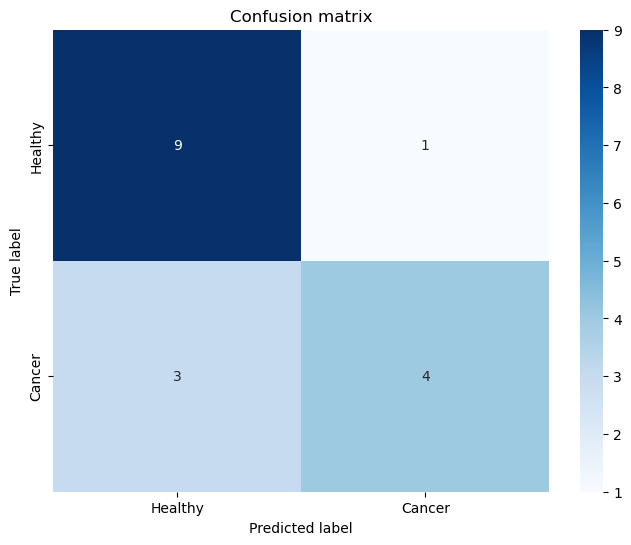

In [281]:
plot_confusion_matrix(cm, classes=['Healthy', 'Cancer'])

#### MobileNetV3Large Transfer Learning 

In [282]:
def build_mobilenet_bin_lt(input_shape, num_classes):
    base_model = MobileNetV3Large(weights="imagenet", include_top=False, input_shape=(224, 224,3))

    for layer in base_model.layers:
        layer.trainable = False
    
    x = base_model.output
    x = GlobalAveragePooling2D()(x)
    x = Dense(512, activation='relu')(x)
    x = Dense(1024, activation='relu')(x)
    x = Dropout(0.3)(x) 
    output = Dense(1, activation="sigmoid", name="output")(x)
    model = Model(inputs=base_model.input, outputs=output)
    
    #optimizer = Adam(learning_rate=0.0001)
    #model.compile(optimizer=optimizer, loss='binary_crossentropy', metrics=['accuracy'])
    
    return model

In [283]:
input_shape = (224, 224, 3)
num_classes = 2

mobilenet_lt = build_mobilenet_bin_lt(input_shape, num_classes)
optimizer = Adam(learning_rate=0.0001)
mobilenet_lt.compile(optimizer=optimizer, loss='binary_crossentropy', metrics=['accuracy'])


In [284]:
history_mobilenet_tl_1 = mobilenet_lt.fit(
    train_gen_tl,
    #steps_per_epoch=len(df_train)//batch_size,
    validation_data=val_gen_tl,
    #validation_steps=len(df_val)//batch_size,
    epochs=50,
    #class_weight = train_class_weights
)

Epoch 1/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 29s 45ms/step - accuracy: 0.7961 - loss: 0.4534 - val_accuracy: 0.9030 - val_loss: 0.2691
Epoch 2/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 7s 17ms/step - accuracy: 0.9168 - loss: 0.2334 - val_accuracy: 0.8970 - val_loss: 0.2575
Epoch 3/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 7s 17ms/step - accuracy: 0.9115 - loss: 0.2054 - val_accuracy: 0.8848 - val_loss: 0.2502
Epoch 4/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 7s 17ms/step - accuracy: 0.9522 - loss: 0.1592 - val_accuracy: 0.9273 - val_loss: 0.1798
Epoch 5/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 7s 17ms/step - accuracy: 0.9572 - loss: 0.1106 - val_accuracy: 0.9455 - val_loss: 0.1324
Epoch 6/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 7s 17ms/step - accuracy: 0.9852 - loss: 0.0683 - val_accuracy: 0.9697 - val_loss: 0.1100
Epoch 7/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 6s 17ms/step - accuracy: 0.9854 - loss: 0.0510 - val_accuracy: 0.9636 - val_loss: 0.0979
Epoch 8/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 7s 17ms/step - accuracy: 0.9950 - loss: 0.0253 - val_acc

In [285]:
mobilenet_lt.save_weights('/home/ec2-user/teza-folder/models_weights/mobilenet_bin.weights.h5')

In [286]:
def build_mobilenet_bin_v2(input_shape, num_classes):
    base_model = MobileNetV3Large(weights="imagenet", include_top=False, input_shape=(224, 224,3))

    for layer in base_model.layers:
        layer.trainable = False
    
    for layer in base_model.layers[-8:]:
        layer.trainable = True
    
    x = base_model.output
    x = GlobalAveragePooling2D()(x)
    x = Dense(512, activation='relu')(x)
    x = Dense(1024, activation='relu')(x)
    x = Dropout(0.3)(x) 
    output = Dense(1, activation="sigmoid", name="output")(x)
    model = Model(inputs=base_model.input, outputs=output)
    
    #optimizer = Adam(learning_rate=0.0001)
    #model.compile(optimizer=optimizer, loss='binary_crossentropy', metrics=['accuracy'])
    
    return model

In [287]:
input_shape = (224, 224, 3)
num_classes = 2
new_mobilenet_tl = build_mobilenet_bin_v2(input_shape, num_classes)

In [288]:
new_mobilenet_tl.load_weights('/home/ec2-user/teza-folder/models_weights/mobilenet_bin.weights.h5')

In [289]:
optimizer = Adam(learning_rate=0.000001)
new_mobilenet_tl.compile(optimizer=optimizer, loss='binary_crossentropy', metrics=['accuracy'])


In [290]:
history_mobilenet_bin_tl_1  = new_mobilenet_tl.fit(
    train_generator1,
    #steps_per_epoch=len(df_train)//batch_size,
    validation_data=val_generator1,
    #validation_steps=len(df_val)//batch_size,
    epochs=30,
    #class_weight = train_class_weights
)

Epoch 1/30
57/57 ━━━━━━━━━━━━━━━━━━━━ 21s 129ms/step - accuracy: 0.5815 - loss: 3.9434 - val_accuracy: 0.2727 - val_loss: 1.2968
Epoch 2/30
57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.6450 - loss: 2.1971 - val_accuracy: 0.2727 - val_loss: 0.8578
Epoch 3/30
57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step - accuracy: 0.6591 - loss: 1.0133 - val_accuracy: 0.2727 - val_loss: 0.7827
Epoch 4/30
57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.7550 - loss: 0.5620 - val_accuracy: 0.3636 - val_loss: 0.7379
Epoch 5/30
57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step - accuracy: 0.5964 - loss: 0.6100 - val_accuracy: 0.4545 - val_loss: 0.6994
Epoch 6/30
57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.6799 - loss: 0.6236 - val_accuracy: 0.5455 - val_loss: 0.6750
Epoch 7/30
57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.6693 - loss: 0.6158 - val_accuracy: 0.6364 - val_loss: 0.6617
Epoch 8/30
57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.7241 - loss: 0.5287 - val_accuracy: 0.6970 -

In [291]:
loss_tl_mob, accuracy_tl_mob = new_mobilenet_tl.evaluate(test_generator1)

9/9 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - accuracy: 0.6473 - loss: 0.6750


In [292]:
y_true, y_pred, cm, cr  = evaluate_model1(new_mobilenet_tl, test_generator1)
print(cr)

1/1 ━━━━━━━━━━━━━━━━━━━━ 4s 4s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 4s 4s/step
              precision    recall  f1-score   support

     Class 0       0.59      1.00      0.74        10
     Class 1       0.00      0.00      0.00         7

    accuracy                           0.59        17
   macro avg       0.29      0.50      0.37        17
weighted avg       0.35      0.59      0.44        17



/home/ec2-user/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/ec2-user/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/ec2-user/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


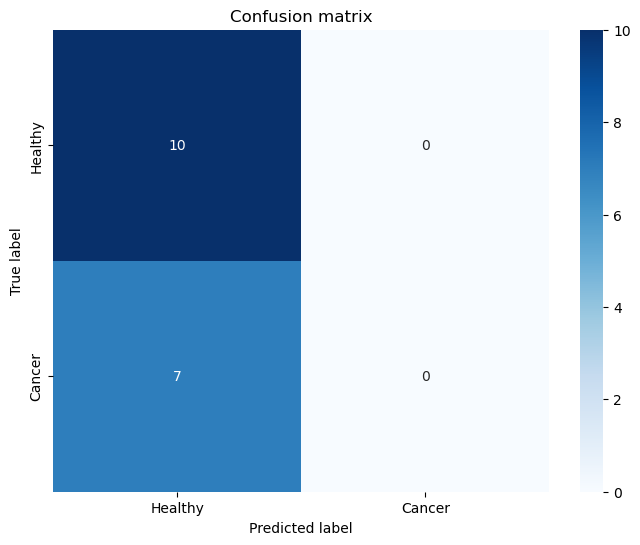

In [293]:
plot_confusion_matrix(cm, classes=['Healthy', 'Cancer'])

#### Transfer Learning - Trained from 0

#### CNN

In [294]:
input_shape = (224, 224, 3)
num_classes = 2
new_cnn_tl_new = build_2d_cnn_bin(input_shape, num_classes)

/home/ec2-user/anaconda3/lib/python3.11/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


In [295]:
new_cnn_tl_new.load_weights('/home/ec2-user/teza-folder/models_weights/cnn_bin.weights.h5')

In [296]:
new_cnn_tl_new.compile(optimizer=Adam(learning_rate=0.0001), loss='binary_crossentropy',  metrics=['accuracy'])

In [297]:
history_cnn_bin_tl_new  = new_cnn_tl_new.fit(
    train_generator1,
    #steps_per_epoch=len(df_train)//batch_size,
    validation_data=val_generator1,
    #validation_steps=len(df_val)//batch_size,
    epochs=50,
    #class_weight = train_class_weights
)

Epoch 1/50
67/67 ━━━━━━━━━━━━━━━━━━━━ 11s 60ms/step - accuracy: 0.8510 - loss: 0.3787 - val_accuracy: 0.8421 - val_loss: 0.4226
Epoch 2/50
67/67 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step - accuracy: 0.8185 - loss: 0.3967 - val_accuracy: 0.8684 - val_loss: 0.2886
Epoch 3/50
67/67 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step - accuracy: 0.8250 - loss: 0.3967 - val_accuracy: 0.7632 - val_loss: 0.4739
Epoch 4/50
67/67 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step - accuracy: 0.8718 - loss: 0.3760 - val_accuracy: 0.7895 - val_loss: 0.3571
Epoch 5/50
67/67 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step - accuracy: 0.8293 - loss: 0.3981 - val_accuracy: 0.6842 - val_loss: 0.4979
Epoch 6/50
67/67 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step - accuracy: 0.8276 - loss: 0.3808 - val_accuracy: 0.8947 - val_loss: 0.2448
Epoch 7/50
67/67 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step - accuracy: 0.8057 - loss: 0.4340 - val_accuracy: 0.7632 - val_loss: 0.4601
Epoch 8/50
67/67 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step - accuracy: 0.8446 - loss: 0.3934 - val_accuracy: 0.8947 - 

In [298]:
loss_tl, accuracy_tl = new_cnn_tl_new.evaluate(test_generator1)

10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - accuracy: 0.8227 - loss: 0.7984


In [299]:
y_true, y_pred, cm, cr  = evaluate_model1(new_cnn_tl_new, test_generator1)
print(cr)

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 469ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 476ms/step
              precision    recall  f1-score   support

     Class 0       0.80      0.89      0.84         9
     Class 1       0.89      0.80      0.84        10

    accuracy                           0.84        19
   macro avg       0.84      0.84      0.84        19
weighted avg       0.85      0.84      0.84        19



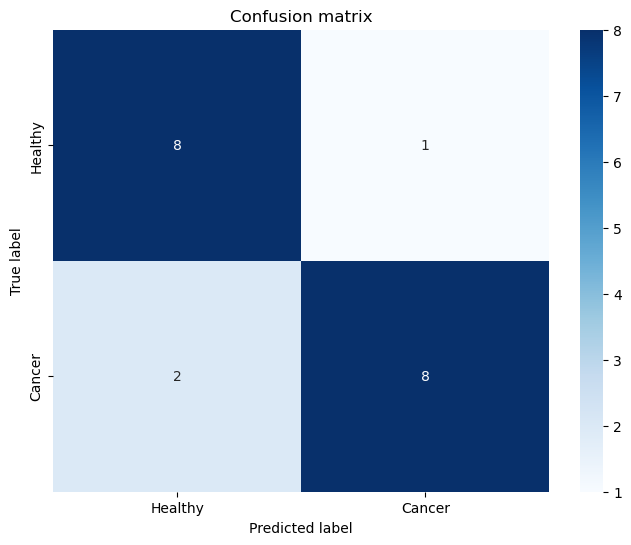

In [300]:
plot_confusion_matrix(cm, classes=['Healthy', 'Cancer'])

#### VGG19


In [301]:
def build_vgg119_bin_ct_new(input_shape, num_classes):
    base_model = VGG19( include_top=False, input_shape=(224, 224,3))

    for layer in base_model.layers:
        layer.trainable = False
    
    x = base_model.output
    x = GlobalAveragePooling2D()(x)
    x = Dense(512, activation='relu')(x)
    x = Dense(1024, activation='relu')(x)
    x = Dropout(0.3)(x) 
    output = Dense(1, activation="sigmoid", name="output")(x)
    model = Model(inputs=base_model.input, outputs=output)
    
    #optimizer = Adam(learning_rate=0.0001)
    #model.compile(optimizer=optimizer, loss='binary_crossentropy', metrics=['accuracy'])
    
    return model

In [302]:
input_shape = (224, 224, 3)
num_classes = 2

model_vgg19_tl_v2 = build_vgg119_bin_ct_new(input_shape, num_classes)
optimizer = Adam(learning_rate=0.0001)
model_vgg19_tl_v2.compile(optimizer=optimizer, loss='binary_crossentropy', metrics=['accuracy'])
    

In [303]:
history_vgg19_tl_v2 = model_vgg19_tl_v2.fit(
    train_gen_tl,
    #steps_per_epoch=len(df_train)//batch_size,
    validation_data=val_gen_tl,
    #validation_steps=len(df_val)//batch_size,
    epochs=50,
    #class_weight = train_class_weights
)

Epoch 1/50


/home/ec2-user/anaconda3/lib/python3.11/site-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


384/384 ━━━━━━━━━━━━━━━━━━━━ 13s 24ms/step - accuracy: 0.7792 - loss: 0.6065 - val_accuracy: 0.8909 - val_loss: 0.3348
Epoch 2/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 7s 17ms/step - accuracy: 0.8694 - loss: 0.3463 - val_accuracy: 0.8909 - val_loss: 0.2889
Epoch 3/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 6s 16ms/step - accuracy: 0.8861 - loss: 0.2784 - val_accuracy: 0.9394 - val_loss: 0.1213
Epoch 4/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 7s 17ms/step - accuracy: 0.9470 - loss: 0.1222 - val_accuracy: 0.9515 - val_loss: 0.1396
Epoch 5/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 6s 16ms/step - accuracy: 0.9643 - loss: 0.0950 - val_accuracy: 0.9455 - val_loss: 0.1474
Epoch 6/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 6s 16ms/step - accuracy: 0.9787 - loss: 0.0618 - val_accuracy: 0.9515 - val_loss: 0.0985
Epoch 7/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 6s 16ms/step - accuracy: 0.9876 - loss: 0.0388 - val_accuracy: 0.9636 - val_loss: 0.0670
Epoch 8/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 6s 16ms/step - accuracy: 0.9832 - loss: 0.0485 - val_accuracy: 0.95

In [304]:
model_vgg19_tl_v2.save_weights('/home/ec2-user/teza-folder/models_weights/vgg19_bin_notpre.weights.h5')

In [305]:
def build_vgg119_bin_tl_new(input_shape, num_classes):
    base_model = VGG19( include_top=False, input_shape=(224, 224,3))

    for layer in base_model.layers:
        layer.trainable = False
    for layer in base_model.layers[-8:]:
        layer.trainable = True
    
    x = base_model.output
    x = GlobalAveragePooling2D()(x)
    x = Dense(512, activation='relu')(x)
    x = Dense(1024, activation='relu')(x)
    x = Dropout(0.3)(x) 
    output = Dense(1, activation="sigmoid", name="output")(x)
    model = Model(inputs=base_model.input, outputs=output)
    
    #optimizer = Adam(learning_rate=0.0001)
    #model.compile(optimizer=optimizer, loss='binary_crossentropy', metrics=['accuracy'])
    
    return model

In [306]:
input_shape = (224, 224, 3)
num_classes = 2
new_vgg19_tl_new = build_vgg119_bin_tl_new(input_shape, num_classes)

In [307]:
new_vgg19_tl_new.load_weights('/home/ec2-user/teza-folder/models_weights/vgg19_bin_notpre.weights.h5')

In [308]:
optimizer = Adam(learning_rate=0.0001)
new_vgg19_tl_new.compile(optimizer=optimizer, loss='binary_crossentropy', metrics=['accuracy'])

In [309]:
history_vgg19_bin_tl_new  = new_vgg19_tl_new.fit(
    train_generator1,
    #steps_per_epoch=len(df_train)//batch_size,
    validation_data=val_generator1,
    #validation_steps=len(df_val)//batch_size,
    epochs=50,
    #class_weight = train_class_weights
)

Epoch 1/50
57/57 ━━━━━━━━━━━━━━━━━━━━ 8s 42ms/step - accuracy: 0.5041 - loss: 1.0843 - val_accuracy: 0.7273 - val_loss: 0.6465
Epoch 2/50
57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - accuracy: 0.6378 - loss: 0.7588 - val_accuracy: 0.8485 - val_loss: 0.4822
Epoch 3/50
57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - accuracy: 0.7717 - loss: 0.7443 - val_accuracy: 0.7273 - val_loss: 0.5696
Epoch 4/50
57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - accuracy: 0.6407 - loss: 0.5574 - val_accuracy: 0.7273 - val_loss: 0.4352
Epoch 5/50
57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - accuracy: 0.8568 - loss: 0.3716 - val_accuracy: 0.8485 - val_loss: 0.3966
Epoch 6/50
57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - accuracy: 0.8213 - loss: 0.3700 - val_accuracy: 0.6364 - val_loss: 0.6509
Epoch 7/50
57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - accuracy: 0.8509 - loss: 0.3310 - val_accuracy: 0.8788 - val_loss: 0.3753
Epoch 8/50
57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - accuracy: 0.8841 - loss: 0.3763 - val_accuracy: 0.7879 - v

In [310]:
loss_tl, accuracy_tl = new_vgg19_tl_new.evaluate(test_generator1)

9/9 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - accuracy: 0.8714 - loss: 37.3996   


In [311]:
y_true, y_pred, cm, cr  = evaluate_model1(new_vgg19_tl_new, test_generator1)
print(cr)

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 490ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 506ms/step
              precision    recall  f1-score   support

     Class 0       0.83      1.00      0.91        10
     Class 1       1.00      0.71      0.83         7

    accuracy                           0.88        17
   macro avg       0.92      0.86      0.87        17
weighted avg       0.90      0.88      0.88        17



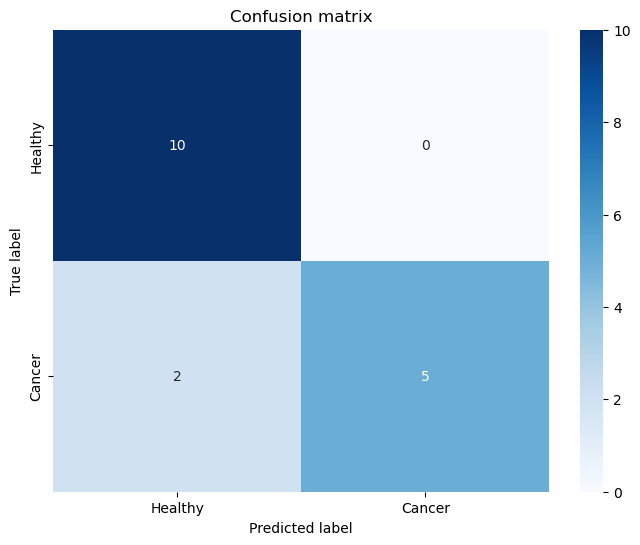

In [312]:
plot_confusion_matrix(cm, classes=['Healthy', 'Cancer'])

#### InceptionV3

In [313]:
def build_inc_bin_tl(input_shape, num_classes):
    base_model = InceptionV3(include_top=False, input_shape=(224, 224,3))

    for layer in base_model.layers:
        layer.trainable = False
    
    x = base_model.output
    x = GlobalAveragePooling2D()(x)
    x = Dense(512, activation='relu')(x)
    x = Dense(1024, activation='relu')(x)
    x = Dropout(0.3)(x) 
    output = Dense(1, activation="sigmoid", name="output")(x)
    model = Model(inputs=base_model.input, outputs=output)
    
   # optimizer = Adam(learning_rate=0.0001)
   # model.compile(optimizer=optimizer, loss='binary_crossentropy', metrics=['accuracy'])
    
    return model

In [314]:
input_shape = (224, 224, 3)
num_classes = 2

model_inc_tl_new = build_inc_bin_tl(input_shape, num_classes)
optimizer = Adam(learning_rate=0.0001)
model_inc_tl_new.compile(optimizer=optimizer, loss='binary_crossentropy', metrics=['accuracy'])
    

In [315]:
history_inc_tl_new = model_inc_tl_new.fit(
    train_gen_tl,
    #steps_per_epoch=len(df_train)//batch_size,
    validation_data=val_gen_tl,
    #validation_steps=len(df_val)//batch_size,
    epochs=50,
    #class_weight = train_class_weights
)

Epoch 1/50


/home/ec2-user/anaconda3/lib/python3.11/site-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()
I0000 00:00:1722545225.054920   45512 service.cc:145] XLA service 0x7f7d000177d0 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
I0000 00:00:1722545225.054968   45512 service.cc:153]   StreamExecutor device (0): Tesla V100-SXM2-16GB, Compute Capability 7.0
I0000 00:00:1722545225.054973   45512 service.cc:153]   StreamExecutor device (1): Tesla V100-SXM2-16GB, Compute Capability 7.0
I0000 00:00:1722545225.054977   45512 service.cc:153]   StreamExecutor device (2): Tesla V100-SXM2-16GB, Compute Capability 7.0
I0000 00:00:1722545225.054980   45512 service.cc:153]   Strea

  1/384 ━━━━━━━━━━━━━━━━━━━━ 1:31:51 14s/step - accuracy: 1.0000 - loss: 0.0042

I0000 00:00:1722545231.563394   45512 device_compiler.h:188] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


384/384 ━━━━━━━━━━━━━━━━━━━━ 35s 54ms/step - accuracy: 0.6180 - loss: 5.2021 - val_accuracy: 0.7091 - val_loss: 2.2065
Epoch 2/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 6s 16ms/step - accuracy: 0.7186 - loss: 1.8173 - val_accuracy: 0.7394 - val_loss: 0.8790
Epoch 3/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 6s 16ms/step - accuracy: 0.7581 - loss: 0.9657 - val_accuracy: 0.8545 - val_loss: 0.3467
Epoch 4/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 6s 16ms/step - accuracy: 0.7722 - loss: 0.7082 - val_accuracy: 0.8727 - val_loss: 0.3220
Epoch 5/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 6s 16ms/step - accuracy: 0.8189 - loss: 0.4664 - val_accuracy: 0.7515 - val_loss: 0.6650
Epoch 6/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 6s 16ms/step - accuracy: 0.8398 - loss: 0.4587 - val_accuracy: 0.8485 - val_loss: 0.3394
Epoch 7/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 6s 16ms/step - accuracy: 0.8581 - loss: 0.3560 - val_accuracy: 0.8909 - val_loss: 0.2719
Epoch 8/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 6s 16ms/step - accuracy: 0.9046 - loss: 0.2549 - val_accuracy: 0.87

In [316]:
model_inc_tl_new.save_weights('/home/ec2-user/teza-folder/models_weights/inc_bin_notpre.weights.h5')

In [317]:
def build_inc_bin_v2_new(input_shape, num_classes):
    base_model = InceptionV3(include_top=False, input_shape=(224, 224,3))

    for layer in base_model.layers:
        layer.trainable = False
    
    for layer in base_model.layers[-8:]:
        layer.trainable = True
    
    x = base_model.output
    x = GlobalAveragePooling2D()(x)
    x = Dense(512, activation='relu')(x)
    x = Dense(1024, activation='relu')(x)
    x = Dropout(0.3)(x) 
    output = Dense(1, activation="sigmoid", name="output")(x)
    model = Model(inputs=base_model.input, outputs=output)
    
    #optimizer = Adam(learning_rate=0.0001)
    #model.compile(optimizer=optimizer, loss='binary_crossentropy', metrics=['accuracy'])
    
    return model

In [318]:
input_shape = (224, 224, 3)
num_classes = 2
new_inc_tl_new = build_inc_bin_v2_new(input_shape, num_classes)

In [319]:
new_inc_tl_new.load_weights('/home/ec2-user/teza-folder/models_weights/inc_bin_notpre.weights.h5')

In [320]:
optimizer = Adam(learning_rate=0.00001)
new_inc_tl_new.compile(optimizer=optimizer, loss='binary_crossentropy', metrics=['accuracy'])


In [321]:
history_inc_bin_tl_new_v2  = new_inc_tl_new.fit(
    train_generator1,
    #steps_per_epoch=len(df_train)//batch_size,
    validation_data=val_generator1,
    #validation_steps=len(df_val)//batch_size,
    epochs=50,
    #class_weight = train_class_weights
)

Epoch 1/50


/home/ec2-user/anaconda3/lib/python3.11/site-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


67/67 ━━━━━━━━━━━━━━━━━━━━ 25s 163ms/step - accuracy: 0.6841 - loss: 0.6048 - val_accuracy: 0.7368 - val_loss: 0.5720
Epoch 2/50
67/67 ━━━━━━━━━━━━━━━━━━━━ 1s 14ms/step - accuracy: 0.6983 - loss: 0.6041 - val_accuracy: 0.7105 - val_loss: 0.5484
Epoch 3/50
67/67 ━━━━━━━━━━━━━━━━━━━━ 1s 14ms/step - accuracy: 0.7630 - loss: 0.5046 - val_accuracy: 0.7368 - val_loss: 0.5276
Epoch 4/50
67/67 ━━━━━━━━━━━━━━━━━━━━ 1s 14ms/step - accuracy: 0.7285 - loss: 0.5412 - val_accuracy: 0.7632 - val_loss: 0.5079
Epoch 5/50
67/67 ━━━━━━━━━━━━━━━━━━━━ 1s 14ms/step - accuracy: 0.7910 - loss: 0.4687 - val_accuracy: 0.7895 - val_loss: 0.4852
Epoch 6/50
67/67 ━━━━━━━━━━━━━━━━━━━━ 1s 14ms/step - accuracy: 0.8129 - loss: 0.4084 - val_accuracy: 0.7895 - val_loss: 0.4641
Epoch 7/50
67/67 ━━━━━━━━━━━━━━━━━━━━ 1s 14ms/step - accuracy: 0.7892 - loss: 0.4358 - val_accuracy: 0.8158 - val_loss: 0.4411
Epoch 8/50
67/67 ━━━━━━━━━━━━━━━━━━━━ 1s 14ms/step - accuracy: 0.8880 - loss: 0.3363 - val_accuracy: 0.8158 - val_loss: 

In [322]:
loss_tl_inc, accuracy_tl_inc = new_inc_tl_new.evaluate(test_generator1)

10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - accuracy: 0.8784 - loss: 0.2370


/home/ec2-user/anaconda3/lib/python3.11/site-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


In [323]:
y_true, y_pred, cm, cr  = evaluate_model1(new_inc_tl_new, test_generator1)
print(cr)

1/1 ━━━━━━━━━━━━━━━━━━━━ 5s 5s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
              precision    recall  f1-score   support

     Class 0       1.00      0.79      0.88        14
     Class 1       0.67      1.00      0.80         6

    accuracy                           0.85        20
   macro avg       0.83      0.89      0.84        20
weighted avg       0.90      0.85      0.86        20



In [324]:
def plot_confusion_matrix(cm, classes, title='Confusion matrix', cmap=plt.cm.Blues):
    plt.figure(figsize=(8, 6))
    sns.heatmap(cm, annot=True, fmt='d', cmap=cmap, xticklabels=classes, yticklabels=classes)
    plt.title(title)
    plt.ylabel('True label')
    plt.xlabel('Predicted label')
    plt.show()

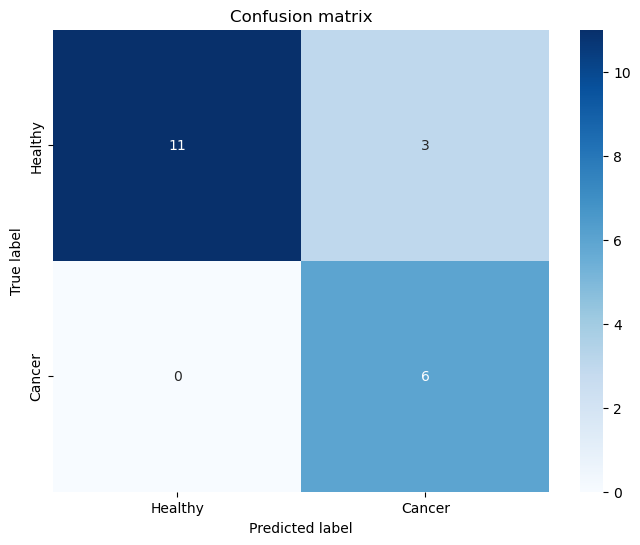

In [325]:
plot_confusion_matrix(cm, classes=['Healthy', 'Cancer'])

#### MobileNetV3Large

In [326]:
def build_mob_bin_tl(input_shape, num_classes):
    base_model = MobileNetV3Large(include_top=False, input_shape=(224, 224,3))

    for layer in base_model.layers:
        layer.trainable = False
    
    x = base_model.output
    x = GlobalAveragePooling2D()(x)
    x = Dense(512, activation='relu')(x)
    x = Dense(1024, activation='relu')(x)
    x = Dropout(0.3)(x) 
    output = Dense(1, activation="sigmoid", name="output")(x)
    model = Model(inputs=base_model.input, outputs=output)
    
   # optimizer = Adam(learning_rate=0.0001)
   # model.compile(optimizer=optimizer, loss='binary_crossentropy', metrics=['accuracy'])
    
    return model

In [327]:
input_shape = (224, 224, 3)
num_classes = 2

model_mob_tl_new = build_mob_bin_tl(input_shape, num_classes)
optimizer = Adam(learning_rate=0.0001)
model_mob_tl_new.compile(optimizer=optimizer, loss='binary_crossentropy', metrics=['accuracy'])
    

In [328]:
history_mob_tl_new = model_mob_tl_new.fit(
    train_gen_tl,
    #steps_per_epoch=len(df_train)//batch_size,
    validation_data=val_gen_tl,
    #validation_steps=len(df_val)//batch_size,
    epochs=50,
    #class_weight = train_class_weights
)

Epoch 1/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 27s 40ms/step - accuracy: 0.7833 - loss: 0.4237 - val_accuracy: 0.9030 - val_loss: 0.2647
Epoch 2/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 7s 17ms/step - accuracy: 0.8955 - loss: 0.2528 - val_accuracy: 0.8788 - val_loss: 0.2822
Epoch 3/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 7s 17ms/step - accuracy: 0.9232 - loss: 0.1761 - val_accuracy: 0.9394 - val_loss: 0.1518
Epoch 4/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 6s 17ms/step - accuracy: 0.9399 - loss: 0.1484 - val_accuracy: 0.9152 - val_loss: 0.1729
Epoch 5/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 7s 17ms/step - accuracy: 0.9570 - loss: 0.1144 - val_accuracy: 0.9576 - val_loss: 0.1208
Epoch 6/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 6s 16ms/step - accuracy: 0.9727 - loss: 0.0722 - val_accuracy: 0.9697 - val_loss: 0.0980
Epoch 7/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 7s 17ms/step - accuracy: 0.9751 - loss: 0.0508 - val_accuracy: 0.9758 - val_loss: 0.0896
Epoch 8/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 6s 16ms/step - accuracy: 0.9980 - loss: 0.0277 - val_acc

In [329]:
model_mob_tl_new.save_weights('/home/ec2-user/teza-folder/models_weights/mobilenet_bin_notpre.weights.h5')

In [330]:
def build_mobilenet_bin_v2_new(input_shape, num_classes):
    base_model = MobileNetV3Large(include_top=False, input_shape=(224, 224,3))

    for layer in base_model.layers:
        layer.trainable = False
    
    for layer in base_model.layers[-8:]:
        layer.trainable = True
    
    x = base_model.output
    x = GlobalAveragePooling2D()(x)
    x = Dense(512, activation='relu')(x)
    x = Dense(1024, activation='relu')(x)
    x = Dropout(0.3)(x) 
    output = Dense(1, activation="sigmoid", name="output")(x)
    model = Model(inputs=base_model.input, outputs=output)
    
    #optimizer = Adam(learning_rate=0.0001)
    #model.compile(optimizer=optimizer, loss='binary_crossentropy', metrics=['accuracy'])
    
    return model

In [331]:
input_shape = (224, 224, 3)
num_classes = 2
new_mobilenet_tl_new = build_mobilenet_bin_v2_new(input_shape, num_classes)

In [332]:
new_mobilenet_tl_new.load_weights('/home/ec2-user/teza-folder/models_weights/mobilenet_bin_notpre.weights.h5')

In [333]:
optimizer = Adam(learning_rate=0.00001)
new_mobilenet_tl_new.compile(optimizer=optimizer, loss='binary_crossentropy', metrics=['accuracy'])


In [334]:
history_mobilenet_bin_tl_new_v2  = new_mobilenet_tl_new.fit(
    train_generator1,
    #steps_per_epoch=len(df_train)//batch_size,
    validation_data=val_generator1,
    #validation_steps=len(df_val)//batch_size,
    epochs=50,
    #class_weight = train_class_weights
)

Epoch 1/50
57/57 ━━━━━━━━━━━━━━━━━━━━ 18s 101ms/step - accuracy: 0.9535 - loss: 0.1690 - val_accuracy: 0.6364 - val_loss: 0.6112
Epoch 2/50
57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step - accuracy: 0.8450 - loss: 0.3292 - val_accuracy: 0.6667 - val_loss: 0.6034
Epoch 3/50
57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.8924 - loss: 0.2429 - val_accuracy: 0.6667 - val_loss: 0.6021
Epoch 4/50
57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.8608 - loss: 0.2837 - val_accuracy: 0.6364 - val_loss: 0.6064
Epoch 5/50
57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.9102 - loss: 0.2168 - val_accuracy: 0.5152 - val_loss: 0.6861
Epoch 6/50
57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step - accuracy: 0.8581 - loss: 0.3060 - val_accuracy: 0.6667 - val_loss: 0.5821
Epoch 7/50
57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.9012 - loss: 0.2622 - val_accuracy: 0.6667 - val_loss: 0.5569
Epoch 8/50
57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.9486 - loss: 0.1787 - val_accuracy: 0.5758 -

In [335]:
loss_tl_mob, accuracy_tl_mob = new_mobilenet_tl_new.evaluate(test_generator1)

9/9 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - accuracy: 0.8027 - loss: 1.3170


In [336]:
y_true, y_pred, cm, cr  = evaluate_model1(new_mobilenet_tl_new, test_generator1)
print(cr)

1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step
              precision    recall  f1-score   support

     Class 0       0.80      0.80      0.80        10
     Class 1       0.71      0.71      0.71         7

    accuracy                           0.76        17
   macro avg       0.76      0.76      0.76        17
weighted avg       0.76      0.76      0.76        17



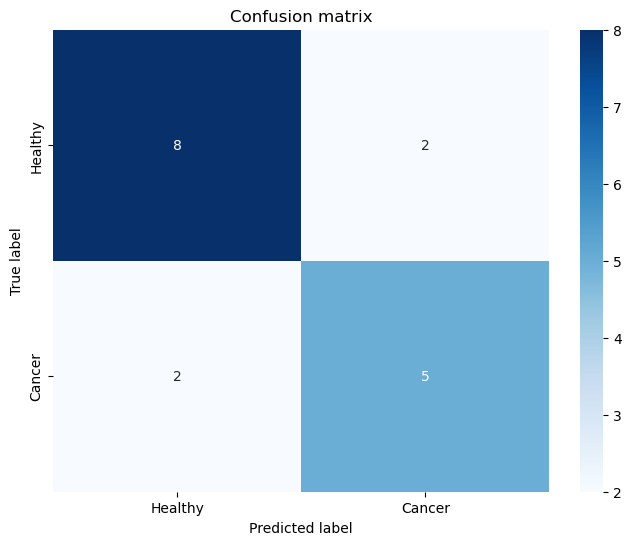

In [337]:
plot_confusion_matrix(cm, classes=['Healthy', 'Cancer'])

In [338]:
input_shape = (224, 224, 3)
num_classes = 2
new_mobilenet_tl_new1 = build_mobilenet_bin_v2_new(input_shape, num_classes)

new_mobilenet_tl_new1.load_weights('/home/ec2-user/teza-folder/models_weights/mobilenet_bin_notpre.weights.h5')

In [339]:
optimizer = Adam(learning_rate=0.0001)
new_mobilenet_tl_new1.compile(optimizer=optimizer, loss='binary_crossentropy', metrics=['accuracy'])


In [340]:
history_mobilenet_bin_tl_new_v2  = new_mobilenet_tl_new1.fit(
    train_generator1,
    #steps_per_epoch=len(df_train)//batch_size,
    validation_data=val_generator1,
    #validation_steps=len(df_val)//batch_size,
    epochs=50,
    #class_weight = train_class_weights
)

Epoch 1/50
57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step - accuracy: 0.8779 - loss: 0.3348 - val_accuracy: 0.3030 - val_loss: 1.2427
Epoch 2/50
57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step - accuracy: 0.8665 - loss: 0.2905 - val_accuracy: 0.2727 - val_loss: 1.5970
Epoch 3/50
57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.9300 - loss: 0.2015 - val_accuracy: 0.3939 - val_loss: 1.1734
Epoch 4/50
57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.7793 - loss: 0.3934 - val_accuracy: 0.4242 - val_loss: 0.9273
Epoch 5/50
57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.8742 - loss: 0.3528 - val_accuracy: 0.4242 - val_loss: 1.1768
Epoch 6/50
57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.7998 - loss: 0.4423 - val_accuracy: 0.3939 - val_loss: 1.3205
Epoch 7/50
57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.8184 - loss: 0.3783 - val_accuracy: 0.4545 - val_loss: 0.9380
Epoch 8/50
57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.8944 - loss: 0.2914 - val_accuracy: 0.3636 - va

In [341]:
loss_tl_mob, accuracy_tl_mob = new_mobilenet_tl_new1.evaluate(test_generator1)

9/9 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - accuracy: 0.8027 - loss: 1.1416


In [342]:
y_true, y_pred, cm, cr  = evaluate_model1(new_mobilenet_tl_new1, test_generator1)
print(cr)

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
              precision    recall  f1-score   support

     Class 0       0.80      0.80      0.80        10
     Class 1       0.71      0.71      0.71         7

    accuracy                           0.76        17
   macro avg       0.76      0.76      0.76        17
weighted avg       0.76      0.76      0.76        17



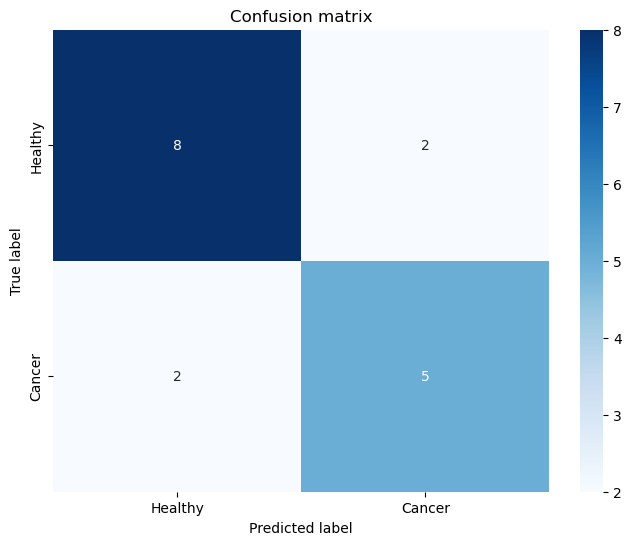

In [343]:
plot_confusion_matrix(cm, classes=['Healthy', 'Cancer'])

#### ResNet50

In [344]:
def build_resnet_bin_tl_new_v2(input_shape, num_classes):
    base_model = ResNet50(include_top=False, input_shape=(224, 224,3))

    for layer in base_model.layers:
        layer.trainable = False
    
    x = base_model.output
    x = GlobalAveragePooling2D()(x)
    x = Dense(512, activation='relu')(x)
    x = Dense(1024, activation='relu')(x)
    x = Dropout(0.3)(x) 
    output = Dense(1, activation="sigmoid", name="output")(x)
    model = Model(inputs=base_model.input, outputs=output)
    
   # optimizer = Adam(learning_rate=0.0001)
   # model.compile(optimizer=optimizer, loss='binary_crossentropy', metrics=['accuracy'])
    
    return model

In [345]:
input_shape = (224, 224, 3)
num_classes = 2

model_resnet_tl2 = build_resnet_bin_tl_new_v2(input_shape, num_classes)
optimizer = Adam(learning_rate=0.0001)
model_resnet_tl2.compile(optimizer=optimizer, loss='binary_crossentropy', metrics=['accuracy'])
    

In [346]:
history_resnet_tl_1 = model_resnet_tl2.fit(
    train_gen_tl,
    #steps_per_epoch=len(df_train)//batch_size,
    validation_data=val_gen_tl,
    #validation_steps=len(df_val)//batch_size,
    epochs=50,
    #class_weight = train_class_weights
)

Epoch 1/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 26s 39ms/step - accuracy: 0.7583 - loss: 0.4581 - val_accuracy: 0.9030 - val_loss: 0.2178
Epoch 2/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 7s 18ms/step - accuracy: 0.8951 - loss: 0.2369 - val_accuracy: 0.9273 - val_loss: 0.1962
Epoch 3/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 7s 17ms/step - accuracy: 0.9161 - loss: 0.1952 - val_accuracy: 0.9394 - val_loss: 0.1282
Epoch 4/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 7s 18ms/step - accuracy: 0.9345 - loss: 0.1473 - val_accuracy: 0.9697 - val_loss: 0.1109
Epoch 5/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 7s 18ms/step - accuracy: 0.9531 - loss: 0.1309 - val_accuracy: 0.9091 - val_loss: 0.2028
Epoch 6/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 7s 18ms/step - accuracy: 0.9643 - loss: 0.1015 - val_accuracy: 0.9636 - val_loss: 0.0766
Epoch 7/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 7s 18ms/step - accuracy: 0.9707 - loss: 0.0878 - val_accuracy: 0.9818 - val_loss: 0.0624
Epoch 8/50
384/384 ━━━━━━━━━━━━━━━━━━━━ 7s 18ms/step - accuracy: 0.9743 - loss: 0.0771 - val_acc

In [347]:
model_resnet_tl2.save_weights('/home/ec2-user/teza-folder/models_weights/resnet_bin_notpre.weights.h5')

In [348]:
def build_resnet_bin_tl_new_v2_1(input_shape, num_classes):
    base_model = ResNet50(include_top=False, input_shape=input_shape)

    for layer in base_model.layers:
        layer.trainable = False

    for layer in base_model.layers[-8:]:
        layer.trainable = True
    
    x = base_model.output
    x = GlobalAveragePooling2D()(x)
    x = Dense(512, activation='relu')(x)
    x = Dense(1024, activation='relu')(x)
    x = Dropout(0.3)(x) 
    output = Dense(1, activation="sigmoid", name="output")(x)
    model = Model(inputs=base_model.input, outputs=output)
    
    return model


In [349]:
input_shape = (224, 224, 3)
num_classes = 2
new_resnet_tl_p2 = build_resnet_bin_tl_new_v2_1(input_shape, num_classes)

In [350]:
new_resnet_tl_p2.load_weights('/home/ec2-user/teza-folder/models_weights/resnet_bin_notpre.weights.h5')

In [351]:
optimizer = Adam(learning_rate=0.0001)
new_resnet_tl_p2.compile(optimizer=optimizer, loss='binary_crossentropy', metrics=['accuracy'])


In [352]:
history_resnet_bin_tl_v2  = new_resnet_tl_p2.fit(
    train_generator1,
    #steps_per_epoch=len(df_train)//batch_size,
    validation_data=val_generator1,
    #validation_steps=len(df_val)//batch_size,
    epochs=50,
    #class_weight = train_class_weights
)

Epoch 1/50
57/57 ━━━━━━━━━━━━━━━━━━━━ 19s 98ms/step - accuracy: 0.7132 - loss: 0.9974 - val_accuracy: 0.3333 - val_loss: 1.1787
Epoch 2/50
57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step - accuracy: 0.5604 - loss: 0.7519 - val_accuracy: 0.4848 - val_loss: 0.8933
Epoch 3/50
57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step - accuracy: 0.8083 - loss: 0.3859 - val_accuracy: 0.5758 - val_loss: 0.6549
Epoch 4/50
57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step - accuracy: 0.8270 - loss: 0.3946 - val_accuracy: 0.7879 - val_loss: 0.3996
Epoch 5/50
57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step - accuracy: 0.9317 - loss: 0.3071 - val_accuracy: 0.7273 - val_loss: 0.6134
Epoch 6/50
57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step - accuracy: 0.7851 - loss: 0.4732 - val_accuracy: 0.5152 - val_loss: 1.0938
Epoch 7/50
57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step - accuracy: 0.6722 - loss: 0.6088 - val_accuracy: 0.8182 - val_loss: 0.3727
Epoch 8/50
57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step - accuracy: 0.7772 - loss: 0.5008 - val_accuracy: 0.8182 - 

In [353]:
loss_tl_res, accuracy_tl_res = new_resnet_tl_p2.evaluate(test_generator1)

9/9 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - accuracy: 0.8279 - loss: 0.9625


In [354]:
y_true, y_pred, cm, cr  = evaluate_model1(new_resnet_tl, test_generator1)
print(cr)

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
              precision    recall  f1-score   support

     Class 0       0.73      0.80      0.76        10
     Class 1       0.67      0.57      0.62         7

    accuracy                           0.71        17
   macro avg       0.70      0.69      0.69        17
weighted avg       0.70      0.71      0.70        17



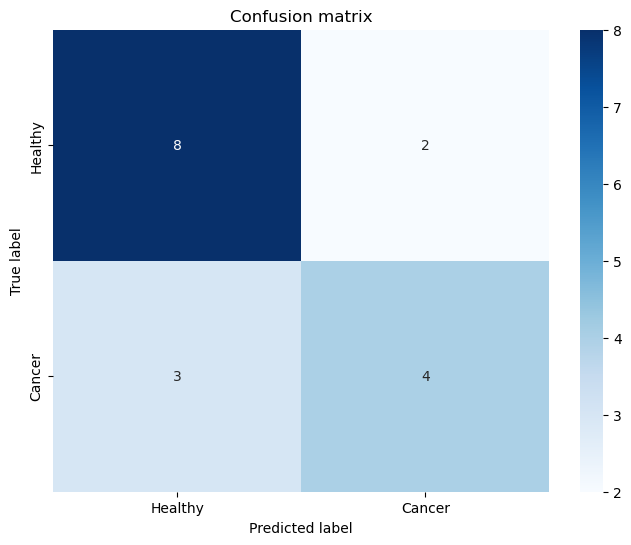

In [355]:
plot_confusion_matrix(cm, classes=['Healthy', 'Cancer'])

#### Augmentation

In [356]:
gen1 = ImageDataGenerator(rescale=1./255)

augment_gen = ImageDataGenerator(
    rotation_range=40,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True,
    fill_mode='nearest',
    rescale=1./255
)

In [357]:

save_dir = 'augmented_images/'
if not os.path.exists(save_dir):
    os.makedirs(save_dir)

num_augmentations = 700 // len(train_df_all)  
augmented_images = []
augmented_labels = []

for i, row in train_df_all.iterrows():
    img_path = row['filepaths']
    label = row['labels']
    img = load_img(img_path)
    img = img_to_array(img)
    img = img.reshape((1,) + img.shape) 

    j = 0
    for batch in augment_gen.flow(img, batch_size=1, save_to_dir=save_dir, save_prefix='aug', save_format='jpeg'):
        augmented_images.append(batch[0])
        augmented_labels.append(label)
        j += 1
        if j >= num_augmentations: 
            break

X_augmented = np.array(augmented_images)
y_augmented = np.array(augmented_labels)


In [358]:
augmented_filepaths = [os.path.join(save_dir, f) for f in os.listdir(save_dir)]
augmented_labels = [label for _ in range(len(augmented_filepaths))]  # Assuming same label distribution

aug_df = pd.DataFrame({
    'filepaths': augmented_filepaths,
    'labels': augmented_labels
})

# Combine original and augmented dataframes
combined_df = pd.concat([train_df_all, aug_df], ignore_index=True)

In [359]:
train_generator1 = gen1.flow_from_dataframe(
    combined_df,
    x_col='filepaths',
    y_col='labels',
    target_size=(224, 224),
    color_mode='rgb',
    class_mode='categorical',
    batch_size=2,
    shuffle=True
)

print(f"New training generator size: {train_generator.samples}")

Found 781 validated image filenames belonging to 4 classes.
New training generator size: 227


/home/ec2-user/anaconda3/lib/python3.11/site-packages/keras/src/legacy/preprocessing/image.py:920: UserWarning: Found 1 invalid image filename(s) in x_col="filepaths". These filename(s) will be ignored.
  warnings.warn(


In [360]:
history_vgg19_ct_aug = model_vgg19_ct.fit(
    train_generator1,
    #steps_per_epoch=len(df_train)//batch_size,
    validation_data=val_generator,
    #validation_steps=len(df_val)//batch_size,
    epochs=50,
    #class_weight = train_class_weights
)

Epoch 1/50
 15/391 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step - accuracy: 0.9778 - loss: 0.0455 

/home/ec2-user/anaconda3/lib/python3.11/site-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


391/391 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - accuracy: 0.9618 - loss: 0.0872 - val_accuracy: 0.8000 - val_loss: 0.5150
Epoch 2/50
391/391 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - accuracy: 0.9742 - loss: 0.0642 - val_accuracy: 0.8400 - val_loss: 0.3877
Epoch 3/50
391/391 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - accuracy: 0.9851 - loss: 0.0544 - val_accuracy: 0.6400 - val_loss: 0.7649
Epoch 4/50
391/391 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - accuracy: 0.9783 - loss: 0.0516 - val_accuracy: 0.6400 - val_loss: 0.8756
Epoch 5/50
391/391 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - accuracy: 0.9805 - loss: 0.0512 - val_accuracy: 0.6400 - val_loss: 0.9323
Epoch 6/50
391/391 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - accuracy: 0.9727 - loss: 0.0865 - val_accuracy: 0.8400 - val_loss: 0.3293
Epoch 7/50
391/391 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - accuracy: 0.9842 - loss: 0.0460 - val_accuracy: 0.5200 - val_loss: 1.3167
Epoch 8/50
391/391 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - accuracy: 0.9865 - loss: 0.0405 - val_accuracy: 0.8800 - val_

In [361]:
test_loss_vgg19_ct, test_accuracy_vgg19_ct = model_vgg19_ct.evaluate(test_generator)

13/13 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - accuracy: 0.7725 - loss: 0.8307


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


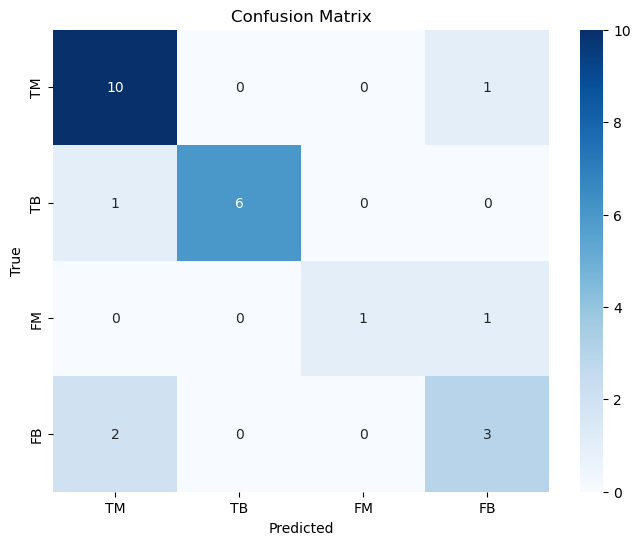

              precision  recall  f1-score  support
TM                 0.77    0.91      0.83     11.0
TB                 1.00    0.86      0.92      7.0
FM                 1.00    0.50      0.67      2.0
FB                 0.60    0.60      0.60      5.0
accuracy           0.80    0.80      0.80      0.8
macro avg          0.84    0.72      0.76     25.0
weighted avg       0.82    0.80      0.80     25.0
Per-Class Accuracy:
TM    0.77
TB    1.00
FM    1.00
FB    0.60
Name: precision, dtype: float64


In [362]:
y_true, y_pred, classes = evaluate_model(model_vgg19_ct, test_generator, label_mapping1)

In [363]:
def build_inception_ct1(input_shape, num_classes):
    base_model = InceptionV3(weights="imagenet", include_top=False, input_shape=(224, 224,3))

    for layer in base_model.layers:
        layer.trainable = False
    
    x = base_model.output
    x = GlobalAveragePooling2D()(x)
    x = Dense(128, activation='relu')(x)
    x = Dense(128, activation='relu')(x)
    x = Dense(128, activation='relu')(x)
    x = Dropout(0.15)(x)
    x = Dense(256, activation='relu')(x)
    x = Dense(256, activation='relu')(x)
    x = Dropout(0.15)(x)
    x = Dense(256, activation='relu')(x)
    x = Dropout(0.2)(x)
    x = Dense(512, activation='relu')(x)
    x = Dense(512, activation='relu')(x)
    x = Dense(512, activation='relu')(x)
    x = Dropout(0.1)(x)
    x = Dense(1024, activation='relu')(x)
    x = Dropout(0.1)(x)
    output = Dense(num_classes, activation="softmax", name="output")(x)
    model = Model(inputs=base_model.input, outputs=output)
    
    optimizer = Adam(learning_rate=0.0001)
    model.compile(optimizer=optimizer, loss='categorical_crossentropy', metrics=['accuracy'])
    
    return model

In [364]:
input_shape = (224, 224, 3)
num_classes = 4

inception_ct = build_inception_ct1(input_shape, num_classes)

In [365]:
history_inception_aug = inception_ct.fit(
    train_generator1,
    #steps_per_epoch=len(df_train)//batch_size,
    validation_data=val_generator,
    #validation_steps=len(df_val)//batch_size,
    epochs=50,
    #class_weight = train_class_weights
)

Epoch 1/50
391/391 ━━━━━━━━━━━━━━━━━━━━ 42s 56ms/step - accuracy: 0.8643 - loss: 0.5138 - val_accuracy: 0.2400 - val_loss: 1.3087
Epoch 2/50
391/391 ━━━━━━━━━━━━━━━━━━━━ 5s 12ms/step - accuracy: 0.8738 - loss: 0.3110 - val_accuracy: 0.4400 - val_loss: 1.1995
Epoch 3/50
391/391 ━━━━━━━━━━━━━━━━━━━━ 5s 12ms/step - accuracy: 0.8957 - loss: 0.2226 - val_accuracy: 0.3600 - val_loss: 1.1775
Epoch 4/50
391/391 ━━━━━━━━━━━━━━━━━━━━ 5s 12ms/step - accuracy: 0.8912 - loss: 0.2295 - val_accuracy: 0.5600 - val_loss: 1.2743
Epoch 5/50
391/391 ━━━━━━━━━━━━━━━━━━━━ 5s 11ms/step - accuracy: 0.9142 - loss: 0.2252 - val_accuracy: 0.5200 - val_loss: 0.8406
Epoch 6/50
391/391 ━━━━━━━━━━━━━━━━━━━━ 5s 12ms/step - accuracy: 0.9180 - loss: 0.1886 - val_accuracy: 0.5200 - val_loss: 1.5454
Epoch 7/50
391/391 ━━━━━━━━━━━━━━━━━━━━ 5s 12ms/step - accuracy: 0.9310 - loss: 0.1875 - val_accuracy: 0.7600 - val_loss: 0.8945
Epoch 8/50
391/391 ━━━━━━━━━━━━━━━━━━━━ 5s 12ms/step - accuracy: 0.9485 - loss: 0.1424 - val_acc

In [366]:
test_loss_inc_ct, test_accuracy_inc_ct = inception_ct.evaluate(test_generator)

13/13 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - accuracy: 0.8005 - loss: 5.0439


1/1 ━━━━━━━━━━━━━━━━━━━━ 5s 5s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 5s 5s/step


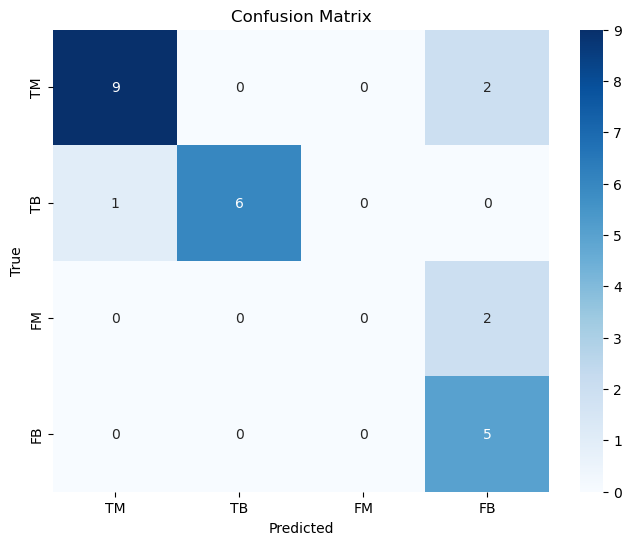

              precision  recall  f1-score  support
TM                 0.90    0.82      0.86     11.0
TB                 1.00    0.86      0.92      7.0
FM                 0.00    0.00      0.00      2.0
FB                 0.56    1.00      0.71      5.0
accuracy           0.80    0.80      0.80      0.8
macro avg          0.61    0.67      0.62     25.0
weighted avg       0.79    0.80      0.78     25.0
Per-Class Accuracy:
TM    0.90
TB    1.00
FM    0.00
FB    0.56
Name: precision, dtype: float64


/home/ec2-user/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/ec2-user/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/ec2-user/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [367]:
y_true, y_pred, classes = evaluate_model(inception_ct, test_generator, label_mapping1)

#### 5 Fold -Cross-validation

In [368]:
dataset_dir = '/home/ec2-user/teza-folder/4classes'

filepaths = []
labels = []

for root, _, files in os.walk(dataset_dir):
    for file in files:
        if file.endswith('.jpg'):
            fpath = os.path.join(root, file)
            label = file.split('_')[1]
            filepaths.append(fpath)
            labels.append(label)

FSeries = pd.Series(filepaths, name='filepaths')
LSeries = pd.Series(labels, name='labels')
df_cv = pd.concat([FSeries, LSeries], axis=1)


In [369]:
filepaths = df_cv['filepaths'].values
labels = df_cv['labels'].values
display(df_cv)

,filepaths,labels
0,/home/ec2-user/teza-folder/4classes/1402_FB_sl...,FB
1,/home/ec2-user/teza-folder/4classes/2484_FM_sl...,FM
2,/home/ec2-user/teza-folder/4classes/3099_TM_sl...,TM
3,/home/ec2-user/teza-folder/4classes/1632_TB_sl...,TB
4,/home/ec2-user/teza-folder/4classes/7668_FM_sl...,FM
...,...,...
185,/home/ec2-user/teza-folder/4classes/.ipynb_che...,TM
186,/home/ec2-user/teza-folder/4classes/.ipynb_che...,FM
187,/home/ec2-user/teza-folder/4classes/.ipynb_che...,TB
188,/home/ec2-user/teza-folder/4classes/.ipynb_che...,FB


In [370]:
kf = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

accuracy_scores = []
precision_scores = []
recall_scores = []
f1_scores = []
confusion_matrices = []


histories = []
fold = 1
label_mapping1 = {'TM': 0, 'TB': 1, 'FM': 2, 'FB': 3}
df_cv['encoded_labels'] = df_cv['labels'].map(label_mapping1).astype(str) 
train_df_cv, temp_df_cv = train_test_split(df_cv, train_size=0.7, random_state=42, stratify=df_cv['encoded_labels'])
val_df_cv, test_df_cv = train_test_split(temp_df_cv, train_size=0.5, random_state=42, stratify=temp_df_cv['encoded_labels'])

print(f"Training set size: {len(train_df_cv)}")
print(f"Validation set size: {len(val_df_cv)}")
print(f"Test set size: {len(test_df_cv)}")


display(train_df_cv)


Training set size: 133
Validation set size: 28
Test set size: 29


,filepaths,labels,encoded_labels
72,/home/ec2-user/teza-folder/4classes/1452_FM_sl...,FM,2
74,/home/ec2-user/teza-folder/4classes/3394_FM_sl...,FM,2
1,/home/ec2-user/teza-folder/4classes/2484_FM_sl...,FM,2
137,/home/ec2-user/teza-folder/4classes/4709_FM_sl...,FM,2
165,/home/ec2-user/teza-folder/4classes/.ipynb_che...,TM,0
...,...,...,...
29,/home/ec2-user/teza-folder/4classes/3190_FM_sl...,FM,2
154,/home/ec2-user/teza-folder/4classes/9228_FB_sl...,FB,3
178,/home/ec2-user/teza-folder/4classes/.ipynb_che...,FB,3
156,/home/ec2-user/teza-folder/4classes/2043_FB_sl...,FB,3


In [371]:
gen_cv = ImageDataGenerator(rescale=1./255)


train_gen_cv = gen_cv.flow_from_dataframe(
    train_df_cv,
    x_col='filepaths',
    y_col='labels',
    target_size=(224, 224),
    batch_size=2,
    class_mode='categorical',
    shuffle=True
)

val_generator = gen_cv.flow_from_dataframe(
    val_df_cv,
    x_col='filepaths',
    y_col='labels',
    target_size=(224, 224),
    batch_size=2,
    class_mode='categorical',
    shuffle=False
)

test_generator = gen_cv.flow_from_dataframe(
    test_df_cv,
    x_col='filepaths',
    y_col='labels',
    target_size=(224, 224),
    batch_size=2,
    class_mode='categorical',
    shuffle=False
)

Found 133 validated image filenames belonging to 4 classes.
Found 28 validated image filenames belonging to 4 classes.
Found 29 validated image filenames belonging to 4 classes.


In [372]:
def eval_model(model, val_generator, label_mapping):
    y_true = []
    y_pred = []
    test_gen.reset()  
    for _ in range(len(test_gen)):
        batch_x, batch_y = next(test_gen)
        preds = model.predict(batch_x)
        y_true.extend(np.argmax(batch_y, axis=1))
        y_pred.extend(np.argmax(preds, axis=1))
    y_true = y_true[:len(y_pred)]
    classes = list(label_mapping.keys())
    conf_matrix = confusion_matrix(y_true, y_pred, labels=list(label_mapping.values()))
    plt.figure(figsize=(8, 6))
    sns.heatmap(conf_matrix, annot=True, fmt="d", cmap="Blues", xticklabels=classes, yticklabels=classes)
    plt.xlabel('Predicted')
    plt.ylabel('True')
    plt.title('Confusion Matrix')
    plt.show()

    report = classification_report(y_true, y_pred)
    print(report)

    return y_true, y_pred, conf_matrix, report

In [373]:
label_mapping1 = {'TM': 0, 'TB': 1, 'FM': 2, 'FB': 3}
train_df_cv['encoded_labels'] = train_df_cv['labels'].map(label_mapping1)
X = train_df_cv['filepaths']
y = train_df_cv['encoded_labels']


In [374]:
def normalize_confusion_matrix(conf_matrix):
    row_sums = conf_matrix.sum(axis=1, keepdims=True)
    normalized_matrix = conf_matrix / row_sums
    return normalized_matrix

In [375]:
NUM_FOLDS = 5
kf = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)
cross_val_results = []
for idx, (train_index, val_index) in enumerate(kf.split(X,y)):
    #display(train_df_cv)
    print(f"Fold {idx+1}")

    train_fold_df = train_df_cv.iloc[train_index]
    val_fold_df = train_df_cv.iloc[val_index]
   
    
    train_generator_fold = gen_cv.flow_from_dataframe(
        train_fold_df,
        x_col='filepaths',
        y_col='labels',
        target_size=(224, 224),
        batch_size=2,
        class_mode='categorical',
        shuffle=True
    )

    val_generator_fold = gen_cv.flow_from_dataframe(
        val_fold_df,
        x_col='filepaths',
        y_col='labels',
        target_size=(224, 224),
        batch_size=2,
        class_mode='categorical',
        shuffle=False
    )
    input_shape = (224, 224, 3)
    num_classes = len(label_mapping1)
    model_vgg19_cv = build_vgg119_model_ct(input_shape, num_classes)

    optimizer = Adam(learning_rate=0.0001)
    model_vgg19_cv.compile(optimizer=optimizer, loss='categorical_crossentropy', metrics=['accuracy'])
    history_vgg19__cv = model_vgg19_cv.fit(
        train_generator_fold,
        validation_data=val_generator_fold,
        epochs=50
    )
    val_pred = model_vgg19_cv.predict(val_generator_fold)
    val_labels = val_generator_fold.labels

    y_true = val_labels
    y_pred = np.argmax(val_pred, axis=1)

    conf_matrix = confusion_matrix(y_true, y_pred,normalize='true')
    with np.errstate(all='ignore'):
        conf_matrix_normalized = conf_matrix.astype('float') / conf_matrix.sum(axis=1)[:, np.newaxis]
        conf_matrix_normalized[np.isnan(conf_matrix_normalized)] = 0 
    
    confusion_matrices.append(conf_matrix_normalized)

    accuracy = accuracy_score(y_true, y_pred)
    precision = precision_score(y_true, y_pred, average='macro')  
    recall = recall_score(y_true, y_pred, average='macro')       
    f1 = f1_score(y_true, y_pred, average='macro')                

    accuracy_scores.append(accuracy)
    precision_scores.append(precision)
    recall_scores.append(recall)
    f1_scores.append(f1)

    histories.append(history_vgg19__cv)


Fold 1
Found 106 validated image filenames belonging to 4 classes.
Found 27 validated image filenames belonging to 4 classes.
Epoch 1/50


/home/ec2-user/anaconda3/lib/python3.11/site-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


53/53 ━━━━━━━━━━━━━━━━━━━━ 4s 35ms/step - accuracy: 0.3458 - loss: 1.3492 - val_accuracy: 0.4074 - val_loss: 1.2833
Epoch 2/50
53/53 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.3769 - loss: 1.2270 - val_accuracy: 0.4074 - val_loss: 1.2451
Epoch 3/50
53/53 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.4190 - loss: 1.1427 - val_accuracy: 0.4074 - val_loss: 1.2135
Epoch 4/50
53/53 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.4607 - loss: 1.1306 - val_accuracy: 0.3333 - val_loss: 1.2097
Epoch 5/50
53/53 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.4400 - loss: 1.1283 - val_accuracy: 0.4074 - val_loss: 1.2100
Epoch 6/50
53/53 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.5282 - loss: 0.9735 - val_accuracy: 0.4815 - val_loss: 1.1958
Epoch 7/50
53/53 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.6091 - loss: 0.8995 - val_accuracy: 0.3333 - val_loss: 1.2072
Epoch 8/50
53/53 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.5485 - loss: 0.9380 - val_accuracy: 0.4444 - val_loss: 1.2

/home/ec2-user/anaconda3/lib/python3.11/site-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


53/53 ━━━━━━━━━━━━━━━━━━━━ 4s 36ms/step - accuracy: 0.4106 - loss: 1.3112 - val_accuracy: 0.4074 - val_loss: 1.2296
Epoch 2/50
53/53 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.3624 - loss: 1.2439 - val_accuracy: 0.4074 - val_loss: 1.2408
Epoch 3/50
53/53 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.3915 - loss: 1.2327 - val_accuracy: 0.4074 - val_loss: 1.1273
Epoch 4/50
53/53 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.4336 - loss: 1.1253 - val_accuracy: 0.4815 - val_loss: 1.1049
Epoch 5/50
53/53 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.4597 - loss: 1.1132 - val_accuracy: 0.5185 - val_loss: 1.0612
Epoch 6/50
53/53 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.5327 - loss: 1.0988 - val_accuracy: 0.5185 - val_loss: 1.0146
Epoch 7/50
53/53 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.5607 - loss: 0.9702 - val_accuracy: 0.6296 - val_loss: 1.0033
Epoch 8/50
53/53 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.5747 - loss: 0.9833 - val_accuracy: 0.5926 - val_loss: 0.9

/home/ec2-user/anaconda3/lib/python3.11/site-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


53/53 ━━━━━━━━━━━━━━━━━━━━ 4s 36ms/step - accuracy: 0.3255 - loss: 1.3757 - val_accuracy: 0.4074 - val_loss: 1.2525
Epoch 2/50
53/53 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.3875 - loss: 1.2816 - val_accuracy: 0.4074 - val_loss: 1.2046
Epoch 3/50
53/53 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.4130 - loss: 1.2222 - val_accuracy: 0.6296 - val_loss: 1.1652
Epoch 4/50
53/53 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.3918 - loss: 1.1619 - val_accuracy: 0.4815 - val_loss: 1.1003
Epoch 5/50
53/53 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.4391 - loss: 1.1211 - val_accuracy: 0.5556 - val_loss: 1.0966
Epoch 6/50
53/53 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.6228 - loss: 1.0921 - val_accuracy: 0.4815 - val_loss: 1.0254
Epoch 7/50
53/53 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.5935 - loss: 1.0491 - val_accuracy: 0.5185 - val_loss: 1.0170
Epoch 8/50
53/53 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.5865 - loss: 0.9681 - val_accuracy: 0.5185 - val_loss: 1.

/home/ec2-user/anaconda3/lib/python3.11/site-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


54/54 ━━━━━━━━━━━━━━━━━━━━ 4s 39ms/step - accuracy: 0.4648 - loss: 1.3368 - val_accuracy: 0.4231 - val_loss: 1.2206
Epoch 2/50
54/54 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.4926 - loss: 1.2096 - val_accuracy: 0.4231 - val_loss: 1.1526
Epoch 3/50
54/54 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.3850 - loss: 1.2561 - val_accuracy: 0.4231 - val_loss: 1.1599
Epoch 4/50
54/54 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.4180 - loss: 1.2108 - val_accuracy: 0.5000 - val_loss: 1.0925
Epoch 5/50
54/54 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.4324 - loss: 1.1374 - val_accuracy: 0.5000 - val_loss: 1.0789
Epoch 6/50
54/54 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.4867 - loss: 1.1266 - val_accuracy: 0.5000 - val_loss: 0.9999
Epoch 7/50
54/54 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.5100 - loss: 1.0385 - val_accuracy: 0.5769 - val_loss: 0.9857
Epoch 8/50
54/54 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.5386 - loss: 1.0479 - val_accuracy: 0.5385 - val_loss: 0.9893

/home/ec2-user/anaconda3/lib/python3.11/site-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


54/54 ━━━━━━━━━━━━━━━━━━━━ 5s 39ms/step - accuracy: 0.3325 - loss: 1.4129 - val_accuracy: 0.3846 - val_loss: 1.2863
Epoch 2/50
54/54 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.2985 - loss: 1.2757 - val_accuracy: 0.4231 - val_loss: 1.1903
Epoch 3/50
54/54 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.4167 - loss: 1.2209 - val_accuracy: 0.5385 - val_loss: 1.1523
Epoch 4/50
54/54 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.3679 - loss: 1.1499 - val_accuracy: 0.5385 - val_loss: 1.0751
Epoch 5/50
54/54 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.5759 - loss: 1.0998 - val_accuracy: 0.4231 - val_loss: 1.0407
Epoch 6/50
54/54 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.4807 - loss: 1.0873 - val_accuracy: 0.5385 - val_loss: 0.9879
Epoch 7/50
54/54 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.5351 - loss: 1.0362 - val_accuracy: 0.5385 - val_loss: 0.9514
Epoch 8/50
54/54 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.5782 - loss: 0.9860 - val_accuracy: 0.5385 - val_loss: 0.9313

In [376]:
mean_accuracy = np.mean(accuracy_scores)
std_accuracy = np.std(accuracy_scores)

mean_precision = np.mean(precision_scores)
std_precision = np.std(precision_scores)

mean_recall = np.mean(recall_scores)
std_recall = np.std(recall_scores)

mean_f1 = np.mean(f1_scores)
std_f1 = np.std(f1_scores)

print(f"Accuracy:  {mean_accuracy:.4f}, +/-  {std_accuracy:.4f}")
print(f"Precision: {mean_precision:.4f}, +/-  {std_precision:.4f}")
print(f"Recall:  {mean_recall:.4f}, +/-  {std_recall:.4f}")
print(f"F1 Score: {mean_f1:.4f},+/- {std_f1:.4f}")

Accuracy:  0.6417, +/-  0.0848
Precision: 0.6957, +/-  0.0926
Recall:  0.6516, +/-  0.0924
F1 Score: 0.6431,+/- 0.0842


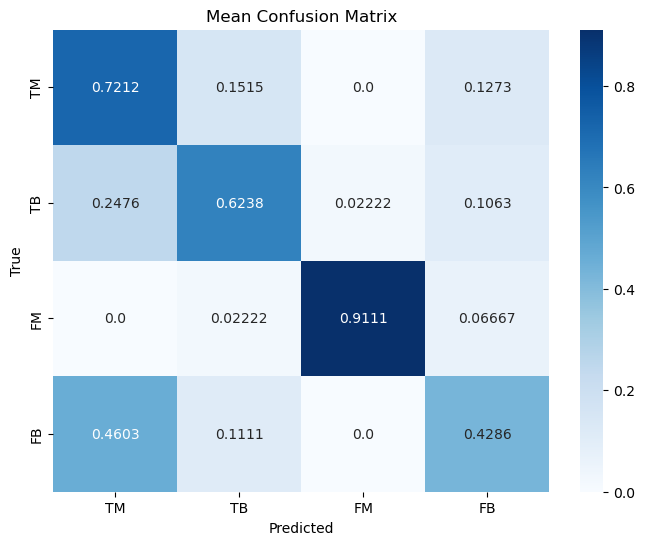

In [377]:
mean_conf_matrix = np.mean(confusion_matrices, axis=0)
normalized_mean_cm = normalize_confusion_matrix(mean_conf_matrix)
plt.figure(figsize=(8, 6))
sns.heatmap(normalized_mean_cm, annot=True, fmt=".4", cmap="Blues", xticklabels=label_mapping1.keys(), yticklabels=label_mapping1.keys())
plt.xlabel('Predicted')
plt.ylabel('True')
plt.title('Mean Confusion Matrix')
plt.show()

#### Hyperparameter tuning 

In [378]:
def build_vgg19_model_ct(hp):
    base_model = VGG19(weights="imagenet", include_top=False, input_shape=(224, 224, 3))

    for layer in base_model.layers:
        layer.trainable = False
    
    x = base_model.output
 
    units_1024 = hp.Int('units_1024', min_value=512, max_value=2048, step=512, default=1024)
    x = Dense(units_1024, activation='relu')(x)
    
    x = GlobalAveragePooling2D()(x)
    
    output = Dense(num_classes, activation="softmax", name="output")(x)
    
    model = Model(inputs=base_model.input, outputs=output)
 
    learning_rate = hp.Float('learning_rate', min_value=1e-5, max_value=1e-3, sampling='log', default=1e-4)
    optimizer = Adam(learning_rate=learning_rate)
    
    model.compile(optimizer=optimizer, loss='categorical_crossentropy', metrics=['accuracy'])
    
    return model


#### Random Search

In [379]:
tuner = RandomSearch(
    build_vgg19_model_ct,
    objective='val_accuracy',
    max_trials=20, 
    executions_per_trial=1,
    directory='my_dir',
    project_name='vgg19_tuning'
)

In [380]:
csv_file = 'hyperparameter_tuning_results.csv'

with open(csv_file, mode='w', newline='') as file:
    writer = csv.writer(file)
    writer.writerow(['Trial', 'Units 1024','Learning Rate', 'Validation Accuracy', 'Test Accuracy'])



In [381]:
def log_trial_results(trial, tuner, test_data, csv_file):
    hp = trial.hyperparameters.values
    val_accuracy = trial.metrics.get_best_value('val_accuracy')

    model = tuner.hypermodel.build(trial.hyperparameters)
    model.fit(train_generator, epochs=1, validation_data=validation_generator, verbose=0)  
    test_loss, test_accuracy = model.evaluate(test_data, verbose=0)
    
    try:
        with open(csv_file, mode='a', newline='') as file:
            writer = csv.writer(file)
            writer.writerow([trial.trial_id, hp['units_1024'], hp['learning_rate'], val_accuracy, test_accuracy])
        print(f"Logged trial {trial.trial_id}: val_accuracy={val_accuracy}, test_accuracy={test_accuracy}")  # Debug statement
    except Exception as e:
        print(f"Failed to write to CSV file: {e}")  # Debug statement for catching CSV writing errors

In [382]:
def custom_search(tuner, train_data, val_data, test_data, csv_file, epochs=10):
    class CustomCallback(Callback):
        def on_trial_end(self, trial, logs=None):
            log_trial_results(trial, tuner, test_data, csv_file)
    
    tuner.search(train_data, epochs=epochs, validation_data=val_data, callbacks=[CustomCallback()])


In [383]:
custom_search(tuner, train_generator, val_generator, test_generator, csv_file, epochs=50)

Trial 20 Complete [00h 00m 41s]
val_accuracy: 0.8888888955116272

Best val_accuracy So Far: 0.9629629850387573
Total elapsed time: 00h 13m 50s


In [384]:
best_hps = tuner.get_best_hyperparameters(num_trials=1)[0]

print(f" Dense 1024 is {best_hps.get('units_1024')} and the optimal learning rate is {best_hps.get('learning_rate')}")




 Dense 1024 is 1536 and the optimal learning rate is 0.0005155665082994384


In [385]:
best_model = build_vgg19_model_ct(best_hps)

In [386]:
best_model.fit(train_generator, epochs=50, validation_data=val_generator)

Epoch 1/50
64/64 ━━━━━━━━━━━━━━━━━━━━ 5s 41ms/step - accuracy: 0.2452 - loss: 1.5287 - val_accuracy: 0.4074 - val_loss: 1.3976
Epoch 2/50
64/64 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.5229 - loss: 1.2230 - val_accuracy: 0.4815 - val_loss: 1.0292
Epoch 3/50
64/64 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.5248 - loss: 0.9882 - val_accuracy: 0.4444 - val_loss: 1.0818
Epoch 4/50
64/64 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.4793 - loss: 1.0190 - val_accuracy: 0.7407 - val_loss: 0.8477
Epoch 5/50
64/64 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.6626 - loss: 0.8585 - val_accuracy: 0.5556 - val_loss: 0.8030
Epoch 6/50
64/64 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.5994 - loss: 0.8165 - val_accuracy: 0.7778 - val_loss: 0.7360
Epoch 7/50
64/64 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.6899 - loss: 0.7932 - val_accuracy: 0.7407 - val_loss: 0.7070
Epoch 8/50
64/64 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.7244 - loss: 0.7747 - val_accuracy: 0.7778 - val_los

In [387]:
test_loss, test_accuracy = best_model.evaluate(test_generator)

14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - accuracy: 0.9835 - loss: 0.1072


/home/ec2-user/anaconda3/lib/python3.11/site-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step


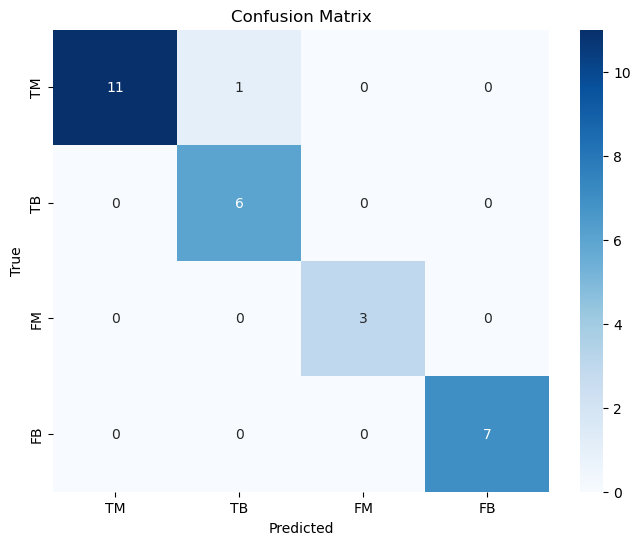

              precision    recall  f1-score   support

           0       1.00      0.92      0.96        12
           1       0.86      1.00      0.92         6
           2       1.00      1.00      1.00         3
           3       1.00      1.00      1.00         7

    accuracy                           0.96        28
   macro avg       0.96      0.98      0.97        28
weighted avg       0.97      0.96      0.96        28



In [388]:
y_true, y_pred, classes = evaluate_model(best_model, test_generator, label_mapping1)

#### GridSearch

---------------------------------

In [403]:
def build_inc_model_ct(hp):
    base_model = InceptionV3(weights="imagenet", include_top=False, input_shape=(224, 224, 3))

    for layer in base_model.layers:
        layer.trainable = False
    
    x = base_model.output
 
    units_1024 = hp.Int('units_1024', min_value=512, max_value=2048, step=512, default=1024)
    x = Dense(units_1024, activation='relu')(x)
    
    x = GlobalAveragePooling2D()(x)
    
    output = Dense(num_classes, activation="softmax", name="output")(x)
    
    model = Model(inputs=base_model.input, outputs=output)
 
    learning_rate = hp.Float('learning_rate', min_value=1e-5, max_value=1e-3, sampling='log', default=1e-4)
    optimizer = Adam(learning_rate=learning_rate)
    
    model.compile(optimizer=optimizer, loss='categorical_crossentropy', metrics=['accuracy'])
    
    return model


In [404]:
num_classes = 4



In [405]:
tuner_inc = RandomSearch(
    build_inc_model_ct,
    objective='val_accuracy',
    max_trials=20, 
    executions_per_trial=1,
    directory='my_dir',
    project_name='inception_tuning'
)

In [406]:
tuner_inc.search_space_summary()

Search space summary
Default search space size: 2
units_1024 (Int)
{'default': 1024, 'conditions': [], 'min_value': 512, 'max_value': 2048, 'step': 512, 'sampling': 'linear'}
learning_rate (Float)
{'default': 0.0001, 'conditions': [], 'min_value': 1e-05, 'max_value': 0.001, 'step': None, 'sampling': 'log'}


In [407]:
tuner_inc.search(train_generator, 
             epochs=50, 
             validation_data=val_generator)

Trial 20 Complete [00h 01m 11s]
val_accuracy: 0.7407407164573669

Best val_accuracy So Far: 0.7777777910232544
Total elapsed time: 00h 23m 50s


In [408]:
best_hps_inc = tuner_inc.get_best_hyperparameters(num_trials=1)[0]

print(f" Dense 1024 is {best_hps_inc.get('units_1024')} and the optimal learning rate is {best_hps_inc.get('learning_rate')}")


 Dense 1024 is 1024 and the optimal learning rate is 0.0006272419405684781


In [409]:
model_inc_best = build_inc_model_ct(best_hps_inc)
model_inc_best.fit(train_generator, epochs=50, validation_data=val_generator)

Epoch 1/50
64/64 ━━━━━━━━━━━━━━━━━━━━ 20s 133ms/step - accuracy: 0.4347 - loss: 2.3236 - val_accuracy: 0.6296 - val_loss: 0.8566
Epoch 2/50
64/64 ━━━━━━━━━━━━━━━━━━━━ 1s 13ms/step - accuracy: 0.7735 - loss: 0.5085 - val_accuracy: 0.7037 - val_loss: 0.9796
Epoch 3/50
64/64 ━━━━━━━━━━━━━━━━━━━━ 1s 13ms/step - accuracy: 0.7811 - loss: 0.3964 - val_accuracy: 0.5556 - val_loss: 0.8138
Epoch 4/50
64/64 ━━━━━━━━━━━━━━━━━━━━ 1s 13ms/step - accuracy: 0.9138 - loss: 0.1993 - val_accuracy: 0.7407 - val_loss: 0.8570
Epoch 5/50
64/64 ━━━━━━━━━━━━━━━━━━━━ 1s 13ms/step - accuracy: 0.9349 - loss: 0.1855 - val_accuracy: 0.7037 - val_loss: 1.1990
Epoch 6/50
64/64 ━━━━━━━━━━━━━━━━━━━━ 1s 13ms/step - accuracy: 0.9645 - loss: 0.1758 - val_accuracy: 0.7037 - val_loss: 1.2226
Epoch 7/50
64/64 ━━━━━━━━━━━━━━━━━━━━ 1s 13ms/step - accuracy: 0.9875 - loss: 0.0791 - val_accuracy: 0.6667 - val_loss: 1.4437
Epoch 8/50
64/64 ━━━━━━━━━━━━━━━━━━━━ 1s 13ms/step - accuracy: 0.9297 - loss: 0.1335 - val_accuracy: 0.7037 -

In [410]:
test_loss, test_accuracy = model_inc_best.evaluate(test_generator)

14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - accuracy: 0.7052 - loss: 1.0329


/home/ec2-user/anaconda3/lib/python3.11/site-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


1/1 ━━━━━━━━━━━━━━━━━━━━ 5s 5s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step


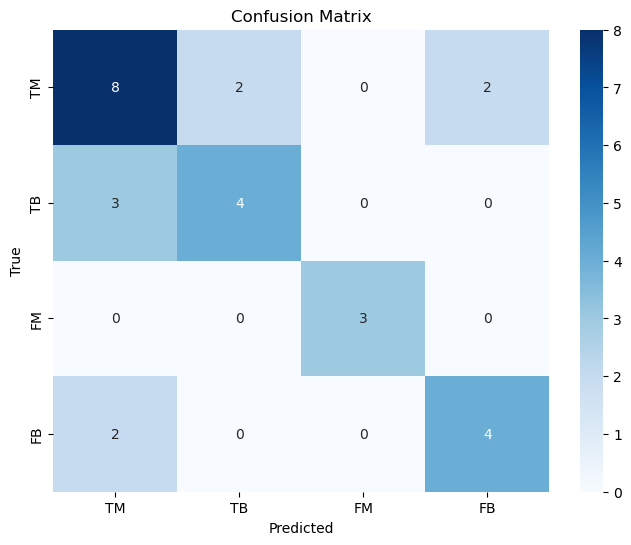

              precision    recall  f1-score   support

           0       0.62      0.67      0.64        12
           1       0.67      0.57      0.62         7
           2       1.00      1.00      1.00         3
           3       0.67      0.67      0.67         6

    accuracy                           0.68        28
   macro avg       0.74      0.73      0.73        28
weighted avg       0.68      0.68      0.68        28



In [411]:
y_true, y_pred, classes = evaluate_model(model_inc_best, test_generator, label_mapping1)